# TRAINING

In [1]:
# Sources
# https://github.com/jackfrost1411/MaskRCNN
# https://github.com/matterport/Mask_RCNN
# https://github.com/AarohiSingla/Mask-RCNN-on-Custom-Dataset-2classes-


#!pip install keras==2.2.5
#!pip install tensorflow==1.15.0

# tensorboard --logdir="./logs" --host=localhost

In [1]:
import os
import sys
import json
import datetime
import numpy as np
import skimage.draw
import cv2
from mrcnn.visualize import display_instances
import matplotlib.pyplot as plt

# Root directory of the project
ROOT_DIR = os.path.abspath("./")
DATA_DIR = os.path.abspath("./dataset/")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn.config import Config
from mrcnn import model as modellib, utils

# Path to trained weights file
COCO_WEIGHTS_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5")

# Directory to save logs and model checkpoints, if not provided
# through the command line argument --logs
DEFAULT_LOGS_DIR = os.path.join(ROOT_DIR, "logs")

Using TensorFlow backend.


In [2]:
class CustomConfig(Config):
    """Configuration for training on the toy  dataset.
    Derives from the base Config class and overrides some values.
    """
    # Give the configuration a recognizable name
    NAME = "object"

    # We use a GPU with 12GB memory, which can fit two images.
    # Adjust down if you use a smaller GPU.
    IMAGES_PER_GPU = 1

    # Number of classes (including background)
    NUM_CLASSES = 1 + 3  # Background + griffin + lion + serpent

    # Number of training steps per epoch
    STEPS_PER_EPOCH = 180 # train_size // batch_size ( = #gpu * images_per_gpu)
    
    VALIDATION_STEPS = 60

    # Skip detections with < 90% confidence
    DETECTION_MIN_CONFIDENCE = 0.8

In [3]:
class CustomDataset(utils.Dataset):

    def load_custom(self, dataset_dir, subset):
        """Load a subset of the Dog-Cat dataset.
        dataset_dir: Root directory of the dataset.
        subset: Subset to load: train or val
        """
        
        # set annotation type
        annotation_type = "bbox"
        
        self.add_class("object", 1, "griffin")
        self.add_class("object", 2, "serpent")
        self.add_class("object", 3, "lion")


        # Train or validation dataset?
        assert subset in ["train", "val"]
        dataset_dir = os.path.join(dataset_dir, subset)

        ################
        ### MODIFIED ###
        ################
        annotations1 = json.load(open(os.path.join(dataset_dir, "instances_default.json")))

        # Skip empty annotations
        annotations = [a for a in annotations1['annotations'] if a['segmentation']]

        name_dict = {"Griffin": 1, "Serpent": 2, "Lion": 3} 

        for a in annotations:
            if annotation_type == "polygon":
                polygons_all = a['segmentation'][0]
                polygons = {'name': 'polygon', 'x_points': polygons_all[0::2], 'y_points': polygons_all[1::2]}
                annotation_def = polygons
            else: # annotation_type == "bounding box"
                rectangle_all = a['bbox']
                # change [x, y, width, height] of bbox to four coordinates for bounding box
                rec_x = [rectangle_all[0], rectangle_all[0]+rectangle_all[2], rectangle_all[0]+rectangle_all[2], rectangle_all[0]]
                rec_y = [rectangle_all[1], rectangle_all[1], rectangle_all[1]+rectangle_all[3], rectangle_all[1]+rectangle_all[3]]
                rectangle = {'name': 'bbox', 'x_points': rec_x, 'y_points': rec_y }
                annotation_def = rectangle
            objects = [a['category_id']]

            for img in annotations1['images']:
                if a['image_id'] == img['id']:
                    height = img['height']
                    width = img['width']
                    path_name = os.path.join(dataset_dir, img['file_name'])
                    image_id = str(img['id'])
                    break

            self.add_image(
                "object",  # for a single class just add the name here
                image_id=image_id,
                path=path_name,
                width=width, height=height,
                annotation=[annotation_def],
                num_ids=objects
                )
            
        ################
        ################


    def load_mask(self, image_id):
        """Generate instance masks for an image.
       Returns:
        masks: A bool array of shape [height, width, instance count] with
            one mask per instance.
        class_ids: a 1D array of class IDs of the instance masks.
        """
        # If not a Dog-Cat dataset image, delegate to parent class.
        image_info = self.image_info[image_id]
        if image_info["source"] != "object":
            return super(self.__class__, self).load_mask(image_id)

        # Convert polygons to a bitmap mask of shape
        # [height, width, instance_count]
        info = self.image_info[image_id]
        if info["source"] != "object":
            return super(self.__class__, self).load_mask(image_id)
        num_ids = info['num_ids']
        mask = np.zeros([info["height"], info["width"], len(info["annotation"])],
                        dtype=np.uint8)

        for i, p in enumerate(info["annotation"]):
            # Get indexes of pixels inside the polygon and set them to 1
            # Bbox will also be drawn using draw.polygon (with four coordinates) as it makes no difference
            rr, cc = skimage.draw.polygon(p['y_points'], p['x_points'])
            mask[rr, cc, i] = 1


        # Return mask, and array of class IDs of each instance. Since we have
        # one class ID only, we return an array of 1s
        # Map class names to class IDs.
        num_ids = np.array(num_ids, dtype=np.int32)
        return mask, num_ids #np.ones([mask.shape[-1]], dtype=np.int32)

    def image_reference(self, image_id):
        """Return the path of the image."""
        info = self.image_info[image_id]
        if info["source"] == "object":
            return info["path"]
        else:
            super(self.__class__, self).image_reference(image_id)

In [4]:
def train(model):
    """Train the model."""
    # Training dataset.
    dataset_train = CustomDataset()
    dataset_train.load_custom(DATA_DIR, "train")
    dataset_train.prepare()

    # Validation dataset
    dataset_val = CustomDataset()
    dataset_val.load_custom(DATA_DIR, "val")
    dataset_val.prepare()

    # *** This training schedule is an example. Update to your needs ***
    # Since we're using a very small dataset, and starting from
    # COCO trained weights, we don't need to train too long. Also,
    # no need to train all layers, just the heads should do it.
    print("Training network heads")
    model.train(dataset_train, dataset_val,
                learning_rate=config.LEARNING_RATE,
                epochs=15,
                layers='heads')

In [6]:
config = CustomConfig()
model = modellib.MaskRCNN(mode="training", config=config,
                                  model_dir=DEFAULT_LOGS_DIR)







Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Instructions for updating:
box_ind is deprecated, use box_indices instead


In [7]:
weights_path = COCO_WEIGHTS_PATH

# Download weights file
if not os.path.exists(weights_path):
  utils.download_trained_weights(weights_path)

In [8]:
model.load_weights(weights_path, by_name=True, exclude=[
            "mrcnn_class_logits", "mrcnn_bbox_fc",
            "mrcnn_bbox", "mrcnn_mask"])

In [9]:
# if error occurs restart runtime
train(model)

Training network heads

Starting at epoch 0. LR=0.001

Checkpoint Path: D:\Documents\Uni\MSc\FP\CN-Object-Detection_local\logs\object20211009T1144\mask_rcnn_object_{epoch:04d}.h5
Selecting layers to train
fpn_c5p5               (Conv2D)
fpn_c4p4               (Conv2D)
fpn_c3p3               (Conv2D)
fpn_c2p2               (Conv2D)
fpn_p5                 (Conv2D)
fpn_p2                 (Conv2D)
fpn_p3                 (Conv2D)
fpn_p4                 (Conv2D)
In model:  rpn_model
    rpn_conv_shared        (Conv2D)
    rpn_class_raw          (Conv2D)
    rpn_bbox_pred          (Conv2D)
mrcnn_mask_conv1       (TimeDistributed)
mrcnn_mask_bn1         (TimeDistributed)
mrcnn_mask_conv2       (TimeDistributed)
mrcnn_mask_bn2         (TimeDistributed)
mrcnn_class_conv1      (TimeDistributed)
mrcnn_class_bn1        (TimeDistributed)
mrcnn_mask_conv3       (TimeDistributed)
mrcnn_mask_bn3         (TimeDistributed)
mrcnn_class_conv2      (TimeDistributed)
mrcnn_class_bn2        (TimeDistributed)


d:\programs\miniconda\envs\fp\lib\site-packages\tensorflow_core\python\framework\indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
d:\programs\miniconda\envs\fp\lib\site-packages\tensorflow_core\python\framework\indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "
d:\programs\miniconda\envs\fp\lib\site-packages\tensorflow_core\python\framework\indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "






Epoch 1/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:57:53 - loss: 5.6905 - rpn_class_loss: 0.0037 - rpn_bbox_loss: 0.4944 - mrcnn_class_loss: 2.8837 - mrcnn_bbox_loss: 1.5525 - mrcnn_mask_loss: 0.7562

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:45:25 - loss: 5.3722 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.6489 - mrcnn_class_loss: 2.4682 - mrcnn_bbox_loss: 1.0924 - mrcnn_mask_loss: 1.1536

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:38:53 - loss: 6.6843 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.5383 - mrcnn_class_loss: 2.0518 - mrcnn_bbox_loss: 1.2073 - mrcnn_mask_loss: 2.8792

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:37:03 - loss: 5.6467 - rpn_class_loss: 0.0314 - rpn_bbox_loss: 0.9626 - mrcnn_class_loss: 1.5879 - mrcnn_bbox_loss: 0.9055 - mrcnn_mask_loss: 2.1594

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:34:14 - loss: 5.1952 - rpn_class_loss: 0.0319 - rpn_bbox_loss: 0.9957 - mrcnn_class_loss: 1.2862 - mrcnn_bbox_loss: 0.9022 - mrcnn_mask_loss: 1.9792

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:33:48 - loss: 5.5106 - rpn_class_loss: 0.0590 - rpn_bbox_loss: 1.6937 - mrcnn_class_loss: 1.0873 - mrcnn_bbox_loss: 0.8483 - mrcnn_mask_loss: 1.8223

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:32:46 - loss: 5.4921 - rpn_class_loss: 0.0646 - rpn_bbox_loss: 2.0380 - mrcnn_class_loss: 0.9358 - mrcnn_bbox_loss: 0.7804 - mrcnn_mask_loss: 1.6731

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:31:31 - loss: 5.0544 - rpn_class_loss: 0.0568 - rpn_bbox_loss: 1.8091 - mrcnn_class_loss: 0.8385 - mrcnn_bbox_loss: 0.7973 - mrcnn_mask_loss: 1.5527

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:30:24 - loss: 5.2862 - rpn_class_loss: 0.0551 - rpn_bbox_loss: 1.7685 - mrcnn_class_loss: 0.7553 - mrcnn_bbox_loss: 0.9378 - mrcnn_mask_loss: 1.7696

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:29:25 - loss: 5.2193 - rpn_class_loss: 0.0500 - rpn_bbox_loss: 1.6465 - mrcnn_class_loss: 0.6929 - mrcnn_bbox_loss: 0.9651 - mrcnn_mask_loss: 1.8648

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:28:41 - loss: 4.9736 - rpn_class_loss: 0.0465 - rpn_bbox_loss: 1.5513 - mrcnn_class_loss: 0.6467 - mrcnn_bbox_loss: 0.9687 - mrcnn_mask_loss: 1.7605

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:28:12 - loss: 4.8810 - rpn_class_loss: 0.0432 - rpn_bbox_loss: 1.4460 - mrcnn_class_loss: 0.6079 - mrcnn_bbox_loss: 0.9505 - mrcnn_mask_loss: 1.8335

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:27:28 - loss: 4.6860 - rpn_class_loss: 0.0401 - rpn_bbox_loss: 1.3509 - mrcnn_class_loss: 0.5898 - mrcnn_bbox_loss: 0.9516 - mrcnn_mask_loss: 1.7536

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:26:50 - loss: 4.4927 - rpn_class_loss: 0.0382 - rpn_bbox_loss: 1.2672 - mrcnn_class_loss: 0.5572 - mrcnn_bbox_loss: 0.9452 - mrcnn_mask_loss: 1.6850

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:26:18 - loss: 4.3560 - rpn_class_loss: 0.0361 - rpn_bbox_loss: 1.2512 - mrcnn_class_loss: 0.5332 - mrcnn_bbox_loss: 0.9123 - mrcnn_mask_loss: 1.6232

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:25:51 - loss: 4.1924 - rpn_class_loss: 0.0341 - rpn_bbox_loss: 1.1858 - mrcnn_class_loss: 0.5055 - mrcnn_bbox_loss: 0.8935 - mrcnn_mask_loss: 1.5735

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:25:36 - loss: 4.0647 - rpn_class_loss: 0.0321 - rpn_bbox_loss: 1.1293 - mrcnn_class_loss: 0.4807 - mrcnn_bbox_loss: 0.8862 - mrcnn_mask_loss: 1.5364

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:25:06 - loss: 3.9369 - rpn_class_loss: 0.0308 - rpn_bbox_loss: 1.0988 - mrcnn_class_loss: 0.4581 - mrcnn_bbox_loss: 0.8639 - mrcnn_mask_loss: 1.4854

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:24:38 - loss: 3.8825 - rpn_class_loss: 0.0296 - rpn_bbox_loss: 1.0912 - mrcnn_class_loss: 0.4450 - mrcnn_bbox_loss: 0.8710 - mrcnn_mask_loss: 1.4457

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:24:13 - loss: 3.7700 - rpn_class_loss: 0.0291 - rpn_bbox_loss: 1.0629 - mrcnn_class_loss: 0.4276 - mrcnn_bbox_loss: 0.8461 - mrcnn_mask_loss: 1.4044

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:23:35 - loss: 3.7006 - rpn_class_loss: 0.0279 - rpn_bbox_loss: 1.0370 - mrcnn_class_loss: 0.4095 - mrcnn_bbox_loss: 0.8510 - mrcnn_mask_loss: 1.3751

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:22:56 - loss: 3.6604 - rpn_class_loss: 0.0278 - rpn_bbox_loss: 1.0391 - mrcnn_class_loss: 0.4020 - mrcnn_bbox_loss: 0.8440 - mrcnn_mask_loss: 1.3475

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:22:18 - loss: 3.5994 - rpn_class_loss: 0.0269 - rpn_bbox_loss: 1.0109 - mrcnn_class_loss: 0.3977 - mrcnn_bbox_loss: 0.8419 - mrcnn_mask_loss: 1.3220

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:21:41 - loss: 3.6029 - rpn_class_loss: 0.0267 - rpn_bbox_loss: 1.0324 - mrcnn_class_loss: 0.3831 - mrcnn_bbox_loss: 0.8655 - mrcnn_mask_loss: 1.2952

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:21:02 - loss: 3.5764 - rpn_class_loss: 0.0267 - rpn_bbox_loss: 1.0382 - mrcnn_class_loss: 0.3698 - mrcnn_bbox_loss: 0.8682 - mrcnn_mask_loss: 1.2735

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:20:26 - loss: 3.5140 - rpn_class_loss: 0.0257 - rpn_bbox_loss: 1.0004 - mrcnn_class_loss: 0.3619 - mrcnn_bbox_loss: 0.8682 - mrcnn_mask_loss: 1.2578

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:19:49 - loss: 3.5154 - rpn_class_loss: 0.0269 - rpn_bbox_loss: 1.0927 - mrcnn_class_loss: 0.3485 - mrcnn_bbox_loss: 0.8360 - mrcnn_mask_loss: 1.2112

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:19:18 - loss: 3.4641 - rpn_class_loss: 0.0262 - rpn_bbox_loss: 1.0645 - mrcnn_class_loss: 0.3484 - mrcnn_bbox_loss: 0.8296 - mrcnn_mask_loss: 1.1953

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:18:41 - loss: 3.4216 - rpn_class_loss: 0.0258 - rpn_bbox_loss: 1.0371 - mrcnn_class_loss: 0.3478 - mrcnn_bbox_loss: 0.8295 - mrcnn_mask_loss: 1.1813

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:18:06 - loss: 3.4547 - rpn_class_loss: 0.0263 - rpn_bbox_loss: 1.1484 - mrcnn_class_loss: 0.3362 - mrcnn_bbox_loss: 0.8019 - mrcnn_mask_loss: 1.1419

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:17:32 - loss: 3.4015 - rpn_class_loss: 0.0255 - rpn_bbox_loss: 1.1151 - mrcnn_class_loss: 0.3274 - mrcnn_bbox_loss: 0.8071 - mrcnn_mask_loss: 1.1264

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:16:58 - loss: 3.3501 - rpn_class_loss: 0.0247 - rpn_bbox_loss: 1.0829 - mrcnn_class_loss: 0.3201 - mrcnn_bbox_loss: 0.8124 - mrcnn_mask_loss: 1.1100

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:16:22 - loss: 3.3125 - rpn_class_loss: 0.0245 - rpn_bbox_loss: 1.0699 - mrcnn_class_loss: 0.3171 - mrcnn_bbox_loss: 0.8070 - mrcnn_mask_loss: 1.0941

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:15:48 - loss: 3.2784 - rpn_class_loss: 0.0238 - rpn_bbox_loss: 1.0443 - mrcnn_class_loss: 0.3110 - mrcnn_bbox_loss: 0.8166 - mrcnn_mask_loss: 1.0826

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:15:14 - loss: 3.2751 - rpn_class_loss: 0.0242 - rpn_bbox_loss: 1.0331 - mrcnn_class_loss: 0.3073 - mrcnn_bbox_loss: 0.8378 - mrcnn_mask_loss: 1.0727

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:14:38 - loss: 3.2490 - rpn_class_loss: 0.0238 - rpn_bbox_loss: 1.0226 - mrcnn_class_loss: 0.3018 - mrcnn_bbox_loss: 0.8393 - mrcnn_mask_loss: 1.0615

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:14:05 - loss: 3.2230 - rpn_class_loss: 0.0240 - rpn_bbox_loss: 1.0045 - mrcnn_class_loss: 0.2992 - mrcnn_bbox_loss: 0.8421 - mrcnn_mask_loss: 1.0531

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:13:36 - loss: 3.1891 - rpn_class_loss: 0.0235 - rpn_bbox_loss: 0.9843 - mrcnn_class_loss: 0.2971 - mrcnn_bbox_loss: 0.8403 - mrcnn_mask_loss: 1.0439

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:13:01 - loss: 3.1573 - rpn_class_loss: 0.0230 - rpn_bbox_loss: 0.9660 - mrcnn_class_loss: 0.2947 - mrcnn_bbox_loss: 0.8389 - mrcnn_mask_loss: 1.0346

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:12:29 - loss: 3.1395 - rpn_class_loss: 0.0228 - rpn_bbox_loss: 0.9477 - mrcnn_class_loss: 0.2901 - mrcnn_bbox_loss: 0.8520 - mrcnn_mask_loss: 1.0269

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:11:56 - loss: 3.1038 - rpn_class_loss: 0.0223 - rpn_bbox_loss: 0.9339 - mrcnn_class_loss: 0.2857 - mrcnn_bbox_loss: 0.8417 - mrcnn_mask_loss: 1.0202

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:11:22 - loss: 3.0762 - rpn_class_loss: 0.0218 - rpn_bbox_loss: 0.9222 - mrcnn_class_loss: 0.2814 - mrcnn_bbox_loss: 0.8399 - mrcnn_mask_loss: 1.0109

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:10:46 - loss: 3.2421 - rpn_class_loss: 0.0245 - rpn_bbox_loss: 1.1350 - mrcnn_class_loss: 0.2748 - mrcnn_bbox_loss: 0.8204 - mrcnn_mask_loss: 0.9874

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:10:14 - loss: 3.2125 - rpn_class_loss: 0.0239 - rpn_bbox_loss: 1.1147 - mrcnn_class_loss: 0.2729 - mrcnn_bbox_loss: 0.8197 - mrcnn_mask_loss: 0.9813

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:09:41 - loss: 3.1758 - rpn_class_loss: 0.0234 - rpn_bbox_loss: 1.1007 - mrcnn_class_loss: 0.2694 - mrcnn_bbox_loss: 0.8076 - mrcnn_mask_loss: 0.9747

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:09:08 - loss: 3.1578 - rpn_class_loss: 0.0258 - rpn_bbox_loss: 1.1248 - mrcnn_class_loss: 0.2635 - mrcnn_bbox_loss: 0.7901 - mrcnn_mask_loss: 0.9535

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:08:34 - loss: 3.1285 - rpn_class_loss: 0.0253 - rpn_bbox_loss: 1.1021 - mrcnn_class_loss: 0.2635 - mrcnn_bbox_loss: 0.7889 - mrcnn_mask_loss: 0.9486

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:08:00 - loss: 3.1016 - rpn_class_loss: 0.0250 - rpn_bbox_loss: 1.0845 - mrcnn_class_loss: 0.2617 - mrcnn_bbox_loss: 0.7876 - mrcnn_mask_loss: 0.9428

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:07:27 - loss: 3.0994 - rpn_class_loss: 0.0255 - rpn_bbox_loss: 1.0937 - mrcnn_class_loss: 0.2585 - mrcnn_bbox_loss: 0.7832 - mrcnn_mask_loss: 0.9385

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:06:53 - loss: 3.1107 - rpn_class_loss: 0.0250 - rpn_bbox_loss: 1.1008 - mrcnn_class_loss: 0.2565 - mrcnn_bbox_loss: 0.7948 - mrcnn_mask_loss: 0.9337

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:06:21 - loss: 3.1112 - rpn_class_loss: 0.0246 - rpn_bbox_loss: 1.0874 - mrcnn_class_loss: 0.2542 - mrcnn_bbox_loss: 0.8159 - mrcnn_mask_loss: 0.9291

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:05:49 - loss: 3.1055 - rpn_class_loss: 0.0241 - rpn_bbox_loss: 1.0739 - mrcnn_class_loss: 0.2516 - mrcnn_bbox_loss: 0.8316 - mrcnn_mask_loss: 0.9243

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:05:17 - loss: 3.0941 - rpn_class_loss: 0.0239 - rpn_bbox_loss: 1.0611 - mrcnn_class_loss: 0.2537 - mrcnn_bbox_loss: 0.8355 - mrcnn_mask_loss: 0.9200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:04:44 - loss: 3.0692 - rpn_class_loss: 0.0235 - rpn_bbox_loss: 1.0448 - mrcnn_class_loss: 0.2536 - mrcnn_bbox_loss: 0.8321 - mrcnn_mask_loss: 0.9152

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:04:09 - loss: 3.0393 - rpn_class_loss: 0.0232 - rpn_bbox_loss: 1.0277 - mrcnn_class_loss: 0.2508 - mrcnn_bbox_loss: 0.8268 - mrcnn_mask_loss: 0.9109

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:03:40 - loss: 3.0249 - rpn_class_loss: 0.0228 - rpn_bbox_loss: 1.0163 - mrcnn_class_loss: 0.2486 - mrcnn_bbox_loss: 0.8301 - mrcnn_mask_loss: 0.9071

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:03:05 - loss: 3.0105 - rpn_class_loss: 0.0224 - rpn_bbox_loss: 1.0018 - mrcnn_class_loss: 0.2472 - mrcnn_bbox_loss: 0.8357 - mrcnn_mask_loss: 0.9035

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:02:33 - loss: 2.9905 - rpn_class_loss: 0.0220 - rpn_bbox_loss: 0.9902 - mrcnn_class_loss: 0.2455 - mrcnn_bbox_loss: 0.8329 - mrcnn_mask_loss: 0.8999

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 1:02:00 - loss: 2.9673 - rpn_class_loss: 0.0217 - rpn_bbox_loss: 0.9808 - mrcnn_class_loss: 0.2450 - mrcnn_bbox_loss: 0.8249 - mrcnn_mask_loss: 0.8948

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 1:01:29 - loss: 2.9503 - rpn_class_loss: 0.0214 - rpn_bbox_loss: 0.9726 - mrcnn_class_loss: 0.2449 - mrcnn_bbox_loss: 0.8200 - mrcnn_mask_loss: 0.8914

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 1:00:58 - loss: 2.9253 - rpn_class_loss: 0.0210 - rpn_bbox_loss: 0.9576 - mrcnn_class_loss: 0.2458 - mrcnn_bbox_loss: 0.8127 - mrcnn_mask_loss: 0.8882

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 1:00:27 - loss: 2.9007 - rpn_class_loss: 0.0207 - rpn_bbox_loss: 0.9446 - mrcnn_class_loss: 0.2440 - mrcnn_bbox_loss: 0.8067 - mrcnn_mask_loss: 0.8847

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 59:56 - loss: 2.8788 - rpn_class_loss: 0.0204 - rpn_bbox_loss: 0.9319 - mrcnn_class_loss: 0.2426 - mrcnn_bbox_loss: 0.8027 - mrcnn_mask_loss: 0.8811  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 59:22 - loss: 2.8751 - rpn_class_loss: 0.0204 - rpn_bbox_loss: 0.9321 - mrcnn_class_loss: 0.2406 - mrcnn_bbox_loss: 0.8040 - mrcnn_mask_loss: 0.8781

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 58:51 - loss: 2.8716 - rpn_class_loss: 0.0204 - rpn_bbox_loss: 0.9303 - mrcnn_class_loss: 0.2384 - mrcnn_bbox_loss: 0.8072 - mrcnn_mask_loss: 0.8753

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 58:18 - loss: 2.8648 - rpn_class_loss: 0.0201 - rpn_bbox_loss: 0.9275 - mrcnn_class_loss: 0.2375 - mrcnn_bbox_loss: 0.8068 - mrcnn_mask_loss: 0.8729

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 57:46 - loss: 2.8489 - rpn_class_loss: 0.0198 - rpn_bbox_loss: 0.9192 - mrcnn_class_loss: 0.2354 - mrcnn_bbox_loss: 0.8054 - mrcnn_mask_loss: 0.8691

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 57:15 - loss: 2.8388 - rpn_class_loss: 0.0197 - rpn_bbox_loss: 0.9180 - mrcnn_class_loss: 0.2336 - mrcnn_bbox_loss: 0.8013 - mrcnn_mask_loss: 0.8663

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 56:42 - loss: 2.8239 - rpn_class_loss: 0.0195 - rpn_bbox_loss: 0.9108 - mrcnn_class_loss: 0.2314 - mrcnn_bbox_loss: 0.7984 - mrcnn_mask_loss: 0.8638

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 56:12 - loss: 2.8025 - rpn_class_loss: 0.0193 - rpn_bbox_loss: 0.8999 - mrcnn_class_loss: 0.2309 - mrcnn_bbox_loss: 0.7924 - mrcnn_mask_loss: 0.8600

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 55:41 - loss: 2.7793 - rpn_class_loss: 0.0191 - rpn_bbox_loss: 0.8896 - mrcnn_class_loss: 0.2294 - mrcnn_bbox_loss: 0.7852 - mrcnn_mask_loss: 0.8561

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 55:10 - loss: 2.7652 - rpn_class_loss: 0.0194 - rpn_bbox_loss: 0.8876 - mrcnn_class_loss: 0.2270 - mrcnn_bbox_loss: 0.7792 - mrcnn_mask_loss: 0.8519

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 54:37 - loss: 2.7459 - rpn_class_loss: 0.0191 - rpn_bbox_loss: 0.8824 - mrcnn_class_loss: 0.2251 - mrcnn_bbox_loss: 0.7722 - mrcnn_mask_loss: 0.8471

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 54:08 - loss: 2.7323 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8744 - mrcnn_class_loss: 0.2232 - mrcnn_bbox_loss: 0.7708 - mrcnn_mask_loss: 0.8450

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 53:37 - loss: 2.7133 - rpn_class_loss: 0.0200 - rpn_bbox_loss: 0.8788 - mrcnn_class_loss: 0.2202 - mrcnn_bbox_loss: 0.7605 - mrcnn_mask_loss: 0.8337

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 53:07 - loss: 2.7047 - rpn_class_loss: 0.0198 - rpn_bbox_loss: 0.8706 - mrcnn_class_loss: 0.2182 - mrcnn_bbox_loss: 0.7655 - mrcnn_mask_loss: 0.8306

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 52:36 - loss: 2.6956 - rpn_class_loss: 0.0198 - rpn_bbox_loss: 0.8669 - mrcnn_class_loss: 0.2158 - mrcnn_bbox_loss: 0.7646 - mrcnn_mask_loss: 0.8285

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 52:06 - loss: 2.6754 - rpn_class_loss: 0.0196 - rpn_bbox_loss: 0.8571 - mrcnn_class_loss: 0.2150 - mrcnn_bbox_loss: 0.7590 - mrcnn_mask_loss: 0.8248

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 51:35 - loss: 2.6559 - rpn_class_loss: 0.0194 - rpn_bbox_loss: 0.8487 - mrcnn_class_loss: 0.2133 - mrcnn_bbox_loss: 0.7536 - mrcnn_mask_loss: 0.8209

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 51:05 - loss: 2.6494 - rpn_class_loss: 0.0194 - rpn_bbox_loss: 0.8467 - mrcnn_class_loss: 0.2117 - mrcnn_bbox_loss: 0.7523 - mrcnn_mask_loss: 0.8193

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 50:34 - loss: 2.6314 - rpn_class_loss: 0.0191 - rpn_bbox_loss: 0.8377 - mrcnn_class_loss: 0.2100 - mrcnn_bbox_loss: 0.7499 - mrcnn_mask_loss: 0.8147

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 50:04 - loss: 2.6115 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8295 - mrcnn_class_loss: 0.2087 - mrcnn_bbox_loss: 0.7445 - mrcnn_mask_loss: 0.8099

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 49:33 - loss: 2.5958 - rpn_class_loss: 0.0188 - rpn_bbox_loss: 0.8204 - mrcnn_class_loss: 0.2099 - mrcnn_bbox_loss: 0.7409 - mrcnn_mask_loss: 0.8059

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 49:02 - loss: 2.5783 - rpn_class_loss: 0.0186 - rpn_bbox_loss: 0.8136 - mrcnn_class_loss: 0.2091 - mrcnn_bbox_loss: 0.7352 - mrcnn_mask_loss: 0.8017

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 48:31 - loss: 2.5568 - rpn_class_loss: 0.0184 - rpn_bbox_loss: 0.8048 - mrcnn_class_loss: 0.2080 - mrcnn_bbox_loss: 0.7283 - mrcnn_mask_loss: 0.7973

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 48:01 - loss: 2.5420 - rpn_class_loss: 0.0182 - rpn_bbox_loss: 0.8001 - mrcnn_class_loss: 0.2073 - mrcnn_bbox_loss: 0.7235 - mrcnn_mask_loss: 0.7928

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 47:29 - loss: 2.5477 - rpn_class_loss: 0.0182 - rpn_bbox_loss: 0.7946 - mrcnn_class_loss: 0.2105 - mrcnn_bbox_loss: 0.7327 - mrcnn_mask_loss: 0.7918

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 46:58 - loss: 2.5293 - rpn_class_loss: 0.0180 - rpn_bbox_loss: 0.7873 - mrcnn_class_loss: 0.2094 - mrcnn_bbox_loss: 0.7271 - mrcnn_mask_loss: 0.7875

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 46:27 - loss: 2.5127 - rpn_class_loss: 0.0178 - rpn_bbox_loss: 0.7810 - mrcnn_class_loss: 0.2080 - mrcnn_bbox_loss: 0.7223 - mrcnn_mask_loss: 0.7837

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 45:56 - loss: 2.5119 - rpn_class_loss: 0.0177 - rpn_bbox_loss: 0.7790 - mrcnn_class_loss: 0.2070 - mrcnn_bbox_loss: 0.7259 - mrcnn_mask_loss: 0.7823

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 45:26 - loss: 2.5088 - rpn_class_loss: 0.0177 - rpn_bbox_loss: 0.7779 - mrcnn_class_loss: 0.2061 - mrcnn_bbox_loss: 0.7278 - mrcnn_mask_loss: 0.7793

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 44:57 - loss: 2.4979 - rpn_class_loss: 0.0175 - rpn_bbox_loss: 0.7738 - mrcnn_class_loss: 0.2050 - mrcnn_bbox_loss: 0.7257 - mrcnn_mask_loss: 0.7758

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 44:27 - loss: 2.4803 - rpn_class_loss: 0.0174 - rpn_bbox_loss: 0.7665 - mrcnn_class_loss: 0.2042 - mrcnn_bbox_loss: 0.7209 - mrcnn_mask_loss: 0.7714

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 43:55 - loss: 2.4721 - rpn_class_loss: 0.0174 - rpn_bbox_loss: 0.7627 - mrcnn_class_loss: 0.2027 - mrcnn_bbox_loss: 0.7190 - mrcnn_mask_loss: 0.7704

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 43:24 - loss: 2.4623 - rpn_class_loss: 0.0173 - rpn_bbox_loss: 0.7589 - mrcnn_class_loss: 0.2014 - mrcnn_bbox_loss: 0.7175 - mrcnn_mask_loss: 0.7672

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 42:53 - loss: 2.4517 - rpn_class_loss: 0.0172 - rpn_bbox_loss: 0.7564 - mrcnn_class_loss: 0.2006 - mrcnn_bbox_loss: 0.7145 - mrcnn_mask_loss: 0.7631

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 42:22 - loss: 2.4532 - rpn_class_loss: 0.0172 - rpn_bbox_loss: 0.7590 - mrcnn_class_loss: 0.2012 - mrcnn_bbox_loss: 0.7142 - mrcnn_mask_loss: 0.7615

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 41:51 - loss: 2.4405 - rpn_class_loss: 0.0171 - rpn_bbox_loss: 0.7533 - mrcnn_class_loss: 0.2000 - mrcnn_bbox_loss: 0.7132 - mrcnn_mask_loss: 0.7569

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 41:20 - loss: 2.4290 - rpn_class_loss: 0.0169 - rpn_bbox_loss: 0.7479 - mrcnn_class_loss: 0.2002 - mrcnn_bbox_loss: 0.7116 - mrcnn_mask_loss: 0.7525

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 40:50 - loss: 2.4196 - rpn_class_loss: 0.0168 - rpn_bbox_loss: 0.7449 - mrcnn_class_loss: 0.1986 - mrcnn_bbox_loss: 0.7116 - mrcnn_mask_loss: 0.7477

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 40:19 - loss: 2.4043 - rpn_class_loss: 0.0166 - rpn_bbox_loss: 0.7390 - mrcnn_class_loss: 0.1973 - mrcnn_bbox_loss: 0.7080 - mrcnn_mask_loss: 0.7434

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 39:47 - loss: 2.3904 - rpn_class_loss: 0.0166 - rpn_bbox_loss: 0.7332 - mrcnn_class_loss: 0.1960 - mrcnn_bbox_loss: 0.7037 - mrcnn_mask_loss: 0.7408

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 39:17 - loss: 2.3855 - rpn_class_loss: 0.0168 - rpn_bbox_loss: 0.7300 - mrcnn_class_loss: 0.1955 - mrcnn_bbox_loss: 0.7032 - mrcnn_mask_loss: 0.7399

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 38:46 - loss: 2.3830 - rpn_class_loss: 0.0167 - rpn_bbox_loss: 0.7258 - mrcnn_class_loss: 0.1958 - mrcnn_bbox_loss: 0.7058 - mrcnn_mask_loss: 0.7389

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 38:14 - loss: 2.3715 - rpn_class_loss: 0.0166 - rpn_bbox_loss: 0.7215 - mrcnn_class_loss: 0.1944 - mrcnn_bbox_loss: 0.7035 - mrcnn_mask_loss: 0.7355

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 37:43 - loss: 2.3660 - rpn_class_loss: 0.0167 - rpn_bbox_loss: 0.7179 - mrcnn_class_loss: 0.1945 - mrcnn_bbox_loss: 0.7029 - mrcnn_mask_loss: 0.7341

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 37:12 - loss: 2.3703 - rpn_class_loss: 0.0171 - rpn_bbox_loss: 0.7211 - mrcnn_class_loss: 0.1960 - mrcnn_bbox_loss: 0.7028 - mrcnn_mask_loss: 0.7334

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 36:41 - loss: 2.3792 - rpn_class_loss: 0.0170 - rpn_bbox_loss: 0.7209 - mrcnn_class_loss: 0.1969 - mrcnn_bbox_loss: 0.7116 - mrcnn_mask_loss: 0.7329

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 36:10 - loss: 2.3775 - rpn_class_loss: 0.0169 - rpn_bbox_loss: 0.7188 - mrcnn_class_loss: 0.1958 - mrcnn_bbox_loss: 0.7151 - mrcnn_mask_loss: 0.7308

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 35:40 - loss: 2.3714 - rpn_class_loss: 0.0168 - rpn_bbox_loss: 0.7150 - mrcnn_class_loss: 0.1950 - mrcnn_bbox_loss: 0.7174 - mrcnn_mask_loss: 0.7272

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 35:09 - loss: 2.4330 - rpn_class_loss: 0.0169 - rpn_bbox_loss: 0.7826 - mrcnn_class_loss: 0.1933 - mrcnn_bbox_loss: 0.7138 - mrcnn_mask_loss: 0.7264

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 34:38 - loss: 2.4844 - rpn_class_loss: 0.0180 - rpn_bbox_loss: 0.8256 - mrcnn_class_loss: 0.1917 - mrcnn_bbox_loss: 0.7236 - mrcnn_mask_loss: 0.7255

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 34:07 - loss: 2.4761 - rpn_class_loss: 0.0178 - rpn_bbox_loss: 0.8211 - mrcnn_class_loss: 0.1909 - mrcnn_bbox_loss: 0.7245 - mrcnn_mask_loss: 0.7219

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 33:36 - loss: 2.4739 - rpn_class_loss: 0.0177 - rpn_bbox_loss: 0.8211 - mrcnn_class_loss: 0.1912 - mrcnn_bbox_loss: 0.7237 - mrcnn_mask_loss: 0.7202

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 33:06 - loss: 2.4678 - rpn_class_loss: 0.0177 - rpn_bbox_loss: 0.8159 - mrcnn_class_loss: 0.1903 - mrcnn_bbox_loss: 0.7254 - mrcnn_mask_loss: 0.7185

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 32:35 - loss: 2.4606 - rpn_class_loss: 0.0176 - rpn_bbox_loss: 0.8118 - mrcnn_class_loss: 0.1909 - mrcnn_bbox_loss: 0.7240 - mrcnn_mask_loss: 0.7163

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 32:04 - loss: 2.4522 - rpn_class_loss: 0.0175 - rpn_bbox_loss: 0.8055 - mrcnn_class_loss: 0.1909 - mrcnn_bbox_loss: 0.7240 - mrcnn_mask_loss: 0.7143

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 31:33 - loss: 2.4477 - rpn_class_loss: 0.0174 - rpn_bbox_loss: 0.8042 - mrcnn_class_loss: 0.1894 - mrcnn_bbox_loss: 0.7225 - mrcnn_mask_loss: 0.7141

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 31:02 - loss: 2.4738 - rpn_class_loss: 0.0183 - rpn_bbox_loss: 0.8431 - mrcnn_class_loss: 0.1878 - mrcnn_bbox_loss: 0.7165 - mrcnn_mask_loss: 0.7081

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 30:32 - loss: 2.5260 - rpn_class_loss: 0.0190 - rpn_bbox_loss: 0.9081 - mrcnn_class_loss: 0.1862 - mrcnn_bbox_loss: 0.7105 - mrcnn_mask_loss: 0.7022

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 30:01 - loss: 2.5227 - rpn_class_loss: 0.0193 - rpn_bbox_loss: 0.9054 - mrcnn_class_loss: 0.1858 - mrcnn_bbox_loss: 0.7103 - mrcnn_mask_loss: 0.7019

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 29:30 - loss: 2.5114 - rpn_class_loss: 0.0192 - rpn_bbox_loss: 0.8982 - mrcnn_class_loss: 0.1858 - mrcnn_bbox_loss: 0.7084 - mrcnn_mask_loss: 0.6998

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 29:00 - loss: 2.5140 - rpn_class_loss: 0.0191 - rpn_bbox_loss: 0.8985 - mrcnn_class_loss: 0.1860 - mrcnn_bbox_loss: 0.7119 - mrcnn_mask_loss: 0.6986

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 28:29 - loss: 2.5046 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8933 - mrcnn_class_loss: 0.1852 - mrcnn_bbox_loss: 0.7104 - mrcnn_mask_loss: 0.6968

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 27:58 - loss: 2.4960 - rpn_class_loss: 0.0188 - rpn_bbox_loss: 0.8871 - mrcnn_class_loss: 0.1863 - mrcnn_bbox_loss: 0.7101 - mrcnn_mask_loss: 0.6937

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 27:27 - loss: 2.4922 - rpn_class_loss: 0.0186 - rpn_bbox_loss: 0.8816 - mrcnn_class_loss: 0.1880 - mrcnn_bbox_loss: 0.7122 - mrcnn_mask_loss: 0.6917

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 26:57 - loss: 2.4829 - rpn_class_loss: 0.0185 - rpn_bbox_loss: 0.8765 - mrcnn_class_loss: 0.1880 - mrcnn_bbox_loss: 0.7114 - mrcnn_mask_loss: 0.6885

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 26:26 - loss: 2.4777 - rpn_class_loss: 0.0185 - rpn_bbox_loss: 0.8729 - mrcnn_class_loss: 0.1880 - mrcnn_bbox_loss: 0.7106 - mrcnn_mask_loss: 0.6876

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 25:56 - loss: 2.4682 - rpn_class_loss: 0.0183 - rpn_bbox_loss: 0.8689 - mrcnn_class_loss: 0.1878 - mrcnn_bbox_loss: 0.7083 - mrcnn_mask_loss: 0.6848

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 25:25 - loss: 2.4613 - rpn_class_loss: 0.0182 - rpn_bbox_loss: 0.8642 - mrcnn_class_loss: 0.1872 - mrcnn_bbox_loss: 0.7076 - mrcnn_mask_loss: 0.6840

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 24:54 - loss: 2.4612 - rpn_class_loss: 0.0191 - rpn_bbox_loss: 0.8754 - mrcnn_class_loss: 0.1858 - mrcnn_bbox_loss: 0.7021 - mrcnn_mask_loss: 0.6788

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 24:24 - loss: 2.4560 - rpn_class_loss: 0.0190 - rpn_bbox_loss: 0.8721 - mrcnn_class_loss: 0.1862 - mrcnn_bbox_loss: 0.7016 - mrcnn_mask_loss: 0.6772

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 23:53 - loss: 2.4464 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8670 - mrcnn_class_loss: 0.1862 - mrcnn_bbox_loss: 0.6999 - mrcnn_mask_loss: 0.6744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 23:22 - loss: 2.4420 - rpn_class_loss: 0.0188 - rpn_bbox_loss: 0.8650 - mrcnn_class_loss: 0.1852 - mrcnn_bbox_loss: 0.6989 - mrcnn_mask_loss: 0.6741

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 22:51 - loss: 2.4372 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8608 - mrcnn_class_loss: 0.1850 - mrcnn_bbox_loss: 0.6985 - mrcnn_mask_loss: 0.6740

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 22:21 - loss: 2.4300 - rpn_class_loss: 0.0190 - rpn_bbox_loss: 0.8562 - mrcnn_class_loss: 0.1844 - mrcnn_bbox_loss: 0.6961 - mrcnn_mask_loss: 0.6743

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 21:50 - loss: 2.4225 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8542 - mrcnn_class_loss: 0.1839 - mrcnn_bbox_loss: 0.6940 - mrcnn_mask_loss: 0.6716

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 21:20 - loss: 2.4193 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8563 - mrcnn_class_loss: 0.1834 - mrcnn_bbox_loss: 0.6919 - mrcnn_mask_loss: 0.6687

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 20:49 - loss: 2.4130 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8523 - mrcnn_class_loss: 0.1838 - mrcnn_bbox_loss: 0.6912 - mrcnn_mask_loss: 0.6669

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 20:19 - loss: 2.4040 - rpn_class_loss: 0.0188 - rpn_bbox_loss: 0.8475 - mrcnn_class_loss: 0.1836 - mrcnn_bbox_loss: 0.6891 - mrcnn_mask_loss: 0.6651

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 19:48 - loss: 2.3952 - rpn_class_loss: 0.0187 - rpn_bbox_loss: 0.8427 - mrcnn_class_loss: 0.1828 - mrcnn_bbox_loss: 0.6876 - mrcnn_mask_loss: 0.6635

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 19:17 - loss: 2.3922 - rpn_class_loss: 0.0190 - rpn_bbox_loss: 0.8378 - mrcnn_class_loss: 0.1842 - mrcnn_bbox_loss: 0.6878 - mrcnn_mask_loss: 0.6635

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 18:47 - loss: 2.3862 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8347 - mrcnn_class_loss: 0.1843 - mrcnn_bbox_loss: 0.6863 - mrcnn_mask_loss: 0.6621

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 18:16 - loss: 2.3750 - rpn_class_loss: 0.0187 - rpn_bbox_loss: 0.8292 - mrcnn_class_loss: 0.1838 - mrcnn_bbox_loss: 0.6837 - mrcnn_mask_loss: 0.6595

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 17:46 - loss: 2.3664 - rpn_class_loss: 0.0187 - rpn_bbox_loss: 0.8258 - mrcnn_class_loss: 0.1837 - mrcnn_bbox_loss: 0.6814 - mrcnn_mask_loss: 0.6569

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 17:16 - loss: 2.3621 - rpn_class_loss: 0.0186 - rpn_bbox_loss: 0.8229 - mrcnn_class_loss: 0.1835 - mrcnn_bbox_loss: 0.6806 - mrcnn_mask_loss: 0.6565

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 16:45 - loss: 2.3526 - rpn_class_loss: 0.0185 - rpn_bbox_loss: 0.8195 - mrcnn_class_loss: 0.1831 - mrcnn_bbox_loss: 0.6775 - mrcnn_mask_loss: 0.6540

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 16:15 - loss: 2.3464 - rpn_class_loss: 0.0184 - rpn_bbox_loss: 0.8158 - mrcnn_class_loss: 0.1824 - mrcnn_bbox_loss: 0.6764 - mrcnn_mask_loss: 0.6533

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 15:45 - loss: 2.3476 - rpn_class_loss: 0.0184 - rpn_bbox_loss: 0.8174 - mrcnn_class_loss: 0.1814 - mrcnn_bbox_loss: 0.6775 - mrcnn_mask_loss: 0.6529

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 15:14 - loss: 2.3484 - rpn_class_loss: 0.0185 - rpn_bbox_loss: 0.8142 - mrcnn_class_loss: 0.1819 - mrcnn_bbox_loss: 0.6819 - mrcnn_mask_loss: 0.6520

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 14:44 - loss: 2.3417 - rpn_class_loss: 0.0185 - rpn_bbox_loss: 0.8103 - mrcnn_class_loss: 0.1810 - mrcnn_bbox_loss: 0.6813 - mrcnn_mask_loss: 0.6506

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 14:13 - loss: 2.3340 - rpn_class_loss: 0.0185 - rpn_bbox_loss: 0.8062 - mrcnn_class_loss: 0.1809 - mrcnn_bbox_loss: 0.6788 - mrcnn_mask_loss: 0.6496

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 13:43 - loss: 2.3263 - rpn_class_loss: 0.0184 - rpn_bbox_loss: 0.8049 - mrcnn_class_loss: 0.1805 - mrcnn_bbox_loss: 0.6756 - mrcnn_mask_loss: 0.6469

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 13:12 - loss: 2.3159 - rpn_class_loss: 0.0183 - rpn_bbox_loss: 0.8005 - mrcnn_class_loss: 0.1797 - mrcnn_bbox_loss: 0.6727 - mrcnn_mask_loss: 0.6447

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 12:42 - loss: 2.3062 - rpn_class_loss: 0.0183 - rpn_bbox_loss: 0.7961 - mrcnn_class_loss: 0.1790 - mrcnn_bbox_loss: 0.6704 - mrcnn_mask_loss: 0.6424

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 12:11 - loss: 2.3142 - rpn_class_loss: 0.0184 - rpn_bbox_loss: 0.8135 - mrcnn_class_loss: 0.1779 - mrcnn_bbox_loss: 0.6661 - mrcnn_mask_loss: 0.6383

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 11:41 - loss: 2.3075 - rpn_class_loss: 0.0185 - rpn_bbox_loss: 0.8099 - mrcnn_class_loss: 0.1775 - mrcnn_bbox_loss: 0.6645 - mrcnn_mask_loss: 0.6372

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 11:10 - loss: 2.2985 - rpn_class_loss: 0.0184 - rpn_bbox_loss: 0.8055 - mrcnn_class_loss: 0.1772 - mrcnn_bbox_loss: 0.6621 - mrcnn_mask_loss: 0.6354

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 10:39 - loss: 2.2925 - rpn_class_loss: 0.0183 - rpn_bbox_loss: 0.8023 - mrcnn_class_loss: 0.1769 - mrcnn_bbox_loss: 0.6618 - mrcnn_mask_loss: 0.6332

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 10:09 - loss: 2.2835 - rpn_class_loss: 0.0183 - rpn_bbox_loss: 0.7993 - mrcnn_class_loss: 0.1765 - mrcnn_bbox_loss: 0.6587 - mrcnn_mask_loss: 0.6308

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 9:38 - loss: 2.2865 - rpn_class_loss: 0.0182 - rpn_bbox_loss: 0.7976 - mrcnn_class_loss: 0.1768 - mrcnn_bbox_loss: 0.6632 - mrcnn_mask_loss: 0.6307 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 9:08 - loss: 2.2866 - rpn_class_loss: 0.0181 - rpn_bbox_loss: 0.7975 - mrcnn_class_loss: 0.1772 - mrcnn_bbox_loss: 0.6639 - mrcnn_mask_loss: 0.6298

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 8:37 - loss: 2.2869 - rpn_class_loss: 0.0183 - rpn_bbox_loss: 0.7978 - mrcnn_class_loss: 0.1775 - mrcnn_bbox_loss: 0.6636 - mrcnn_mask_loss: 0.6296

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 8:07 - loss: 2.2903 - rpn_class_loss: 0.0182 - rpn_bbox_loss: 0.7985 - mrcnn_class_loss: 0.1768 - mrcnn_bbox_loss: 0.6681 - mrcnn_mask_loss: 0.6287

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:36 - loss: 2.2825 - rpn_class_loss: 0.0181 - rpn_bbox_loss: 0.7948 - mrcnn_class_loss: 0.1763 - mrcnn_bbox_loss: 0.6669 - mrcnn_mask_loss: 0.6264

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 7:06 - loss: 2.3207 - rpn_class_loss: 0.0196 - rpn_bbox_loss: 0.8404 - mrcnn_class_loss: 0.1752 - mrcnn_bbox_loss: 0.6629 - mrcnn_mask_loss: 0.6226

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:35 - loss: 2.3118 - rpn_class_loss: 0.0195 - rpn_bbox_loss: 0.8360 - mrcnn_class_loss: 0.1747 - mrcnn_bbox_loss: 0.6612 - mrcnn_mask_loss: 0.6204

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 6:05 - loss: 2.3123 - rpn_class_loss: 0.0194 - rpn_bbox_loss: 0.8349 - mrcnn_class_loss: 0.1745 - mrcnn_bbox_loss: 0.6622 - mrcnn_mask_loss: 0.6213

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:34 - loss: 2.3038 - rpn_class_loss: 0.0193 - rpn_bbox_loss: 0.8315 - mrcnn_class_loss: 0.1740 - mrcnn_bbox_loss: 0.6598 - mrcnn_mask_loss: 0.6192

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 5:04 - loss: 2.2984 - rpn_class_loss: 0.0192 - rpn_bbox_loss: 0.8275 - mrcnn_class_loss: 0.1745 - mrcnn_bbox_loss: 0.6595 - mrcnn_mask_loss: 0.6177

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:34 - loss: 2.2918 - rpn_class_loss: 0.0191 - rpn_bbox_loss: 0.8241 - mrcnn_class_loss: 0.1742 - mrcnn_bbox_loss: 0.6582 - mrcnn_mask_loss: 0.6162

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 4:03 - loss: 2.2891 - rpn_class_loss: 0.0191 - rpn_bbox_loss: 0.8229 - mrcnn_class_loss: 0.1734 - mrcnn_bbox_loss: 0.6577 - mrcnn_mask_loss: 0.6160

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:33 - loss: 2.2878 - rpn_class_loss: 0.0191 - rpn_bbox_loss: 0.8221 - mrcnn_class_loss: 0.1727 - mrcnn_bbox_loss: 0.6574 - mrcnn_mask_loss: 0.6165

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 3:02 - loss: 2.2794 - rpn_class_loss: 0.0190 - rpn_bbox_loss: 0.8180 - mrcnn_class_loss: 0.1720 - mrcnn_bbox_loss: 0.6555 - mrcnn_mask_loss: 0.6148

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:32 - loss: 2.2744 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8146 - mrcnn_class_loss: 0.1723 - mrcnn_bbox_loss: 0.6549 - mrcnn_mask_loss: 0.6136

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 2:01 - loss: 2.2688 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.8113 - mrcnn_class_loss: 0.1723 - mrcnn_bbox_loss: 0.6537 - mrcnn_mask_loss: 0.6126

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:31 - loss: 2.2624 - rpn_class_loss: 0.0188 - rpn_bbox_loss: 0.8074 - mrcnn_class_loss: 0.1724 - mrcnn_bbox_loss: 0.6524 - mrcnn_mask_loss: 0.6114

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 1:00 - loss: 2.2598 - rpn_class_loss: 0.0187 - rpn_bbox_loss: 0.8057 - mrcnn_class_loss: 0.1719 - mrcnn_bbox_loss: 0.6520 - mrcnn_mask_loss: 0.6115

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 30s - loss: 2.2561 - rpn_class_loss: 0.0186 - rpn_bbox_loss: 0.8030 - mrcnn_class_loss: 0.1719 - mrcnn_bbox_loss: 0.6517 - mrcnn_mask_loss: 0.6108 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 6080s 34s/step - loss: 2.2497 - rpn_class_loss: 0.0186 - rpn_bbox_loss: 0.7997 - mrcnn_class_loss: 0.1715 - mrcnn_bbox_loss: 0.6499 - mrcnn_mask_loss: 0.6101 - val_loss: 1.8915 - val_rpn_class_loss: 0.0178 - val_rpn_bbox_loss: 0.8080 - val_mrcnn_class_loss: 0.1373 - val_mrcnn_bbox_loss: 0.5251 - val_mrcnn_mask_loss: 0.4032

Epoch 2/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:32:28 - loss: 1.1094 - rpn_class_loss: 0.0123 - rpn_bbox_loss: 0.2082 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.3136 - mrcnn_mask_loss: 0.5009

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:30:29 - loss: 1.0911 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2046 - mrcnn_class_loss: 0.0813 - mrcnn_bbox_loss: 0.4102 - mrcnn_mask_loss: 0.3874

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:28:44 - loss: 1.1133 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2454 - mrcnn_class_loss: 0.0923 - mrcnn_bbox_loss: 0.4108 - mrcnn_mask_loss: 0.3590

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:28:31 - loss: 1.1966 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.2783 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.4338 - mrcnn_mask_loss: 0.3852

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:28:04 - loss: 1.5796 - rpn_class_loss: 0.0146 - rpn_bbox_loss: 0.5060 - mrcnn_class_loss: 0.0870 - mrcnn_bbox_loss: 0.5399 - mrcnn_mask_loss: 0.4321

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:27:27 - loss: 1.5476 - rpn_class_loss: 0.0204 - rpn_bbox_loss: 0.4864 - mrcnn_class_loss: 0.0907 - mrcnn_bbox_loss: 0.5285 - mrcnn_mask_loss: 0.4215

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:27:05 - loss: 1.4457 - rpn_class_loss: 0.0181 - rpn_bbox_loss: 0.4411 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.4756 - mrcnn_mask_loss: 0.4210

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:26:41 - loss: 1.5017 - rpn_class_loss: 0.0261 - rpn_bbox_loss: 0.5327 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.4548 - mrcnn_mask_loss: 0.3992

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:26:16 - loss: 1.4371 - rpn_class_loss: 0.0237 - rpn_bbox_loss: 0.5002 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.4378 - mrcnn_mask_loss: 0.3852

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:25:49 - loss: 1.3980 - rpn_class_loss: 0.0226 - rpn_bbox_loss: 0.5099 - mrcnn_class_loss: 0.0876 - mrcnn_bbox_loss: 0.4104 - mrcnn_mask_loss: 0.3675

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:25:12 - loss: 1.3399 - rpn_class_loss: 0.0211 - rpn_bbox_loss: 0.4818 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.3924 - mrcnn_mask_loss: 0.3563

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:24:42 - loss: 1.3009 - rpn_class_loss: 0.0199 - rpn_bbox_loss: 0.4552 - mrcnn_class_loss: 0.0877 - mrcnn_bbox_loss: 0.3750 - mrcnn_mask_loss: 0.3630

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:24:14 - loss: 1.2741 - rpn_class_loss: 0.0186 - rpn_bbox_loss: 0.4391 - mrcnn_class_loss: 0.0865 - mrcnn_bbox_loss: 0.3636 - mrcnn_mask_loss: 0.3663

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:23:41 - loss: 1.5161 - rpn_class_loss: 0.0227 - rpn_bbox_loss: 0.7353 - mrcnn_class_loss: 0.0803 - mrcnn_bbox_loss: 0.3376 - mrcnn_mask_loss: 0.3401

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:23:09 - loss: 1.5728 - rpn_class_loss: 0.0221 - rpn_bbox_loss: 0.7246 - mrcnn_class_loss: 0.0825 - mrcnn_bbox_loss: 0.3956 - mrcnn_mask_loss: 0.3480

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:22:38 - loss: 1.5385 - rpn_class_loss: 0.0211 - rpn_bbox_loss: 0.6978 - mrcnn_class_loss: 0.0805 - mrcnn_bbox_loss: 0.3901 - mrcnn_mask_loss: 0.3491

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:22:04 - loss: 1.5006 - rpn_class_loss: 0.0199 - rpn_bbox_loss: 0.6648 - mrcnn_class_loss: 0.0810 - mrcnn_bbox_loss: 0.3851 - mrcnn_mask_loss: 0.3498

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:21:34 - loss: 1.6019 - rpn_class_loss: 0.0206 - rpn_bbox_loss: 0.7209 - mrcnn_class_loss: 0.0792 - mrcnn_bbox_loss: 0.4172 - mrcnn_mask_loss: 0.3639

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:21:01 - loss: 1.6747 - rpn_class_loss: 0.0200 - rpn_bbox_loss: 0.7424 - mrcnn_class_loss: 0.0802 - mrcnn_bbox_loss: 0.4545 - mrcnn_mask_loss: 0.3777

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:20:30 - loss: 1.6198 - rpn_class_loss: 0.0191 - rpn_bbox_loss: 0.7078 - mrcnn_class_loss: 0.0827 - mrcnn_bbox_loss: 0.4378 - mrcnn_mask_loss: 0.3725

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:20:00 - loss: 1.6242 - rpn_class_loss: 0.0183 - rpn_bbox_loss: 0.6889 - mrcnn_class_loss: 0.0851 - mrcnn_bbox_loss: 0.4495 - mrcnn_mask_loss: 0.3824

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:19:31 - loss: 1.6015 - rpn_class_loss: 0.0180 - rpn_bbox_loss: 0.6715 - mrcnn_class_loss: 0.0835 - mrcnn_bbox_loss: 0.4472 - mrcnn_mask_loss: 0.3813

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:19:01 - loss: 1.6216 - rpn_class_loss: 0.0180 - rpn_bbox_loss: 0.6555 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.4697 - mrcnn_mask_loss: 0.3895

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:18:30 - loss: 1.5851 - rpn_class_loss: 0.0175 - rpn_bbox_loss: 0.6299 - mrcnn_class_loss: 0.0880 - mrcnn_bbox_loss: 0.4610 - mrcnn_mask_loss: 0.3888

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:18:00 - loss: 1.5612 - rpn_class_loss: 0.0169 - rpn_bbox_loss: 0.6113 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.4612 - mrcnn_mask_loss: 0.3836

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:17:24 - loss: 1.5484 - rpn_class_loss: 0.0164 - rpn_bbox_loss: 0.6048 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.4595 - mrcnn_mask_loss: 0.3791

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:16:52 - loss: 1.5266 - rpn_class_loss: 0.0159 - rpn_bbox_loss: 0.5893 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.4575 - mrcnn_mask_loss: 0.3768

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:16:18 - loss: 1.5130 - rpn_class_loss: 0.0154 - rpn_bbox_loss: 0.5773 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.4563 - mrcnn_mask_loss: 0.3765

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:16:00 - loss: 1.5110 - rpn_class_loss: 0.0149 - rpn_bbox_loss: 0.5663 - mrcnn_class_loss: 0.0902 - mrcnn_bbox_loss: 0.4627 - mrcnn_mask_loss: 0.3768

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:15:24 - loss: 1.4824 - rpn_class_loss: 0.0147 - rpn_bbox_loss: 0.5492 - mrcnn_class_loss: 0.0890 - mrcnn_bbox_loss: 0.4535 - mrcnn_mask_loss: 0.3760

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:14:55 - loss: 1.4811 - rpn_class_loss: 0.0142 - rpn_bbox_loss: 0.5445 - mrcnn_class_loss: 0.0918 - mrcnn_bbox_loss: 0.4554 - mrcnn_mask_loss: 0.3752

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:14:24 - loss: 1.4752 - rpn_class_loss: 0.0139 - rpn_bbox_loss: 0.5344 - mrcnn_class_loss: 0.0968 - mrcnn_bbox_loss: 0.4525 - mrcnn_mask_loss: 0.3777

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:13:55 - loss: 1.4602 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.5213 - mrcnn_class_loss: 0.0985 - mrcnn_bbox_loss: 0.4521 - mrcnn_mask_loss: 0.3748

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:13:24 - loss: 1.4767 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.5211 - mrcnn_class_loss: 0.1009 - mrcnn_bbox_loss: 0.4577 - mrcnn_mask_loss: 0.3832

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:12:53 - loss: 1.4647 - rpn_class_loss: 0.0134 - rpn_bbox_loss: 0.5116 - mrcnn_class_loss: 0.1042 - mrcnn_bbox_loss: 0.4541 - mrcnn_mask_loss: 0.3813

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:12:23 - loss: 1.4608 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.5029 - mrcnn_class_loss: 0.1075 - mrcnn_bbox_loss: 0.4539 - mrcnn_mask_loss: 0.3835

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:11:53 - loss: 1.4678 - rpn_class_loss: 0.0130 - rpn_bbox_loss: 0.4976 - mrcnn_class_loss: 0.1056 - mrcnn_bbox_loss: 0.4626 - mrcnn_mask_loss: 0.3891

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:11:26 - loss: 1.4566 - rpn_class_loss: 0.0132 - rpn_bbox_loss: 0.4905 - mrcnn_class_loss: 0.1038 - mrcnn_bbox_loss: 0.4605 - mrcnn_mask_loss: 0.3887

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:10:55 - loss: 1.6953 - rpn_class_loss: 0.0162 - rpn_bbox_loss: 0.7506 - mrcnn_class_loss: 0.1011 - mrcnn_bbox_loss: 0.4487 - mrcnn_mask_loss: 0.3787

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:10:24 - loss: 1.6931 - rpn_class_loss: 0.0160 - rpn_bbox_loss: 0.7419 - mrcnn_class_loss: 0.1001 - mrcnn_bbox_loss: 0.4505 - mrcnn_mask_loss: 0.3847

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:09:50 - loss: 1.6752 - rpn_class_loss: 0.0158 - rpn_bbox_loss: 0.7304 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.4471 - mrcnn_mask_loss: 0.3823

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:09:22 - loss: 1.6818 - rpn_class_loss: 0.0156 - rpn_bbox_loss: 0.7186 - mrcnn_class_loss: 0.1071 - mrcnn_bbox_loss: 0.4533 - mrcnn_mask_loss: 0.3872

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:08:55 - loss: 1.6863 - rpn_class_loss: 0.0154 - rpn_bbox_loss: 0.7159 - mrcnn_class_loss: 0.1055 - mrcnn_bbox_loss: 0.4570 - mrcnn_mask_loss: 0.3926

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:08:24 - loss: 1.7543 - rpn_class_loss: 0.0190 - rpn_bbox_loss: 0.8019 - mrcnn_class_loss: 0.1032 - mrcnn_bbox_loss: 0.4466 - mrcnn_mask_loss: 0.3837

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:07:54 - loss: 1.7444 - rpn_class_loss: 0.0187 - rpn_bbox_loss: 0.7940 - mrcnn_class_loss: 0.1022 - mrcnn_bbox_loss: 0.4407 - mrcnn_mask_loss: 0.3888

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:07:23 - loss: 1.7515 - rpn_class_loss: 0.0192 - rpn_bbox_loss: 0.7927 - mrcnn_class_loss: 0.1051 - mrcnn_bbox_loss: 0.4407 - mrcnn_mask_loss: 0.3939

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:06:56 - loss: 1.7509 - rpn_class_loss: 0.0194 - rpn_bbox_loss: 0.7991 - mrcnn_class_loss: 0.1048 - mrcnn_bbox_loss: 0.4366 - mrcnn_mask_loss: 0.3909

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:06:25 - loss: 1.8101 - rpn_class_loss: 0.0211 - rpn_bbox_loss: 0.8761 - mrcnn_class_loss: 0.1026 - mrcnn_bbox_loss: 0.4275 - mrcnn_mask_loss: 0.3828

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:05:56 - loss: 1.8109 - rpn_class_loss: 0.0207 - rpn_bbox_loss: 0.8658 - mrcnn_class_loss: 0.1045 - mrcnn_bbox_loss: 0.4351 - mrcnn_mask_loss: 0.3848

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:05:26 - loss: 1.8020 - rpn_class_loss: 0.0203 - rpn_bbox_loss: 0.8567 - mrcnn_class_loss: 0.1066 - mrcnn_bbox_loss: 0.4357 - mrcnn_mask_loss: 0.3826

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:04:55 - loss: 1.7891 - rpn_class_loss: 0.0202 - rpn_bbox_loss: 0.8420 - mrcnn_class_loss: 0.1063 - mrcnn_bbox_loss: 0.4331 - mrcnn_mask_loss: 0.3875

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:04:25 - loss: 1.7830 - rpn_class_loss: 0.0199 - rpn_bbox_loss: 0.8339 - mrcnn_class_loss: 0.1088 - mrcnn_bbox_loss: 0.4317 - mrcnn_mask_loss: 0.3887

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:03:55 - loss: 1.7894 - rpn_class_loss: 0.0200 - rpn_bbox_loss: 0.8305 - mrcnn_class_loss: 0.1118 - mrcnn_bbox_loss: 0.4352 - mrcnn_mask_loss: 0.3919

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:03:24 - loss: 1.7738 - rpn_class_loss: 0.0196 - rpn_bbox_loss: 0.8191 - mrcnn_class_loss: 0.1156 - mrcnn_bbox_loss: 0.4307 - mrcnn_mask_loss: 0.3888

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:02:50 - loss: 1.7694 - rpn_class_loss: 0.0193 - rpn_bbox_loss: 0.8076 - mrcnn_class_loss: 0.1220 - mrcnn_bbox_loss: 0.4309 - mrcnn_mask_loss: 0.3896

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:02:21 - loss: 1.7668 - rpn_class_loss: 0.0190 - rpn_bbox_loss: 0.7955 - mrcnn_class_loss: 0.1237 - mrcnn_bbox_loss: 0.4352 - mrcnn_mask_loss: 0.3934

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:01:49 - loss: 1.7521 - rpn_class_loss: 0.0189 - rpn_bbox_loss: 0.7888 - mrcnn_class_loss: 0.1226 - mrcnn_bbox_loss: 0.4311 - mrcnn_mask_loss: 0.3907

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:01:19 - loss: 1.7362 - rpn_class_loss: 0.0187 - rpn_bbox_loss: 0.7801 - mrcnn_class_loss: 0.1216 - mrcnn_bbox_loss: 0.4277 - mrcnn_mask_loss: 0.3881

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 1:00:49 - loss: 1.7306 - rpn_class_loss: 0.0184 - rpn_bbox_loss: 0.7689 - mrcnn_class_loss: 0.1230 - mrcnn_bbox_loss: 0.4307 - mrcnn_mask_loss: 0.3896

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 1:00:18 - loss: 1.7372 - rpn_class_loss: 0.0182 - rpn_bbox_loss: 0.7632 - mrcnn_class_loss: 0.1235 - mrcnn_bbox_loss: 0.4401 - mrcnn_mask_loss: 0.3921

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 59:49 - loss: 1.7303 - rpn_class_loss: 0.0180 - rpn_bbox_loss: 0.7522 - mrcnn_class_loss: 0.1245 - mrcnn_bbox_loss: 0.4438 - mrcnn_mask_loss: 0.3919  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 59:21 - loss: 1.7278 - rpn_class_loss: 0.0180 - rpn_bbox_loss: 0.7433 - mrcnn_class_loss: 0.1238 - mrcnn_bbox_loss: 0.4487 - mrcnn_mask_loss: 0.3940

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 58:54 - loss: 1.7232 - rpn_class_loss: 0.0178 - rpn_bbox_loss: 0.7348 - mrcnn_class_loss: 0.1251 - mrcnn_bbox_loss: 0.4492 - mrcnn_mask_loss: 0.3962

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 58:24 - loss: 1.7169 - rpn_class_loss: 0.0178 - rpn_bbox_loss: 0.7328 - mrcnn_class_loss: 0.1264 - mrcnn_bbox_loss: 0.4459 - mrcnn_mask_loss: 0.3940

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 57:54 - loss: 1.7041 - rpn_class_loss: 0.0176 - rpn_bbox_loss: 0.7236 - mrcnn_class_loss: 0.1256 - mrcnn_bbox_loss: 0.4434 - mrcnn_mask_loss: 0.3939

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 57:23 - loss: 1.7042 - rpn_class_loss: 0.0175 - rpn_bbox_loss: 0.7150 - mrcnn_class_loss: 0.1291 - mrcnn_bbox_loss: 0.4468 - mrcnn_mask_loss: 0.3957

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 56:52 - loss: 1.7354 - rpn_class_loss: 0.0185 - rpn_bbox_loss: 0.7597 - mrcnn_class_loss: 0.1272 - mrcnn_bbox_loss: 0.4401 - mrcnn_mask_loss: 0.3898

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 56:22 - loss: 1.7301 - rpn_class_loss: 0.0187 - rpn_bbox_loss: 0.7514 - mrcnn_class_loss: 0.1267 - mrcnn_bbox_loss: 0.4413 - mrcnn_mask_loss: 0.3920

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 55:52 - loss: 1.7232 - rpn_class_loss: 0.0186 - rpn_bbox_loss: 0.7445 - mrcnn_class_loss: 0.1252 - mrcnn_bbox_loss: 0.4402 - mrcnn_mask_loss: 0.3947

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 55:22 - loss: 1.7093 - rpn_class_loss: 0.0184 - rpn_bbox_loss: 0.7365 - mrcnn_class_loss: 0.1255 - mrcnn_bbox_loss: 0.4361 - mrcnn_mask_loss: 0.3928

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 54:52 - loss: 1.6955 - rpn_class_loss: 0.0182 - rpn_bbox_loss: 0.7273 - mrcnn_class_loss: 0.1260 - mrcnn_bbox_loss: 0.4322 - mrcnn_mask_loss: 0.3919

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 54:22 - loss: 1.6831 - rpn_class_loss: 0.0180 - rpn_bbox_loss: 0.7200 - mrcnn_class_loss: 0.1260 - mrcnn_bbox_loss: 0.4290 - mrcnn_mask_loss: 0.3902

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 53:51 - loss: 1.6679 - rpn_class_loss: 0.0177 - rpn_bbox_loss: 0.7105 - mrcnn_class_loss: 0.1256 - mrcnn_bbox_loss: 0.4258 - mrcnn_mask_loss: 0.3883

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 53:21 - loss: 1.6644 - rpn_class_loss: 0.0176 - rpn_bbox_loss: 0.7096 - mrcnn_class_loss: 0.1255 - mrcnn_bbox_loss: 0.4247 - mrcnn_mask_loss: 0.3869

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 52:50 - loss: 1.6588 - rpn_class_loss: 0.0174 - rpn_bbox_loss: 0.7053 - mrcnn_class_loss: 0.1261 - mrcnn_bbox_loss: 0.4241 - mrcnn_mask_loss: 0.3859

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 52:19 - loss: 1.6440 - rpn_class_loss: 0.0172 - rpn_bbox_loss: 0.6975 - mrcnn_class_loss: 0.1254 - mrcnn_bbox_loss: 0.4198 - mrcnn_mask_loss: 0.3841

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 51:48 - loss: 1.6355 - rpn_class_loss: 0.0171 - rpn_bbox_loss: 0.6898 - mrcnn_class_loss: 0.1261 - mrcnn_bbox_loss: 0.4181 - mrcnn_mask_loss: 0.3845

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 51:18 - loss: 1.6249 - rpn_class_loss: 0.0170 - rpn_bbox_loss: 0.6825 - mrcnn_class_loss: 0.1255 - mrcnn_bbox_loss: 0.4169 - mrcnn_mask_loss: 0.3831

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 50:48 - loss: 1.6144 - rpn_class_loss: 0.0170 - rpn_bbox_loss: 0.6779 - mrcnn_class_loss: 0.1250 - mrcnn_bbox_loss: 0.4133 - mrcnn_mask_loss: 0.3813

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 50:17 - loss: 1.6060 - rpn_class_loss: 0.0168 - rpn_bbox_loss: 0.6715 - mrcnn_class_loss: 0.1253 - mrcnn_bbox_loss: 0.4126 - mrcnn_mask_loss: 0.3798

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 49:48 - loss: 1.6025 - rpn_class_loss: 0.0166 - rpn_bbox_loss: 0.6665 - mrcnn_class_loss: 0.1289 - mrcnn_bbox_loss: 0.4115 - mrcnn_mask_loss: 0.3790

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 49:17 - loss: 1.6060 - rpn_class_loss: 0.0165 - rpn_bbox_loss: 0.6686 - mrcnn_class_loss: 0.1278 - mrcnn_bbox_loss: 0.4136 - mrcnn_mask_loss: 0.3795

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 48:47 - loss: 1.6053 - rpn_class_loss: 0.0163 - rpn_bbox_loss: 0.6653 - mrcnn_class_loss: 0.1284 - mrcnn_bbox_loss: 0.4142 - mrcnn_mask_loss: 0.3810

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 48:17 - loss: 1.6013 - rpn_class_loss: 0.0164 - rpn_bbox_loss: 0.6617 - mrcnn_class_loss: 0.1277 - mrcnn_bbox_loss: 0.4148 - mrcnn_mask_loss: 0.3808

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 47:47 - loss: 1.5984 - rpn_class_loss: 0.0163 - rpn_bbox_loss: 0.6559 - mrcnn_class_loss: 0.1273 - mrcnn_bbox_loss: 0.4162 - mrcnn_mask_loss: 0.3827

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 47:16 - loss: 1.5886 - rpn_class_loss: 0.0161 - rpn_bbox_loss: 0.6519 - mrcnn_class_loss: 0.1262 - mrcnn_bbox_loss: 0.4134 - mrcnn_mask_loss: 0.3810

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 46:46 - loss: 1.5809 - rpn_class_loss: 0.0161 - rpn_bbox_loss: 0.6468 - mrcnn_class_loss: 0.1256 - mrcnn_bbox_loss: 0.4120 - mrcnn_mask_loss: 0.3805

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 46:15 - loss: 1.5929 - rpn_class_loss: 0.0160 - rpn_bbox_loss: 0.6474 - mrcnn_class_loss: 0.1245 - mrcnn_bbox_loss: 0.4203 - mrcnn_mask_loss: 0.3847

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 45:45 - loss: 1.5813 - rpn_class_loss: 0.0158 - rpn_bbox_loss: 0.6423 - mrcnn_class_loss: 0.1237 - mrcnn_bbox_loss: 0.4167 - mrcnn_mask_loss: 0.3828

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 45:14 - loss: 1.5764 - rpn_class_loss: 0.0157 - rpn_bbox_loss: 0.6377 - mrcnn_class_loss: 0.1245 - mrcnn_bbox_loss: 0.4155 - mrcnn_mask_loss: 0.3830

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 44:43 - loss: 1.5660 - rpn_class_loss: 0.0155 - rpn_bbox_loss: 0.6334 - mrcnn_class_loss: 0.1238 - mrcnn_bbox_loss: 0.4124 - mrcnn_mask_loss: 0.3809

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 44:12 - loss: 1.5595 - rpn_class_loss: 0.0154 - rpn_bbox_loss: 0.6293 - mrcnn_class_loss: 0.1236 - mrcnn_bbox_loss: 0.4116 - mrcnn_mask_loss: 0.3797

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 43:44 - loss: 1.5524 - rpn_class_loss: 0.0153 - rpn_bbox_loss: 0.6249 - mrcnn_class_loss: 0.1236 - mrcnn_bbox_loss: 0.4092 - mrcnn_mask_loss: 0.3794

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 43:14 - loss: 1.5957 - rpn_class_loss: 0.0159 - rpn_bbox_loss: 0.6772 - mrcnn_class_loss: 0.1223 - mrcnn_bbox_loss: 0.4049 - mrcnn_mask_loss: 0.3754

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 42:43 - loss: 1.5870 - rpn_class_loss: 0.0158 - rpn_bbox_loss: 0.6727 - mrcnn_class_loss: 0.1216 - mrcnn_bbox_loss: 0.4030 - mrcnn_mask_loss: 0.3740

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 42:14 - loss: 1.5832 - rpn_class_loss: 0.0156 - rpn_bbox_loss: 0.6694 - mrcnn_class_loss: 0.1225 - mrcnn_bbox_loss: 0.4018 - mrcnn_mask_loss: 0.3739

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 41:43 - loss: 1.5729 - rpn_class_loss: 0.0155 - rpn_bbox_loss: 0.6630 - mrcnn_class_loss: 0.1216 - mrcnn_bbox_loss: 0.4006 - mrcnn_mask_loss: 0.3722

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 41:13 - loss: 1.5651 - rpn_class_loss: 0.0153 - rpn_bbox_loss: 0.6578 - mrcnn_class_loss: 0.1214 - mrcnn_bbox_loss: 0.3997 - mrcnn_mask_loss: 0.3710

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 40:43 - loss: 1.5733 - rpn_class_loss: 0.0157 - rpn_bbox_loss: 0.6601 - mrcnn_class_loss: 0.1210 - mrcnn_bbox_loss: 0.4041 - mrcnn_mask_loss: 0.3724

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 40:13 - loss: 1.5623 - rpn_class_loss: 0.0155 - rpn_bbox_loss: 0.6543 - mrcnn_class_loss: 0.1203 - mrcnn_bbox_loss: 0.4011 - mrcnn_mask_loss: 0.3711

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 39:43 - loss: 1.5513 - rpn_class_loss: 0.0154 - rpn_bbox_loss: 0.6488 - mrcnn_class_loss: 0.1195 - mrcnn_bbox_loss: 0.3981 - mrcnn_mask_loss: 0.3695

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 39:12 - loss: 1.5446 - rpn_class_loss: 0.0153 - rpn_bbox_loss: 0.6433 - mrcnn_class_loss: 0.1187 - mrcnn_bbox_loss: 0.3979 - mrcnn_mask_loss: 0.3695

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 38:42 - loss: 1.5403 - rpn_class_loss: 0.0151 - rpn_bbox_loss: 0.6381 - mrcnn_class_loss: 0.1193 - mrcnn_bbox_loss: 0.3988 - mrcnn_mask_loss: 0.3690

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 38:11 - loss: 1.5346 - rpn_class_loss: 0.0150 - rpn_bbox_loss: 0.6334 - mrcnn_class_loss: 0.1200 - mrcnn_bbox_loss: 0.3974 - mrcnn_mask_loss: 0.3689

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 37:41 - loss: 1.5398 - rpn_class_loss: 0.0150 - rpn_bbox_loss: 0.6353 - mrcnn_class_loss: 0.1204 - mrcnn_bbox_loss: 0.3997 - mrcnn_mask_loss: 0.3695

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 37:11 - loss: 1.5335 - rpn_class_loss: 0.0149 - rpn_bbox_loss: 0.6310 - mrcnn_class_loss: 0.1200 - mrcnn_bbox_loss: 0.3978 - mrcnn_mask_loss: 0.3698

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 36:41 - loss: 1.5320 - rpn_class_loss: 0.0149 - rpn_bbox_loss: 0.6292 - mrcnn_class_loss: 0.1199 - mrcnn_bbox_loss: 0.3993 - mrcnn_mask_loss: 0.3687

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 36:11 - loss: 1.5299 - rpn_class_loss: 0.0148 - rpn_bbox_loss: 0.6238 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.4011 - mrcnn_mask_loss: 0.3693

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 35:40 - loss: 1.5358 - rpn_class_loss: 0.0148 - rpn_bbox_loss: 0.6246 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.4044 - mrcnn_mask_loss: 0.3712

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 35:10 - loss: 1.5320 - rpn_class_loss: 0.0148 - rpn_bbox_loss: 0.6203 - mrcnn_class_loss: 0.1200 - mrcnn_bbox_loss: 0.4044 - mrcnn_mask_loss: 0.3724

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 34:40 - loss: 1.5345 - rpn_class_loss: 0.0147 - rpn_bbox_loss: 0.6208 - mrcnn_class_loss: 0.1222 - mrcnn_bbox_loss: 0.4033 - mrcnn_mask_loss: 0.3736

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 34:10 - loss: 1.5304 - rpn_class_loss: 0.0145 - rpn_bbox_loss: 0.6158 - mrcnn_class_loss: 0.1228 - mrcnn_bbox_loss: 0.4049 - mrcnn_mask_loss: 0.3723

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 33:39 - loss: 1.5286 - rpn_class_loss: 0.0144 - rpn_bbox_loss: 0.6132 - mrcnn_class_loss: 0.1221 - mrcnn_bbox_loss: 0.4068 - mrcnn_mask_loss: 0.3721

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 33:08 - loss: 1.5224 - rpn_class_loss: 0.0143 - rpn_bbox_loss: 0.6092 - mrcnn_class_loss: 0.1225 - mrcnn_bbox_loss: 0.4055 - mrcnn_mask_loss: 0.3709

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 32:38 - loss: 1.5190 - rpn_class_loss: 0.0143 - rpn_bbox_loss: 0.6053 - mrcnn_class_loss: 0.1221 - mrcnn_bbox_loss: 0.4061 - mrcnn_mask_loss: 0.3712

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 32:08 - loss: 1.5168 - rpn_class_loss: 0.0142 - rpn_bbox_loss: 0.6017 - mrcnn_class_loss: 0.1231 - mrcnn_bbox_loss: 0.4061 - mrcnn_mask_loss: 0.3717

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 31:38 - loss: 1.5238 - rpn_class_loss: 0.0141 - rpn_bbox_loss: 0.6059 - mrcnn_class_loss: 0.1242 - mrcnn_bbox_loss: 0.4074 - mrcnn_mask_loss: 0.3723

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 31:08 - loss: 1.5286 - rpn_class_loss: 0.0140 - rpn_bbox_loss: 0.6064 - mrcnn_class_loss: 0.1249 - mrcnn_bbox_loss: 0.4096 - mrcnn_mask_loss: 0.3736

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 30:38 - loss: 1.5359 - rpn_class_loss: 0.0140 - rpn_bbox_loss: 0.6082 - mrcnn_class_loss: 0.1263 - mrcnn_bbox_loss: 0.4129 - mrcnn_mask_loss: 0.3745

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 30:07 - loss: 1.5340 - rpn_class_loss: 0.0139 - rpn_bbox_loss: 0.6051 - mrcnn_class_loss: 0.1274 - mrcnn_bbox_loss: 0.4127 - mrcnn_mask_loss: 0.3748

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 29:37 - loss: 1.5325 - rpn_class_loss: 0.0138 - rpn_bbox_loss: 0.6012 - mrcnn_class_loss: 0.1270 - mrcnn_bbox_loss: 0.4160 - mrcnn_mask_loss: 0.3746

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 29:07 - loss: 1.5277 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.5971 - mrcnn_class_loss: 0.1264 - mrcnn_bbox_loss: 0.4156 - mrcnn_mask_loss: 0.3749

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 28:37 - loss: 1.5390 - rpn_class_loss: 0.0138 - rpn_bbox_loss: 0.6007 - mrcnn_class_loss: 0.1256 - mrcnn_bbox_loss: 0.4218 - mrcnn_mask_loss: 0.3771

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 28:07 - loss: 1.5430 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.6002 - mrcnn_class_loss: 0.1256 - mrcnn_bbox_loss: 0.4248 - mrcnn_mask_loss: 0.3788

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 27:36 - loss: 1.5449 - rpn_class_loss: 0.0142 - rpn_bbox_loss: 0.5970 - mrcnn_class_loss: 0.1264 - mrcnn_bbox_loss: 0.4277 - mrcnn_mask_loss: 0.3797

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 27:06 - loss: 1.5430 - rpn_class_loss: 0.0141 - rpn_bbox_loss: 0.5943 - mrcnn_class_loss: 0.1266 - mrcnn_bbox_loss: 0.4288 - mrcnn_mask_loss: 0.3793

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 26:36 - loss: 1.5386 - rpn_class_loss: 0.0140 - rpn_bbox_loss: 0.5906 - mrcnn_class_loss: 0.1267 - mrcnn_bbox_loss: 0.4283 - mrcnn_mask_loss: 0.3789

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 26:05 - loss: 1.5341 - rpn_class_loss: 0.0139 - rpn_bbox_loss: 0.5865 - mrcnn_class_loss: 0.1267 - mrcnn_bbox_loss: 0.4283 - mrcnn_mask_loss: 0.3786

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 25:35 - loss: 1.5335 - rpn_class_loss: 0.0140 - rpn_bbox_loss: 0.5830 - mrcnn_class_loss: 0.1270 - mrcnn_bbox_loss: 0.4299 - mrcnn_mask_loss: 0.3797

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 25:05 - loss: 1.5319 - rpn_class_loss: 0.0139 - rpn_bbox_loss: 0.5802 - mrcnn_class_loss: 0.1277 - mrcnn_bbox_loss: 0.4310 - mrcnn_mask_loss: 0.3791

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 24:35 - loss: 1.5277 - rpn_class_loss: 0.0138 - rpn_bbox_loss: 0.5780 - mrcnn_class_loss: 0.1277 - mrcnn_bbox_loss: 0.4300 - mrcnn_mask_loss: 0.3781

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 24:05 - loss: 1.5262 - rpn_class_loss: 0.0138 - rpn_bbox_loss: 0.5767 - mrcnn_class_loss: 0.1275 - mrcnn_bbox_loss: 0.4309 - mrcnn_mask_loss: 0.3773

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 23:35 - loss: 1.5281 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.5746 - mrcnn_class_loss: 0.1282 - mrcnn_bbox_loss: 0.4339 - mrcnn_mask_loss: 0.3778

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 23:04 - loss: 1.5272 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.5714 - mrcnn_class_loss: 0.1282 - mrcnn_bbox_loss: 0.4348 - mrcnn_mask_loss: 0.3791

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 22:34 - loss: 1.5239 - rpn_class_loss: 0.0138 - rpn_bbox_loss: 0.5686 - mrcnn_class_loss: 0.1292 - mrcnn_bbox_loss: 0.4335 - mrcnn_mask_loss: 0.3788

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 22:04 - loss: 1.5219 - rpn_class_loss: 0.0138 - rpn_bbox_loss: 0.5661 - mrcnn_class_loss: 0.1296 - mrcnn_bbox_loss: 0.4331 - mrcnn_mask_loss: 0.3793

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 21:34 - loss: 1.5269 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.5658 - mrcnn_class_loss: 0.1298 - mrcnn_bbox_loss: 0.4362 - mrcnn_mask_loss: 0.3814

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 21:04 - loss: 1.5239 - rpn_class_loss: 0.0138 - rpn_bbox_loss: 0.5649 - mrcnn_class_loss: 0.1299 - mrcnn_bbox_loss: 0.4350 - mrcnn_mask_loss: 0.3802

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 20:34 - loss: 1.5220 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.5625 - mrcnn_class_loss: 0.1294 - mrcnn_bbox_loss: 0.4352 - mrcnn_mask_loss: 0.3812

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 20:04 - loss: 1.5216 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.5593 - mrcnn_class_loss: 0.1300 - mrcnn_bbox_loss: 0.4367 - mrcnn_mask_loss: 0.3818

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 19:33 - loss: 1.5266 - rpn_class_loss: 0.0139 - rpn_bbox_loss: 0.5709 - mrcnn_class_loss: 0.1291 - mrcnn_bbox_loss: 0.4336 - mrcnn_mask_loss: 0.3791

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 19:03 - loss: 1.5222 - rpn_class_loss: 0.0138 - rpn_bbox_loss: 0.5675 - mrcnn_class_loss: 0.1291 - mrcnn_bbox_loss: 0.4333 - mrcnn_mask_loss: 0.3784

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 18:33 - loss: 1.5198 - rpn_class_loss: 0.0138 - rpn_bbox_loss: 0.5683 - mrcnn_class_loss: 0.1288 - mrcnn_bbox_loss: 0.4316 - mrcnn_mask_loss: 0.3772

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 18:03 - loss: 1.5148 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.5649 - mrcnn_class_loss: 0.1288 - mrcnn_bbox_loss: 0.4309 - mrcnn_mask_loss: 0.3764

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 17:33 - loss: 1.5098 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.5619 - mrcnn_class_loss: 0.1289 - mrcnn_bbox_loss: 0.4297 - mrcnn_mask_loss: 0.3756

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 17:03 - loss: 1.5097 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.5607 - mrcnn_class_loss: 0.1288 - mrcnn_bbox_loss: 0.4303 - mrcnn_mask_loss: 0.3763

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 16:33 - loss: 1.5067 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.5574 - mrcnn_class_loss: 0.1286 - mrcnn_bbox_loss: 0.4305 - mrcnn_mask_loss: 0.3766

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 16:03 - loss: 1.5070 - rpn_class_loss: 0.0134 - rpn_bbox_loss: 0.5581 - mrcnn_class_loss: 0.1287 - mrcnn_bbox_loss: 0.4296 - mrcnn_mask_loss: 0.3771

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 15:33 - loss: 1.5032 - rpn_class_loss: 0.0133 - rpn_bbox_loss: 0.5552 - mrcnn_class_loss: 0.1289 - mrcnn_bbox_loss: 0.4289 - mrcnn_mask_loss: 0.3769

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 15:02 - loss: 1.5058 - rpn_class_loss: 0.0133 - rpn_bbox_loss: 0.5546 - mrcnn_class_loss: 0.1285 - mrcnn_bbox_loss: 0.4314 - mrcnn_mask_loss: 0.3780

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 14:32 - loss: 1.5052 - rpn_class_loss: 0.0134 - rpn_bbox_loss: 0.5541 - mrcnn_class_loss: 0.1281 - mrcnn_bbox_loss: 0.4314 - mrcnn_mask_loss: 0.3782

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 14:02 - loss: 1.5106 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.5656 - mrcnn_class_loss: 0.1273 - mrcnn_bbox_loss: 0.4285 - mrcnn_mask_loss: 0.3757

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 13:32 - loss: 1.5068 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.5645 - mrcnn_class_loss: 0.1274 - mrcnn_bbox_loss: 0.4270 - mrcnn_mask_loss: 0.3743

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 13:02 - loss: 1.5015 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.5615 - mrcnn_class_loss: 0.1273 - mrcnn_bbox_loss: 0.4259 - mrcnn_mask_loss: 0.3733

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 12:32 - loss: 1.4987 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.5591 - mrcnn_class_loss: 0.1270 - mrcnn_bbox_loss: 0.4256 - mrcnn_mask_loss: 0.3735

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 12:02 - loss: 1.4957 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.5590 - mrcnn_class_loss: 0.1268 - mrcnn_bbox_loss: 0.4238 - mrcnn_mask_loss: 0.3726

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 11:32 - loss: 1.4991 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.5583 - mrcnn_class_loss: 0.1268 - mrcnn_bbox_loss: 0.4268 - mrcnn_mask_loss: 0.3738

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 11:02 - loss: 1.4970 - rpn_class_loss: 0.0134 - rpn_bbox_loss: 0.5582 - mrcnn_class_loss: 0.1267 - mrcnn_bbox_loss: 0.4259 - mrcnn_mask_loss: 0.3728

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 10:32 - loss: 1.4944 - rpn_class_loss: 0.0136 - rpn_bbox_loss: 0.5572 - mrcnn_class_loss: 0.1265 - mrcnn_bbox_loss: 0.4245 - mrcnn_mask_loss: 0.3726

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 10:02 - loss: 1.4919 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.5564 - mrcnn_class_loss: 0.1261 - mrcnn_bbox_loss: 0.4238 - mrcnn_mask_loss: 0.3721

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 9:31 - loss: 1.4885 - rpn_class_loss: 0.0135 - rpn_bbox_loss: 0.5556 - mrcnn_class_loss: 0.1259 - mrcnn_bbox_loss: 0.4226 - mrcnn_mask_loss: 0.3709 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 9:01 - loss: 1.4857 - rpn_class_loss: 0.0134 - rpn_bbox_loss: 0.5550 - mrcnn_class_loss: 0.1256 - mrcnn_bbox_loss: 0.4215 - mrcnn_mask_loss: 0.3702

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 8:31 - loss: 1.4842 - rpn_class_loss: 0.0133 - rpn_bbox_loss: 0.5533 - mrcnn_class_loss: 0.1258 - mrcnn_bbox_loss: 0.4216 - mrcnn_mask_loss: 0.3703

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 8:01 - loss: 1.4869 - rpn_class_loss: 0.0133 - rpn_bbox_loss: 0.5543 - mrcnn_class_loss: 0.1261 - mrcnn_bbox_loss: 0.4218 - mrcnn_mask_loss: 0.3715

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:31 - loss: 1.4855 - rpn_class_loss: 0.0132 - rpn_bbox_loss: 0.5518 - mrcnn_class_loss: 0.1260 - mrcnn_bbox_loss: 0.4225 - mrcnn_mask_loss: 0.3720

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 7:01 - loss: 1.4823 - rpn_class_loss: 0.0132 - rpn_bbox_loss: 0.5499 - mrcnn_class_loss: 0.1257 - mrcnn_bbox_loss: 0.4219 - mrcnn_mask_loss: 0.3716

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:31 - loss: 1.4814 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.5489 - mrcnn_class_loss: 0.1264 - mrcnn_bbox_loss: 0.4212 - mrcnn_mask_loss: 0.3718

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 6:01 - loss: 1.4774 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.5465 - mrcnn_class_loss: 0.1263 - mrcnn_bbox_loss: 0.4202 - mrcnn_mask_loss: 0.3713

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:31 - loss: 1.4769 - rpn_class_loss: 0.0130 - rpn_bbox_loss: 0.5464 - mrcnn_class_loss: 0.1261 - mrcnn_bbox_loss: 0.4205 - mrcnn_mask_loss: 0.3709

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 5:01 - loss: 1.4756 - rpn_class_loss: 0.0129 - rpn_bbox_loss: 0.5445 - mrcnn_class_loss: 0.1264 - mrcnn_bbox_loss: 0.4213 - mrcnn_mask_loss: 0.3705

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:30 - loss: 1.4736 - rpn_class_loss: 0.0129 - rpn_bbox_loss: 0.5425 - mrcnn_class_loss: 0.1262 - mrcnn_bbox_loss: 0.4210 - mrcnn_mask_loss: 0.3710

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 4:00 - loss: 1.4710 - rpn_class_loss: 0.0129 - rpn_bbox_loss: 0.5402 - mrcnn_class_loss: 0.1261 - mrcnn_bbox_loss: 0.4197 - mrcnn_mask_loss: 0.3721

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:30 - loss: 1.4725 - rpn_class_loss: 0.0129 - rpn_bbox_loss: 0.5403 - mrcnn_class_loss: 0.1259 - mrcnn_bbox_loss: 0.4209 - mrcnn_mask_loss: 0.3726

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 3:00 - loss: 1.4698 - rpn_class_loss: 0.0129 - rpn_bbox_loss: 0.5389 - mrcnn_class_loss: 0.1263 - mrcnn_bbox_loss: 0.4197 - mrcnn_mask_loss: 0.3720

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:30 - loss: 1.4686 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.5379 - mrcnn_class_loss: 0.1263 - mrcnn_bbox_loss: 0.4197 - mrcnn_mask_loss: 0.3719

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 2:00 - loss: 1.4642 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.5353 - mrcnn_class_loss: 0.1263 - mrcnn_bbox_loss: 0.4186 - mrcnn_mask_loss: 0.3711

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:30 - loss: 1.4609 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.5332 - mrcnn_class_loss: 0.1260 - mrcnn_bbox_loss: 0.4177 - mrcnn_mask_loss: 0.3713

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 1:00 - loss: 1.4602 - rpn_class_loss: 0.0129 - rpn_bbox_loss: 0.5345 - mrcnn_class_loss: 0.1257 - mrcnn_bbox_loss: 0.4165 - mrcnn_mask_loss: 0.3706

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 30s - loss: 1.4579 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.5322 - mrcnn_class_loss: 0.1255 - mrcnn_bbox_loss: 0.4167 - mrcnn_mask_loss: 0.3707 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 6021s 33s/step - loss: 1.4547 - rpn_class_loss: 0.0128 - rpn_bbox_loss: 0.5309 - mrcnn_class_loss: 0.1253 - mrcnn_bbox_loss: 0.4157 - mrcnn_mask_loss: 0.3700 - val_loss: 1.6221 - val_rpn_class_loss: 0.0167 - val_rpn_bbox_loss: 0.6083 - val_mrcnn_class_loss: 0.1368 - val_mrcnn_bbox_loss: 0.5011 - val_mrcnn_mask_loss: 0.3592
Epoch 3/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:29:54 - loss: 0.8530 - rpn_class_loss: 0.0148 - rpn_bbox_loss: 0.2231 - mrcnn_class_loss: 0.0773 - mrcnn_bbox_loss: 0.3215 - mrcnn_mask_loss: 0.2164

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:28:15 - loss: 0.8788 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.1365 - mrcnn_class_loss: 0.0748 - mrcnn_bbox_loss: 0.3762 - mrcnn_mask_loss: 0.2829

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:28:14 - loss: 1.1005 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.1678 - mrcnn_class_loss: 0.0830 - mrcnn_bbox_loss: 0.5066 - mrcnn_mask_loss: 0.3363

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:27:45 - loss: 1.1482 - rpn_class_loss: 0.0054 - rpn_bbox_loss: 0.2062 - mrcnn_class_loss: 0.1024 - mrcnn_bbox_loss: 0.4773 - mrcnn_mask_loss: 0.3569

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:27:37 - loss: 1.3488 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.3092 - mrcnn_class_loss: 0.1143 - mrcnn_bbox_loss: 0.5336 - mrcnn_mask_loss: 0.3857

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:27:06 - loss: 1.3241 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2877 - mrcnn_class_loss: 0.1201 - mrcnn_bbox_loss: 0.5223 - mrcnn_mask_loss: 0.3888

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:26:36 - loss: 1.5421 - rpn_class_loss: 0.0055 - rpn_bbox_loss: 0.3690 - mrcnn_class_loss: 0.1510 - mrcnn_bbox_loss: 0.6001 - mrcnn_mask_loss: 0.4164

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:26:04 - loss: 1.4450 - rpn_class_loss: 0.0053 - rpn_bbox_loss: 0.3361 - mrcnn_class_loss: 0.1403 - mrcnn_bbox_loss: 0.5551 - mrcnn_mask_loss: 0.4082

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:25:31 - loss: 1.4558 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.3317 - mrcnn_class_loss: 0.1460 - mrcnn_bbox_loss: 0.5749 - mrcnn_mask_loss: 0.3983

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:25:07 - loss: 1.4211 - rpn_class_loss: 0.0050 - rpn_bbox_loss: 0.3260 - mrcnn_class_loss: 0.1359 - mrcnn_bbox_loss: 0.5472 - mrcnn_mask_loss: 0.4071

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:24:34 - loss: 1.4620 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.3363 - mrcnn_class_loss: 0.1348 - mrcnn_bbox_loss: 0.5660 - mrcnn_mask_loss: 0.4181

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:24:13 - loss: 1.5009 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.3405 - mrcnn_class_loss: 0.1329 - mrcnn_bbox_loss: 0.5864 - mrcnn_mask_loss: 0.4331

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:23:28 - loss: 1.4659 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.3239 - mrcnn_class_loss: 0.1410 - mrcnn_bbox_loss: 0.5668 - mrcnn_mask_loss: 0.4262

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:22:58 - loss: 1.4329 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.3065 - mrcnn_class_loss: 0.1352 - mrcnn_bbox_loss: 0.5626 - mrcnn_mask_loss: 0.4211

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:22:33 - loss: 1.4232 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3179 - mrcnn_class_loss: 0.1332 - mrcnn_bbox_loss: 0.5554 - mrcnn_mask_loss: 0.4094

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:22:03 - loss: 1.4203 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.3237 - mrcnn_class_loss: 0.1375 - mrcnn_bbox_loss: 0.5390 - mrcnn_mask_loss: 0.4131

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:21:34 - loss: 1.3872 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.3096 - mrcnn_class_loss: 0.1358 - mrcnn_bbox_loss: 0.5276 - mrcnn_mask_loss: 0.4075

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:21:03 - loss: 1.4231 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.3197 - mrcnn_class_loss: 0.1398 - mrcnn_bbox_loss: 0.5396 - mrcnn_mask_loss: 0.4175

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:20:33 - loss: 1.4554 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.3271 - mrcnn_class_loss: 0.1397 - mrcnn_bbox_loss: 0.5548 - mrcnn_mask_loss: 0.4262

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:20:05 - loss: 1.4251 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3202 - mrcnn_class_loss: 0.1360 - mrcnn_bbox_loss: 0.5419 - mrcnn_mask_loss: 0.4197

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:19:28 - loss: 1.3980 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.3086 - mrcnn_class_loss: 0.1357 - mrcnn_bbox_loss: 0.5327 - mrcnn_mask_loss: 0.4137

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:18:59 - loss: 1.3642 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2973 - mrcnn_class_loss: 0.1342 - mrcnn_bbox_loss: 0.5163 - mrcnn_mask_loss: 0.4094

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:18:30 - loss: 1.3613 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.3059 - mrcnn_class_loss: 0.1332 - mrcnn_bbox_loss: 0.5132 - mrcnn_mask_loss: 0.4020

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:17:59 - loss: 1.3314 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2985 - mrcnn_class_loss: 0.1305 - mrcnn_bbox_loss: 0.5008 - mrcnn_mask_loss: 0.3948

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:17:26 - loss: 1.3230 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2953 - mrcnn_class_loss: 0.1300 - mrcnn_bbox_loss: 0.4956 - mrcnn_mask_loss: 0.3953

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:16:54 - loss: 1.3325 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.2982 - mrcnn_class_loss: 0.1281 - mrcnn_bbox_loss: 0.4970 - mrcnn_mask_loss: 0.4024

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:16:25 - loss: 1.3580 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.2994 - mrcnn_class_loss: 0.1336 - mrcnn_bbox_loss: 0.5082 - mrcnn_mask_loss: 0.4098

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:15:54 - loss: 1.3483 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2976 - mrcnn_class_loss: 0.1328 - mrcnn_bbox_loss: 0.5043 - mrcnn_mask_loss: 0.4060

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:15:21 - loss: 1.3296 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2930 - mrcnn_class_loss: 0.1325 - mrcnn_bbox_loss: 0.4945 - mrcnn_mask_loss: 0.4025

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:14:49 - loss: 1.3272 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2861 - mrcnn_class_loss: 0.1326 - mrcnn_bbox_loss: 0.4945 - mrcnn_mask_loss: 0.4066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:14:21 - loss: 1.3092 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2812 - mrcnn_class_loss: 0.1322 - mrcnn_bbox_loss: 0.4878 - mrcnn_mask_loss: 0.4007

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:13:47 - loss: 1.2925 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2753 - mrcnn_class_loss: 0.1335 - mrcnn_bbox_loss: 0.4788 - mrcnn_mask_loss: 0.3977

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:13:17 - loss: 1.2973 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2777 - mrcnn_class_loss: 0.1307 - mrcnn_bbox_loss: 0.4787 - mrcnn_mask_loss: 0.4029

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:12:46 - loss: 1.2800 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2735 - mrcnn_class_loss: 0.1305 - mrcnn_bbox_loss: 0.4708 - mrcnn_mask_loss: 0.3982

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:12:17 - loss: 1.2732 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.2674 - mrcnn_class_loss: 0.1307 - mrcnn_bbox_loss: 0.4709 - mrcnn_mask_loss: 0.3972

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:11:44 - loss: 1.2502 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2621 - mrcnn_class_loss: 0.1292 - mrcnn_bbox_loss: 0.4600 - mrcnn_mask_loss: 0.3921

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:11:13 - loss: 1.2312 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2580 - mrcnn_class_loss: 0.1280 - mrcnn_bbox_loss: 0.4504 - mrcnn_mask_loss: 0.3878

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:10:44 - loss: 1.2326 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2550 - mrcnn_class_loss: 0.1273 - mrcnn_bbox_loss: 0.4496 - mrcnn_mask_loss: 0.3935

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:10:17 - loss: 1.2358 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2509 - mrcnn_class_loss: 0.1294 - mrcnn_bbox_loss: 0.4514 - mrcnn_mask_loss: 0.3970

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:09:46 - loss: 1.2296 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2455 - mrcnn_class_loss: 0.1319 - mrcnn_bbox_loss: 0.4478 - mrcnn_mask_loss: 0.3973

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:09:17 - loss: 1.2221 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2467 - mrcnn_class_loss: 0.1303 - mrcnn_bbox_loss: 0.4440 - mrcnn_mask_loss: 0.3942

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:08:48 - loss: 1.2068 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2419 - mrcnn_class_loss: 0.1287 - mrcnn_bbox_loss: 0.4385 - mrcnn_mask_loss: 0.3909

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:08:19 - loss: 1.1943 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.2404 - mrcnn_class_loss: 0.1277 - mrcnn_bbox_loss: 0.4320 - mrcnn_mask_loss: 0.3875

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:07:49 - loss: 1.2512 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.2743 - mrcnn_class_loss: 0.1250 - mrcnn_bbox_loss: 0.4458 - mrcnn_mask_loss: 0.3958

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:07:18 - loss: 1.2501 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.2749 - mrcnn_class_loss: 0.1270 - mrcnn_bbox_loss: 0.4445 - mrcnn_mask_loss: 0.3937

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:06:49 - loss: 1.2426 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.2695 - mrcnn_class_loss: 0.1269 - mrcnn_bbox_loss: 0.4420 - mrcnn_mask_loss: 0.3943

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:06:17 - loss: 1.2385 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2686 - mrcnn_class_loss: 0.1274 - mrcnn_bbox_loss: 0.4395 - mrcnn_mask_loss: 0.3934

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:05:47 - loss: 1.2310 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2649 - mrcnn_class_loss: 0.1290 - mrcnn_bbox_loss: 0.4369 - mrcnn_mask_loss: 0.3907

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:05:18 - loss: 1.2438 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2714 - mrcnn_class_loss: 0.1274 - mrcnn_bbox_loss: 0.4384 - mrcnn_mask_loss: 0.3972

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:04:48 - loss: 1.2374 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2752 - mrcnn_class_loss: 0.1267 - mrcnn_bbox_loss: 0.4330 - mrcnn_mask_loss: 0.3933

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:04:18 - loss: 1.2290 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2735 - mrcnn_class_loss: 0.1253 - mrcnn_bbox_loss: 0.4302 - mrcnn_mask_loss: 0.3909

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:03:50 - loss: 1.2408 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2847 - mrcnn_class_loss: 0.1282 - mrcnn_bbox_loss: 0.4292 - mrcnn_mask_loss: 0.3891

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:03:20 - loss: 1.2254 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.2798 - mrcnn_class_loss: 0.1268 - mrcnn_bbox_loss: 0.4236 - mrcnn_mask_loss: 0.3853

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:02:48 - loss: 1.2219 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.2787 - mrcnn_class_loss: 0.1270 - mrcnn_bbox_loss: 0.4223 - mrcnn_mask_loss: 0.3842

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:02:19 - loss: 1.2125 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2800 - mrcnn_class_loss: 0.1257 - mrcnn_bbox_loss: 0.4161 - mrcnn_mask_loss: 0.3812

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:01:51 - loss: 1.2103 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2777 - mrcnn_class_loss: 0.1242 - mrcnn_bbox_loss: 0.4168 - mrcnn_mask_loss: 0.3821

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:01:19 - loss: 1.2160 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.2760 - mrcnn_class_loss: 0.1241 - mrcnn_bbox_loss: 0.4206 - mrcnn_mask_loss: 0.3855

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:00:51 - loss: 1.2107 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2767 - mrcnn_class_loss: 0.1239 - mrcnn_bbox_loss: 0.4176 - mrcnn_mask_loss: 0.3829

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 1:00:21 - loss: 1.1998 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2738 - mrcnn_class_loss: 0.1229 - mrcnn_bbox_loss: 0.4126 - mrcnn_mask_loss: 0.3812

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 59:51 - loss: 1.2395 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.3270 - mrcnn_class_loss: 0.1209 - mrcnn_bbox_loss: 0.4057 - mrcnn_mask_loss: 0.3748  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 59:20 - loss: 1.2321 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.3266 - mrcnn_class_loss: 0.1205 - mrcnn_bbox_loss: 0.4019 - mrcnn_mask_loss: 0.3720

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 58:48 - loss: 1.2429 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.3277 - mrcnn_class_loss: 0.1211 - mrcnn_bbox_loss: 0.4089 - mrcnn_mask_loss: 0.3742

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 58:20 - loss: 1.2382 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.3252 - mrcnn_class_loss: 0.1228 - mrcnn_bbox_loss: 0.4050 - mrcnn_mask_loss: 0.3744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 57:48 - loss: 1.2341 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.3233 - mrcnn_class_loss: 0.1221 - mrcnn_bbox_loss: 0.4019 - mrcnn_mask_loss: 0.3760

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 57:19 - loss: 1.2424 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.3280 - mrcnn_class_loss: 0.1210 - mrcnn_bbox_loss: 0.4050 - mrcnn_mask_loss: 0.3771

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 56:49 - loss: 1.2423 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.3252 - mrcnn_class_loss: 0.1215 - mrcnn_bbox_loss: 0.4055 - mrcnn_mask_loss: 0.3789

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 56:19 - loss: 1.2367 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.3242 - mrcnn_class_loss: 0.1212 - mrcnn_bbox_loss: 0.4038 - mrcnn_mask_loss: 0.3764

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 55:49 - loss: 1.2344 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.3233 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.4030 - mrcnn_mask_loss: 0.3762

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 55:21 - loss: 1.2401 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.3260 - mrcnn_class_loss: 0.1212 - mrcnn_bbox_loss: 0.4043 - mrcnn_mask_loss: 0.3776

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 54:50 - loss: 1.2341 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.3228 - mrcnn_class_loss: 0.1215 - mrcnn_bbox_loss: 0.4028 - mrcnn_mask_loss: 0.3762

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 54:19 - loss: 1.2484 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.3288 - mrcnn_class_loss: 0.1217 - mrcnn_bbox_loss: 0.4111 - mrcnn_mask_loss: 0.3761

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 53:49 - loss: 1.2402 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.3267 - mrcnn_class_loss: 0.1209 - mrcnn_bbox_loss: 0.4065 - mrcnn_mask_loss: 0.3754

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 53:20 - loss: 1.2345 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.3229 - mrcnn_class_loss: 0.1198 - mrcnn_bbox_loss: 0.4056 - mrcnn_mask_loss: 0.3755

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 52:50 - loss: 1.2305 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.3215 - mrcnn_class_loss: 0.1187 - mrcnn_bbox_loss: 0.4028 - mrcnn_mask_loss: 0.3771

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 52:21 - loss: 1.2892 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.3913 - mrcnn_class_loss: 0.1171 - mrcnn_bbox_loss: 0.3974 - mrcnn_mask_loss: 0.3720

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 51:50 - loss: 1.2881 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.3892 - mrcnn_class_loss: 0.1164 - mrcnn_bbox_loss: 0.3981 - mrcnn_mask_loss: 0.3730

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 51:20 - loss: 1.2876 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.3884 - mrcnn_class_loss: 0.1173 - mrcnn_bbox_loss: 0.3969 - mrcnn_mask_loss: 0.3739

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 50:49 - loss: 1.2853 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.3911 - mrcnn_class_loss: 0.1172 - mrcnn_bbox_loss: 0.3943 - mrcnn_mask_loss: 0.3715

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 50:19 - loss: 1.2826 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.3887 - mrcnn_class_loss: 0.1176 - mrcnn_bbox_loss: 0.3934 - mrcnn_mask_loss: 0.3717

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 49:49 - loss: 1.2760 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.3859 - mrcnn_class_loss: 0.1170 - mrcnn_bbox_loss: 0.3911 - mrcnn_mask_loss: 0.3706

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 49:19 - loss: 1.2895 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.3911 - mrcnn_class_loss: 0.1160 - mrcnn_bbox_loss: 0.3963 - mrcnn_mask_loss: 0.3744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 48:49 - loss: 1.3017 - rpn_class_loss: 0.0126 - rpn_bbox_loss: 0.4133 - mrcnn_class_loss: 0.1146 - mrcnn_bbox_loss: 0.3915 - mrcnn_mask_loss: 0.3698

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 48:19 - loss: 1.3009 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.4108 - mrcnn_class_loss: 0.1140 - mrcnn_bbox_loss: 0.3916 - mrcnn_mask_loss: 0.3717

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 47:49 - loss: 1.3045 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.4108 - mrcnn_class_loss: 0.1134 - mrcnn_bbox_loss: 0.3939 - mrcnn_mask_loss: 0.3737

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 47:18 - loss: 1.3082 - rpn_class_loss: 0.0127 - rpn_bbox_loss: 0.4130 - mrcnn_class_loss: 0.1138 - mrcnn_bbox_loss: 0.3943 - mrcnn_mask_loss: 0.3744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 46:49 - loss: 1.3052 - rpn_class_loss: 0.0126 - rpn_bbox_loss: 0.4108 - mrcnn_class_loss: 0.1144 - mrcnn_bbox_loss: 0.3933 - mrcnn_mask_loss: 0.3740

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 46:19 - loss: 1.3039 - rpn_class_loss: 0.0126 - rpn_bbox_loss: 0.4076 - mrcnn_class_loss: 0.1148 - mrcnn_bbox_loss: 0.3940 - mrcnn_mask_loss: 0.3750

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 45:50 - loss: 1.2989 - rpn_class_loss: 0.0125 - rpn_bbox_loss: 0.4043 - mrcnn_class_loss: 0.1152 - mrcnn_bbox_loss: 0.3921 - mrcnn_mask_loss: 0.3749

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 45:20 - loss: 1.2968 - rpn_class_loss: 0.0124 - rpn_bbox_loss: 0.4028 - mrcnn_class_loss: 0.1155 - mrcnn_bbox_loss: 0.3919 - mrcnn_mask_loss: 0.3742

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 44:51 - loss: 1.2978 - rpn_class_loss: 0.0123 - rpn_bbox_loss: 0.4019 - mrcnn_class_loss: 0.1160 - mrcnn_bbox_loss: 0.3914 - mrcnn_mask_loss: 0.3763

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 44:21 - loss: 1.2935 - rpn_class_loss: 0.0123 - rpn_bbox_loss: 0.3998 - mrcnn_class_loss: 0.1173 - mrcnn_bbox_loss: 0.3893 - mrcnn_mask_loss: 0.3749

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 43:50 - loss: 1.2894 - rpn_class_loss: 0.0122 - rpn_bbox_loss: 0.3981 - mrcnn_class_loss: 0.1182 - mrcnn_bbox_loss: 0.3872 - mrcnn_mask_loss: 0.3737

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 43:20 - loss: 1.2837 - rpn_class_loss: 0.0121 - rpn_bbox_loss: 0.3961 - mrcnn_class_loss: 0.1189 - mrcnn_bbox_loss: 0.3844 - mrcnn_mask_loss: 0.3722

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 42:51 - loss: 1.2803 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.3931 - mrcnn_class_loss: 0.1187 - mrcnn_bbox_loss: 0.3837 - mrcnn_mask_loss: 0.3728

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 42:20 - loss: 1.2782 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.3914 - mrcnn_class_loss: 0.1178 - mrcnn_bbox_loss: 0.3829 - mrcnn_mask_loss: 0.3742

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 41:50 - loss: 1.2722 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.3876 - mrcnn_class_loss: 0.1174 - mrcnn_bbox_loss: 0.3810 - mrcnn_mask_loss: 0.3744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 41:20 - loss: 1.2688 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.3851 - mrcnn_class_loss: 0.1175 - mrcnn_bbox_loss: 0.3801 - mrcnn_mask_loss: 0.3744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 40:50 - loss: 1.2711 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.3855 - mrcnn_class_loss: 0.1180 - mrcnn_bbox_loss: 0.3811 - mrcnn_mask_loss: 0.3747

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 40:20 - loss: 1.2658 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3842 - mrcnn_class_loss: 0.1180 - mrcnn_bbox_loss: 0.3788 - mrcnn_mask_loss: 0.3731

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 39:50 - loss: 1.2686 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3817 - mrcnn_class_loss: 0.1210 - mrcnn_bbox_loss: 0.3805 - mrcnn_mask_loss: 0.3738

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 39:20 - loss: 1.2692 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3861 - mrcnn_class_loss: 0.1210 - mrcnn_bbox_loss: 0.3777 - mrcnn_mask_loss: 0.3727

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 38:50 - loss: 1.2643 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3865 - mrcnn_class_loss: 0.1209 - mrcnn_bbox_loss: 0.3747 - mrcnn_mask_loss: 0.3705

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 38:21 - loss: 1.2586 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.3852 - mrcnn_class_loss: 0.1209 - mrcnn_bbox_loss: 0.3724 - mrcnn_mask_loss: 0.3686

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 37:51 - loss: 1.2637 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.3889 - mrcnn_class_loss: 0.1199 - mrcnn_bbox_loss: 0.3719 - mrcnn_mask_loss: 0.3711

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 37:21 - loss: 1.2626 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.3874 - mrcnn_class_loss: 0.1199 - mrcnn_bbox_loss: 0.3721 - mrcnn_mask_loss: 0.3714

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 36:51 - loss: 1.2673 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.3863 - mrcnn_class_loss: 0.1201 - mrcnn_bbox_loss: 0.3767 - mrcnn_mask_loss: 0.3724

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 36:22 - loss: 1.2741 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.3856 - mrcnn_class_loss: 0.1206 - mrcnn_bbox_loss: 0.3825 - mrcnn_mask_loss: 0.3736

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 35:52 - loss: 1.2794 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.3845 - mrcnn_class_loss: 0.1211 - mrcnn_bbox_loss: 0.3877 - mrcnn_mask_loss: 0.3743

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 35:21 - loss: 1.2750 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3825 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.3869 - mrcnn_mask_loss: 0.3731

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 34:51 - loss: 1.2742 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3813 - mrcnn_class_loss: 0.1213 - mrcnn_bbox_loss: 0.3870 - mrcnn_mask_loss: 0.3729

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 34:21 - loss: 1.2843 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3864 - mrcnn_class_loss: 0.1225 - mrcnn_bbox_loss: 0.3900 - mrcnn_mask_loss: 0.3739

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 33:51 - loss: 1.2848 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.3858 - mrcnn_class_loss: 0.1239 - mrcnn_bbox_loss: 0.3901 - mrcnn_mask_loss: 0.3736

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 33:21 - loss: 1.2836 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3835 - mrcnn_class_loss: 0.1237 - mrcnn_bbox_loss: 0.3905 - mrcnn_mask_loss: 0.3744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 32:51 - loss: 1.2853 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.3851 - mrcnn_class_loss: 0.1236 - mrcnn_bbox_loss: 0.3903 - mrcnn_mask_loss: 0.3749

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 32:22 - loss: 1.2820 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.3825 - mrcnn_class_loss: 0.1238 - mrcnn_bbox_loss: 0.3901 - mrcnn_mask_loss: 0.3742

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 31:51 - loss: 1.2818 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.3804 - mrcnn_class_loss: 0.1235 - mrcnn_bbox_loss: 0.3910 - mrcnn_mask_loss: 0.3748

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 31:22 - loss: 1.2767 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.3778 - mrcnn_class_loss: 0.1232 - mrcnn_bbox_loss: 0.3895 - mrcnn_mask_loss: 0.3744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 30:52 - loss: 1.2817 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.3819 - mrcnn_class_loss: 0.1226 - mrcnn_bbox_loss: 0.3901 - mrcnn_mask_loss: 0.3752

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 30:22 - loss: 1.2835 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.3804 - mrcnn_class_loss: 0.1241 - mrcnn_bbox_loss: 0.3920 - mrcnn_mask_loss: 0.3752

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 29:52 - loss: 1.2864 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3813 - mrcnn_class_loss: 0.1248 - mrcnn_bbox_loss: 0.3930 - mrcnn_mask_loss: 0.3755

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 29:23 - loss: 1.2851 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3802 - mrcnn_class_loss: 0.1256 - mrcnn_bbox_loss: 0.3923 - mrcnn_mask_loss: 0.3755

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 28:53 - loss: 1.2902 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.3832 - mrcnn_class_loss: 0.1253 - mrcnn_bbox_loss: 0.3944 - mrcnn_mask_loss: 0.3758

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 28:22 - loss: 1.2903 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3819 - mrcnn_class_loss: 0.1251 - mrcnn_bbox_loss: 0.3952 - mrcnn_mask_loss: 0.3764

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 27:53 - loss: 1.2877 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3798 - mrcnn_class_loss: 0.1247 - mrcnn_bbox_loss: 0.3949 - mrcnn_mask_loss: 0.3768

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 27:23 - loss: 1.2829 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.3775 - mrcnn_class_loss: 0.1241 - mrcnn_bbox_loss: 0.3931 - mrcnn_mask_loss: 0.3767

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 26:53 - loss: 1.2786 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.3763 - mrcnn_class_loss: 0.1233 - mrcnn_bbox_loss: 0.3912 - mrcnn_mask_loss: 0.3763

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 26:23 - loss: 1.2801 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.3766 - mrcnn_class_loss: 0.1231 - mrcnn_bbox_loss: 0.3924 - mrcnn_mask_loss: 0.3766

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 25:53 - loss: 1.2758 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.3750 - mrcnn_class_loss: 0.1227 - mrcnn_bbox_loss: 0.3914 - mrcnn_mask_loss: 0.3755

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 25:23 - loss: 1.2871 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3927 - mrcnn_class_loss: 0.1217 - mrcnn_bbox_loss: 0.3884 - mrcnn_mask_loss: 0.3726

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 24:53 - loss: 1.2844 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3904 - mrcnn_class_loss: 0.1219 - mrcnn_bbox_loss: 0.3879 - mrcnn_mask_loss: 0.3725

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 24:23 - loss: 1.2847 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3896 - mrcnn_class_loss: 0.1219 - mrcnn_bbox_loss: 0.3887 - mrcnn_mask_loss: 0.3729

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 23:54 - loss: 1.2822 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.3875 - mrcnn_class_loss: 0.1219 - mrcnn_bbox_loss: 0.3884 - mrcnn_mask_loss: 0.3729

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 23:24 - loss: 1.2824 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3887 - mrcnn_class_loss: 0.1218 - mrcnn_bbox_loss: 0.3883 - mrcnn_mask_loss: 0.3721

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 22:54 - loss: 1.2857 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3898 - mrcnn_class_loss: 0.1215 - mrcnn_bbox_loss: 0.3895 - mrcnn_mask_loss: 0.3733

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 22:24 - loss: 1.2863 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3900 - mrcnn_class_loss: 0.1209 - mrcnn_bbox_loss: 0.3894 - mrcnn_mask_loss: 0.3744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 21:54 - loss: 1.2825 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3885 - mrcnn_class_loss: 0.1207 - mrcnn_bbox_loss: 0.3878 - mrcnn_mask_loss: 0.3738

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 21:25 - loss: 1.2814 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3884 - mrcnn_class_loss: 0.1207 - mrcnn_bbox_loss: 0.3874 - mrcnn_mask_loss: 0.3733

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 20:55 - loss: 1.2825 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.3882 - mrcnn_class_loss: 0.1204 - mrcnn_bbox_loss: 0.3878 - mrcnn_mask_loss: 0.3746

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 20:25 - loss: 1.2867 - rpn_class_loss: 0.0117 - rpn_bbox_loss: 0.3906 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.3886 - mrcnn_mask_loss: 0.3750

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 19:55 - loss: 1.2866 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3900 - mrcnn_class_loss: 0.1211 - mrcnn_bbox_loss: 0.3889 - mrcnn_mask_loss: 0.3750

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 19:25 - loss: 1.2851 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.3887 - mrcnn_class_loss: 0.1206 - mrcnn_bbox_loss: 0.3887 - mrcnn_mask_loss: 0.3756

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 18:55 - loss: 1.2818 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.3864 - mrcnn_class_loss: 0.1204 - mrcnn_bbox_loss: 0.3882 - mrcnn_mask_loss: 0.3753

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 18:25 - loss: 1.2771 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.3841 - mrcnn_class_loss: 0.1206 - mrcnn_bbox_loss: 0.3864 - mrcnn_mask_loss: 0.3745

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 17:56 - loss: 1.2770 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.3844 - mrcnn_class_loss: 0.1207 - mrcnn_bbox_loss: 0.3862 - mrcnn_mask_loss: 0.3742

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 17:26 - loss: 1.2833 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.3852 - mrcnn_class_loss: 0.1204 - mrcnn_bbox_loss: 0.3899 - mrcnn_mask_loss: 0.3764

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 16:56 - loss: 1.2782 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.3829 - mrcnn_class_loss: 0.1206 - mrcnn_bbox_loss: 0.3881 - mrcnn_mask_loss: 0.3752

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 16:26 - loss: 1.2769 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.3815 - mrcnn_class_loss: 0.1208 - mrcnn_bbox_loss: 0.3877 - mrcnn_mask_loss: 0.3757

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 15:56 - loss: 1.2751 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.3821 - mrcnn_class_loss: 0.1209 - mrcnn_bbox_loss: 0.3865 - mrcnn_mask_loss: 0.3744

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 15:26 - loss: 1.2728 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.3804 - mrcnn_class_loss: 0.1204 - mrcnn_bbox_loss: 0.3867 - mrcnn_mask_loss: 0.3741

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 14:56 - loss: 1.2704 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.3789 - mrcnn_class_loss: 0.1203 - mrcnn_bbox_loss: 0.3866 - mrcnn_mask_loss: 0.3735

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 14:27 - loss: 1.2928 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.4023 - mrcnn_class_loss: 0.1196 - mrcnn_bbox_loss: 0.3849 - mrcnn_mask_loss: 0.3747

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 13:57 - loss: 1.2884 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.4012 - mrcnn_class_loss: 0.1196 - mrcnn_bbox_loss: 0.3830 - mrcnn_mask_loss: 0.3734

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 13:27 - loss: 1.2854 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.3997 - mrcnn_class_loss: 0.1196 - mrcnn_bbox_loss: 0.3823 - mrcnn_mask_loss: 0.3728

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 12:57 - loss: 1.2844 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.3981 - mrcnn_class_loss: 0.1192 - mrcnn_bbox_loss: 0.3825 - mrcnn_mask_loss: 0.3734

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 12:27 - loss: 1.2813 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.3966 - mrcnn_class_loss: 0.1192 - mrcnn_bbox_loss: 0.3817 - mrcnn_mask_loss: 0.3726

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 11:57 - loss: 1.2881 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.4011 - mrcnn_class_loss: 0.1196 - mrcnn_bbox_loss: 0.3832 - mrcnn_mask_loss: 0.3733

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 11:27 - loss: 1.2910 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.4026 - mrcnn_class_loss: 0.1199 - mrcnn_bbox_loss: 0.3835 - mrcnn_mask_loss: 0.3739

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 10:57 - loss: 1.2872 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.4009 - mrcnn_class_loss: 0.1200 - mrcnn_bbox_loss: 0.3822 - mrcnn_mask_loss: 0.3732

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 10:27 - loss: 1.2855 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.3996 - mrcnn_class_loss: 0.1196 - mrcnn_bbox_loss: 0.3820 - mrcnn_mask_loss: 0.3734

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 9:57 - loss: 1.2820 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.3981 - mrcnn_class_loss: 0.1198 - mrcnn_bbox_loss: 0.3809 - mrcnn_mask_loss: 0.3725 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 9:28 - loss: 1.2792 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.3975 - mrcnn_class_loss: 0.1196 - mrcnn_bbox_loss: 0.3800 - mrcnn_mask_loss: 0.3713

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 8:58 - loss: 1.2947 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.4182 - mrcnn_class_loss: 0.1188 - mrcnn_bbox_loss: 0.3777 - mrcnn_mask_loss: 0.3690

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 8:28 - loss: 1.2938 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.4166 - mrcnn_class_loss: 0.1183 - mrcnn_bbox_loss: 0.3778 - mrcnn_mask_loss: 0.3702

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 7:58 - loss: 1.2923 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.4158 - mrcnn_class_loss: 0.1183 - mrcnn_bbox_loss: 0.3774 - mrcnn_mask_loss: 0.3699

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:28 - loss: 1.2971 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4181 - mrcnn_class_loss: 0.1189 - mrcnn_bbox_loss: 0.3793 - mrcnn_mask_loss: 0.3700

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 6:58 - loss: 1.2984 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4163 - mrcnn_class_loss: 0.1191 - mrcnn_bbox_loss: 0.3805 - mrcnn_mask_loss: 0.3717

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:28 - loss: 1.2952 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4141 - mrcnn_class_loss: 0.1193 - mrcnn_bbox_loss: 0.3798 - mrcnn_mask_loss: 0.3712

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 5:58 - loss: 1.2944 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4133 - mrcnn_class_loss: 0.1188 - mrcnn_bbox_loss: 0.3797 - mrcnn_mask_loss: 0.3718

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:28 - loss: 1.2921 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4132 - mrcnn_class_loss: 0.1184 - mrcnn_bbox_loss: 0.3786 - mrcnn_mask_loss: 0.3712

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 4:58 - loss: 1.2885 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4119 - mrcnn_class_loss: 0.1182 - mrcnn_bbox_loss: 0.3774 - mrcnn_mask_loss: 0.3704

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:29 - loss: 1.2899 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4119 - mrcnn_class_loss: 0.1180 - mrcnn_bbox_loss: 0.3783 - mrcnn_mask_loss: 0.3710

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 3:59 - loss: 1.2880 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4107 - mrcnn_class_loss: 0.1175 - mrcnn_bbox_loss: 0.3779 - mrcnn_mask_loss: 0.3711

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:29 - loss: 1.2866 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4112 - mrcnn_class_loss: 0.1174 - mrcnn_bbox_loss: 0.3767 - mrcnn_mask_loss: 0.3705

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 2:59 - loss: 1.2851 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4101 - mrcnn_class_loss: 0.1176 - mrcnn_bbox_loss: 0.3761 - mrcnn_mask_loss: 0.3707

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:29 - loss: 1.2836 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4089 - mrcnn_class_loss: 0.1173 - mrcnn_bbox_loss: 0.3763 - mrcnn_mask_loss: 0.3704

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 1:59 - loss: 1.2860 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4091 - mrcnn_class_loss: 0.1176 - mrcnn_bbox_loss: 0.3772 - mrcnn_mask_loss: 0.3712

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:29 - loss: 1.2843 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4079 - mrcnn_class_loss: 0.1173 - mrcnn_bbox_loss: 0.3773 - mrcnn_mask_loss: 0.3711

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 59s - loss: 1.2896 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4086 - mrcnn_class_loss: 0.1186 - mrcnn_bbox_loss: 0.3795 - mrcnn_mask_loss: 0.3723 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 29s - loss: 1.2896 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4093 - mrcnn_class_loss: 0.1186 - mrcnn_bbox_loss: 0.3795 - mrcnn_mask_loss: 0.3715

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 5973s 33s/step - loss: 1.2884 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4075 - mrcnn_class_loss: 0.1191 - mrcnn_bbox_loss: 0.3792 - mrcnn_mask_loss: 0.3719 - val_loss: 1.7730 - val_rpn_class_loss: 0.0173 - val_rpn_bbox_loss: 0.9116 - val_mrcnn_class_loss: 0.1211 - val_mrcnn_bbox_loss: 0.4024 - val_mrcnn_mask_loss: 0.3206
Epoch 4/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:29:58 - loss: 0.7223 - rpn_class_loss: 6.0893e-04 - rpn_bbox_loss: 0.0744 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.2640 - mrcnn_mask_loss: 0.2951

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:28:54 - loss: 0.9562 - rpn_class_loss: 0.0041 - rpn_bbox_loss: 0.1491 - mrcnn_class_loss: 0.0907 - mrcnn_bbox_loss: 0.3528 - mrcnn_mask_loss: 0.3594    

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:28:27 - loss: 1.2984 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4273 - mrcnn_class_loss: 0.1047 - mrcnn_bbox_loss: 0.4147 - mrcnn_mask_loss: 0.3410

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:28:11 - loss: 1.5710 - rpn_class_loss: 0.0176 - rpn_bbox_loss: 0.6128 - mrcnn_class_loss: 0.1051 - mrcnn_bbox_loss: 0.4543 - mrcnn_mask_loss: 0.3811

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:27:57 - loss: 1.5097 - rpn_class_loss: 0.0162 - rpn_bbox_loss: 0.5526 - mrcnn_class_loss: 0.1244 - mrcnn_bbox_loss: 0.4349 - mrcnn_mask_loss: 0.3815

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:27:22 - loss: 1.4701 - rpn_class_loss: 0.0147 - rpn_bbox_loss: 0.4754 - mrcnn_class_loss: 0.1264 - mrcnn_bbox_loss: 0.4375 - mrcnn_mask_loss: 0.4160

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:26:43 - loss: 1.4051 - rpn_class_loss: 0.0130 - rpn_bbox_loss: 0.4400 - mrcnn_class_loss: 0.1247 - mrcnn_bbox_loss: 0.4240 - mrcnn_mask_loss: 0.4035

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:26:14 - loss: 1.3268 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.3971 - mrcnn_class_loss: 0.1177 - mrcnn_bbox_loss: 0.4036 - mrcnn_mask_loss: 0.3965

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:25:46 - loss: 1.2643 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.3903 - mrcnn_class_loss: 0.1129 - mrcnn_bbox_loss: 0.3794 - mrcnn_mask_loss: 0.3709

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:25:13 - loss: 1.2180 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3643 - mrcnn_class_loss: 0.1056 - mrcnn_bbox_loss: 0.3648 - mrcnn_mask_loss: 0.3732

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:24:35 - loss: 1.1635 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.3442 - mrcnn_class_loss: 0.1053 - mrcnn_bbox_loss: 0.3467 - mrcnn_mask_loss: 0.3578

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:23:52 - loss: 1.1218 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.3266 - mrcnn_class_loss: 0.1031 - mrcnn_bbox_loss: 0.3330 - mrcnn_mask_loss: 0.3495

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:23:24 - loss: 1.1087 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.3172 - mrcnn_class_loss: 0.0991 - mrcnn_bbox_loss: 0.3350 - mrcnn_mask_loss: 0.3483

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:22:59 - loss: 1.0819 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.3105 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.3278 - mrcnn_mask_loss: 0.3409

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:22:28 - loss: 1.0619 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.3013 - mrcnn_class_loss: 0.0951 - mrcnn_bbox_loss: 0.3220 - mrcnn_mask_loss: 0.3354

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:21:51 - loss: 1.0273 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2919 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.3084 - mrcnn_mask_loss: 0.3259

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:21:27 - loss: 1.0058 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2848 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.3003 - mrcnn_mask_loss: 0.3200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:20:54 - loss: 1.0101 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2744 - mrcnn_class_loss: 0.0993 - mrcnn_bbox_loss: 0.3058 - mrcnn_mask_loss: 0.3232

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:20:18 - loss: 1.0649 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2871 - mrcnn_class_loss: 0.1002 - mrcnn_bbox_loss: 0.3339 - mrcnn_mask_loss: 0.3360

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:19:41 - loss: 1.0308 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2749 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.3223 - mrcnn_mask_loss: 0.3287

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:19:14 - loss: 1.0270 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2680 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.3211 - mrcnn_mask_loss: 0.3341

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:18:40 - loss: 1.0490 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2662 - mrcnn_class_loss: 0.0960 - mrcnn_bbox_loss: 0.3393 - mrcnn_mask_loss: 0.3405

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:18:09 - loss: 1.0675 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2678 - mrcnn_class_loss: 0.0985 - mrcnn_bbox_loss: 0.3465 - mrcnn_mask_loss: 0.3474

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:17:51 - loss: 1.0672 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2646 - mrcnn_class_loss: 0.1022 - mrcnn_bbox_loss: 0.3471 - mrcnn_mask_loss: 0.3460

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:17:26 - loss: 1.1444 - rpn_class_loss: 0.0098 - rpn_bbox_loss: 0.3711 - mrcnn_class_loss: 0.0981 - mrcnn_bbox_loss: 0.3333 - mrcnn_mask_loss: 0.3322

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:17:00 - loss: 1.1271 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.3636 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.3304 - mrcnn_mask_loss: 0.3270

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:16:27 - loss: 1.1123 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.3577 - mrcnn_class_loss: 0.0961 - mrcnn_bbox_loss: 0.3259 - mrcnn_mask_loss: 0.3234

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:15:55 - loss: 1.1523 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.3687 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.3463 - mrcnn_mask_loss: 0.3334

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:15:22 - loss: 1.1453 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.3641 - mrcnn_class_loss: 0.0988 - mrcnn_bbox_loss: 0.3410 - mrcnn_mask_loss: 0.3322

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:14:58 - loss: 1.1502 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.3809 - mrcnn_class_loss: 0.0971 - mrcnn_bbox_loss: 0.3346 - mrcnn_mask_loss: 0.3273

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:14:34 - loss: 1.1416 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3712 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.3335 - mrcnn_mask_loss: 0.3273

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:14:05 - loss: 1.1610 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3753 - mrcnn_class_loss: 0.0991 - mrcnn_bbox_loss: 0.3480 - mrcnn_mask_loss: 0.3286

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:13:36 - loss: 1.1479 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.3699 - mrcnn_class_loss: 0.0969 - mrcnn_bbox_loss: 0.3451 - mrcnn_mask_loss: 0.3262

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:13:04 - loss: 1.1537 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.3685 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.3448 - mrcnn_mask_loss: 0.3360

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:12:34 - loss: 1.1524 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.3644 - mrcnn_class_loss: 0.0984 - mrcnn_bbox_loss: 0.3430 - mrcnn_mask_loss: 0.3370

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:12:04 - loss: 1.1591 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3601 - mrcnn_class_loss: 0.0995 - mrcnn_bbox_loss: 0.3464 - mrcnn_mask_loss: 0.3430

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:11:33 - loss: 1.1638 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.3611 - mrcnn_class_loss: 0.1010 - mrcnn_bbox_loss: 0.3489 - mrcnn_mask_loss: 0.3425

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:11:01 - loss: 1.3234 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.5402 - mrcnn_class_loss: 0.0984 - mrcnn_bbox_loss: 0.3397 - mrcnn_mask_loss: 0.3335

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:10:32 - loss: 1.3036 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.5295 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.3354 - mrcnn_mask_loss: 0.3304

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:10:00 - loss: 1.2865 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.5202 - mrcnn_class_loss: 0.0961 - mrcnn_bbox_loss: 0.3323 - mrcnn_mask_loss: 0.3266

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:09:31 - loss: 1.2823 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.5128 - mrcnn_class_loss: 0.0954 - mrcnn_bbox_loss: 0.3323 - mrcnn_mask_loss: 0.3305

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:09:01 - loss: 1.2688 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.5010 - mrcnn_class_loss: 0.0937 - mrcnn_bbox_loss: 0.3306 - mrcnn_mask_loss: 0.3326

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:08:29 - loss: 1.2573 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4905 - mrcnn_class_loss: 0.0933 - mrcnn_bbox_loss: 0.3317 - mrcnn_mask_loss: 0.3310

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:08:05 - loss: 1.2455 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.4853 - mrcnn_class_loss: 0.0926 - mrcnn_bbox_loss: 0.3264 - mrcnn_mask_loss: 0.3298

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:07:38 - loss: 1.2322 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.4761 - mrcnn_class_loss: 0.0930 - mrcnn_bbox_loss: 0.3247 - mrcnn_mask_loss: 0.3271

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:07:11 - loss: 1.2269 - rpn_class_loss: 0.0114 - rpn_bbox_loss: 0.4747 - mrcnn_class_loss: 0.0932 - mrcnn_bbox_loss: 0.3231 - mrcnn_mask_loss: 0.3245

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:06:43 - loss: 1.2352 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.4767 - mrcnn_class_loss: 0.0919 - mrcnn_bbox_loss: 0.3256 - mrcnn_mask_loss: 0.3295

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:06:15 - loss: 1.2295 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.4753 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.3237 - mrcnn_mask_loss: 0.3276

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:05:47 - loss: 1.2180 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.4662 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.3216 - mrcnn_mask_loss: 0.3273

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:05:19 - loss: 1.2086 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.4594 - mrcnn_class_loss: 0.0906 - mrcnn_bbox_loss: 0.3193 - mrcnn_mask_loss: 0.3283

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:04:49 - loss: 1.2047 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.4541 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.3194 - mrcnn_mask_loss: 0.3302

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:04:21 - loss: 1.2050 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.4469 - mrcnn_class_loss: 0.0895 - mrcnn_bbox_loss: 0.3239 - mrcnn_mask_loss: 0.3338

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:03:50 - loss: 1.1982 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.4465 - mrcnn_class_loss: 0.0895 - mrcnn_bbox_loss: 0.3203 - mrcnn_mask_loss: 0.3310

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:03:22 - loss: 1.1877 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4400 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.3183 - mrcnn_mask_loss: 0.3302

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:02:53 - loss: 1.2033 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.4494 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.3217 - mrcnn_mask_loss: 0.3335

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:02:23 - loss: 1.1944 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4425 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.3209 - mrcnn_mask_loss: 0.3329

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:01:55 - loss: 1.1864 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4370 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.3179 - mrcnn_mask_loss: 0.3337

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:01:26 - loss: 1.1753 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4316 - mrcnn_class_loss: 0.0874 - mrcnn_bbox_loss: 0.3142 - mrcnn_mask_loss: 0.3315

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 1:00:58 - loss: 1.1674 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.4298 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.3111 - mrcnn_mask_loss: 0.3288

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 1:00:27 - loss: 1.1553 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4230 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.3083 - mrcnn_mask_loss: 0.3264

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 59:58 - loss: 1.1472 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.4185 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.3047 - mrcnn_mask_loss: 0.3268  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 59:27 - loss: 1.1386 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.4132 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.3029 - mrcnn_mask_loss: 0.3262

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 58:56 - loss: 1.1322 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.4089 - mrcnn_class_loss: 0.0877 - mrcnn_bbox_loss: 0.3001 - mrcnn_mask_loss: 0.3256

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 58:25 - loss: 1.1841 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4710 - mrcnn_class_loss: 0.0863 - mrcnn_bbox_loss: 0.2954 - mrcnn_mask_loss: 0.3205

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 57:55 - loss: 1.1805 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4670 - mrcnn_class_loss: 0.0868 - mrcnn_bbox_loss: 0.2948 - mrcnn_mask_loss: 0.3213

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 57:24 - loss: 1.1723 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.4620 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.2931 - mrcnn_mask_loss: 0.3204

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 56:52 - loss: 1.1655 - rpn_class_loss: 0.0104 - rpn_bbox_loss: 0.4585 - mrcnn_class_loss: 0.0858 - mrcnn_bbox_loss: 0.2908 - mrcnn_mask_loss: 0.3200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 56:21 - loss: 1.1617 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4575 - mrcnn_class_loss: 0.0851 - mrcnn_bbox_loss: 0.2912 - mrcnn_mask_loss: 0.3177

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 55:50 - loss: 1.1611 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.4524 - mrcnn_class_loss: 0.0859 - mrcnn_bbox_loss: 0.2926 - mrcnn_mask_loss: 0.3201

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 55:18 - loss: 1.1523 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.4467 - mrcnn_class_loss: 0.0858 - mrcnn_bbox_loss: 0.2898 - mrcnn_mask_loss: 0.3200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 54:48 - loss: 1.1479 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.4442 - mrcnn_class_loss: 0.0856 - mrcnn_bbox_loss: 0.2890 - mrcnn_mask_loss: 0.3192

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 54:17 - loss: 1.1399 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.4390 - mrcnn_class_loss: 0.0853 - mrcnn_bbox_loss: 0.2873 - mrcnn_mask_loss: 0.3183

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 53:47 - loss: 1.1373 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.4398 - mrcnn_class_loss: 0.0848 - mrcnn_bbox_loss: 0.2853 - mrcnn_mask_loss: 0.3175

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 53:17 - loss: 1.1333 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.4354 - mrcnn_class_loss: 0.0842 - mrcnn_bbox_loss: 0.2857 - mrcnn_mask_loss: 0.3180

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 52:46 - loss: 1.1282 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.4298 - mrcnn_class_loss: 0.0845 - mrcnn_bbox_loss: 0.2857 - mrcnn_mask_loss: 0.3184

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 52:16 - loss: 1.1290 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.4267 - mrcnn_class_loss: 0.0855 - mrcnn_bbox_loss: 0.2863 - mrcnn_mask_loss: 0.3206

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 51:46 - loss: 1.1267 - rpn_class_loss: 0.0098 - rpn_bbox_loss: 0.4258 - mrcnn_class_loss: 0.0859 - mrcnn_bbox_loss: 0.2854 - mrcnn_mask_loss: 0.3199

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 51:15 - loss: 1.1214 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.4210 - mrcnn_class_loss: 0.0853 - mrcnn_bbox_loss: 0.2858 - mrcnn_mask_loss: 0.3197

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 50:46 - loss: 1.1169 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.4180 - mrcnn_class_loss: 0.0849 - mrcnn_bbox_loss: 0.2858 - mrcnn_mask_loss: 0.3186

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 50:15 - loss: 1.1248 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.4203 - mrcnn_class_loss: 0.0861 - mrcnn_bbox_loss: 0.2897 - mrcnn_mask_loss: 0.3191

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 49:45 - loss: 1.1210 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.4158 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.2905 - mrcnn_mask_loss: 0.3177

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 49:15 - loss: 1.1206 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.4151 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.2913 - mrcnn_mask_loss: 0.3174

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 48:45 - loss: 1.1192 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.4127 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.2924 - mrcnn_mask_loss: 0.3173

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 48:18 - loss: 1.1156 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.4097 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.2924 - mrcnn_mask_loss: 0.3168

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 47:48 - loss: 1.1116 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.4070 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.2913 - mrcnn_mask_loss: 0.3164

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 47:18 - loss: 1.1054 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.4047 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.2895 - mrcnn_mask_loss: 0.3144

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 46:47 - loss: 1.0978 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.4009 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.2875 - mrcnn_mask_loss: 0.3130

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 46:16 - loss: 1.1003 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.4015 - mrcnn_class_loss: 0.0867 - mrcnn_bbox_loss: 0.2870 - mrcnn_mask_loss: 0.3159

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 45:45 - loss: 1.1105 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.4061 - mrcnn_class_loss: 0.0865 - mrcnn_bbox_loss: 0.2897 - mrcnn_mask_loss: 0.3189

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 45:14 - loss: 1.1162 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.4057 - mrcnn_class_loss: 0.0864 - mrcnn_bbox_loss: 0.2931 - mrcnn_mask_loss: 0.3216

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 44:43 - loss: 1.1097 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.4030 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.2911 - mrcnn_mask_loss: 0.3202

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 44:13 - loss: 1.1080 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.3989 - mrcnn_class_loss: 0.0868 - mrcnn_bbox_loss: 0.2922 - mrcnn_mask_loss: 0.3210

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 43:43 - loss: 1.1051 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.3956 - mrcnn_class_loss: 0.0865 - mrcnn_bbox_loss: 0.2929 - mrcnn_mask_loss: 0.3209

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 43:12 - loss: 1.1049 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.3953 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.2918 - mrcnn_mask_loss: 0.3213

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 42:41 - loss: 1.0981 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.3933 - mrcnn_class_loss: 0.0869 - mrcnn_bbox_loss: 0.2893 - mrcnn_mask_loss: 0.3195

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 42:11 - loss: 1.0947 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.3929 - mrcnn_class_loss: 0.0868 - mrcnn_bbox_loss: 0.2881 - mrcnn_mask_loss: 0.3178

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 41:41 - loss: 1.0978 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.3914 - mrcnn_class_loss: 0.0876 - mrcnn_bbox_loss: 0.2902 - mrcnn_mask_loss: 0.3193

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 41:10 - loss: 1.0991 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.3923 - mrcnn_class_loss: 0.0885 - mrcnn_bbox_loss: 0.2893 - mrcnn_mask_loss: 0.3198

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 40:40 - loss: 1.0966 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.3915 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.2889 - mrcnn_mask_loss: 0.3186

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 40:10 - loss: 1.0952 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.3883 - mrcnn_class_loss: 0.0879 - mrcnn_bbox_loss: 0.2909 - mrcnn_mask_loss: 0.3189

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 39:40 - loss: 1.1032 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.3900 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.2946 - mrcnn_mask_loss: 0.3221

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 39:10 - loss: 1.0961 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.3870 - mrcnn_class_loss: 0.0870 - mrcnn_bbox_loss: 0.2922 - mrcnn_mask_loss: 0.3206

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 38:40 - loss: 1.0926 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.3841 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.2912 - mrcnn_mask_loss: 0.3207

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 38:09 - loss: 1.0910 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.3818 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.2926 - mrcnn_mask_loss: 0.3205

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 37:39 - loss: 1.0893 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.3797 - mrcnn_class_loss: 0.0868 - mrcnn_bbox_loss: 0.2919 - mrcnn_mask_loss: 0.3218

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 37:09 - loss: 1.0882 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.3800 - mrcnn_class_loss: 0.0865 - mrcnn_bbox_loss: 0.2910 - mrcnn_mask_loss: 0.3217

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 36:39 - loss: 1.0911 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.3816 - mrcnn_class_loss: 0.0869 - mrcnn_bbox_loss: 0.2918 - mrcnn_mask_loss: 0.3219

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 36:09 - loss: 1.0891 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.3798 - mrcnn_class_loss: 0.0870 - mrcnn_bbox_loss: 0.2909 - mrcnn_mask_loss: 0.3225

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 35:40 - loss: 1.0886 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.3784 - mrcnn_class_loss: 0.0865 - mrcnn_bbox_loss: 0.2909 - mrcnn_mask_loss: 0.3240

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 35:10 - loss: 1.0924 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.3766 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.2946 - mrcnn_mask_loss: 0.3262

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 34:40 - loss: 1.0879 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.3733 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.2934 - mrcnn_mask_loss: 0.3262

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 34:09 - loss: 1.0846 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.3710 - mrcnn_class_loss: 0.0863 - mrcnn_bbox_loss: 0.2926 - mrcnn_mask_loss: 0.3260

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 33:39 - loss: 1.0871 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.3746 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.2917 - mrcnn_mask_loss: 0.3257

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 33:09 - loss: 1.0861 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.3727 - mrcnn_class_loss: 0.0877 - mrcnn_bbox_loss: 0.2910 - mrcnn_mask_loss: 0.3258

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 32:39 - loss: 1.0878 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.3710 - mrcnn_class_loss: 0.0876 - mrcnn_bbox_loss: 0.2941 - mrcnn_mask_loss: 0.3261

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 32:08 - loss: 1.0907 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.3714 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.2956 - mrcnn_mask_loss: 0.3273

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 31:38 - loss: 1.1098 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.3960 - mrcnn_class_loss: 0.0867 - mrcnn_bbox_loss: 0.2930 - mrcnn_mask_loss: 0.3245

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 31:08 - loss: 1.1121 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.3933 - mrcnn_class_loss: 0.0874 - mrcnn_bbox_loss: 0.2950 - mrcnn_mask_loss: 0.3268

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 30:38 - loss: 1.1083 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.3910 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.2943 - mrcnn_mask_loss: 0.3260

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 30:08 - loss: 1.1171 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3933 - mrcnn_class_loss: 0.0872 - mrcnn_bbox_loss: 0.2986 - mrcnn_mask_loss: 0.3279

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 29:38 - loss: 1.1208 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3934 - mrcnn_class_loss: 0.0884 - mrcnn_bbox_loss: 0.3002 - mrcnn_mask_loss: 0.3287

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 29:09 - loss: 1.1158 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3905 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.2993 - mrcnn_mask_loss: 0.3278

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 28:38 - loss: 1.1207 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.3942 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.3002 - mrcnn_mask_loss: 0.3280

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 28:08 - loss: 1.1200 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.3921 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.3005 - mrcnn_mask_loss: 0.3285

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 27:38 - loss: 1.1206 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3908 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.3013 - mrcnn_mask_loss: 0.3299

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 27:08 - loss: 1.1169 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.3883 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.3006 - mrcnn_mask_loss: 0.3295

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 26:37 - loss: 1.1154 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.3866 - mrcnn_class_loss: 0.0890 - mrcnn_bbox_loss: 0.3002 - mrcnn_mask_loss: 0.3297

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 26:07 - loss: 1.1256 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.4023 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.2978 - mrcnn_mask_loss: 0.3272

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 25:37 - loss: 1.1305 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.4043 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.2989 - mrcnn_mask_loss: 0.3281

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 25:06 - loss: 1.1265 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.4016 - mrcnn_class_loss: 0.0892 - mrcnn_bbox_loss: 0.2977 - mrcnn_mask_loss: 0.3278

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 24:36 - loss: 1.1259 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.4025 - mrcnn_class_loss: 0.0892 - mrcnn_bbox_loss: 0.2973 - mrcnn_mask_loss: 0.3267

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 24:06 - loss: 1.1278 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.4024 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.2972 - mrcnn_mask_loss: 0.3270

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 23:36 - loss: 1.1326 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.4036 - mrcnn_class_loss: 0.0908 - mrcnn_bbox_loss: 0.3001 - mrcnn_mask_loss: 0.3279

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 23:06 - loss: 1.1288 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.4011 - mrcnn_class_loss: 0.0911 - mrcnn_bbox_loss: 0.2996 - mrcnn_mask_loss: 0.3269

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 22:36 - loss: 1.1258 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3985 - mrcnn_class_loss: 0.0911 - mrcnn_bbox_loss: 0.2996 - mrcnn_mask_loss: 0.3264

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 22:06 - loss: 1.1257 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3971 - mrcnn_class_loss: 0.0912 - mrcnn_bbox_loss: 0.3005 - mrcnn_mask_loss: 0.3268

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 21:35 - loss: 1.1240 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3950 - mrcnn_class_loss: 0.0914 - mrcnn_bbox_loss: 0.3011 - mrcnn_mask_loss: 0.3264

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 21:05 - loss: 1.1289 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3990 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.3030 - mrcnn_mask_loss: 0.3259

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 20:35 - loss: 1.1251 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3974 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.3013 - mrcnn_mask_loss: 0.3253

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 20:05 - loss: 1.1236 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3963 - mrcnn_class_loss: 0.0911 - mrcnn_bbox_loss: 0.2999 - mrcnn_mask_loss: 0.3261

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 19:35 - loss: 1.1276 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3963 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.3016 - mrcnn_mask_loss: 0.3280

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 19:05 - loss: 1.1344 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.3977 - mrcnn_class_loss: 0.0913 - mrcnn_bbox_loss: 0.3053 - mrcnn_mask_loss: 0.3300

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 18:34 - loss: 1.1483 - rpn_class_loss: 0.0104 - rpn_bbox_loss: 0.4164 - mrcnn_class_loss: 0.0906 - mrcnn_bbox_loss: 0.3031 - mrcnn_mask_loss: 0.3277

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 18:04 - loss: 1.1451 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4143 - mrcnn_class_loss: 0.0907 - mrcnn_bbox_loss: 0.3026 - mrcnn_mask_loss: 0.3272

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 17:34 - loss: 1.1433 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4133 - mrcnn_class_loss: 0.0904 - mrcnn_bbox_loss: 0.3018 - mrcnn_mask_loss: 0.3275

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 17:04 - loss: 1.1403 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4118 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.3010 - mrcnn_mask_loss: 0.3273

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 16:34 - loss: 1.1397 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4099 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.3017 - mrcnn_mask_loss: 0.3280

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 16:04 - loss: 1.1445 - rpn_class_loss: 0.0104 - rpn_bbox_loss: 0.4119 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.3036 - mrcnn_mask_loss: 0.3288

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 15:33 - loss: 1.1409 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4098 - mrcnn_class_loss: 0.0895 - mrcnn_bbox_loss: 0.3028 - mrcnn_mask_loss: 0.3284

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 15:03 - loss: 1.1422 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4094 - mrcnn_class_loss: 0.0895 - mrcnn_bbox_loss: 0.3037 - mrcnn_mask_loss: 0.3294

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 14:33 - loss: 1.1452 - rpn_class_loss: 0.0104 - rpn_bbox_loss: 0.4092 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.3054 - mrcnn_mask_loss: 0.3306

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 14:03 - loss: 1.1448 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4078 - mrcnn_class_loss: 0.0908 - mrcnn_bbox_loss: 0.3051 - mrcnn_mask_loss: 0.3307

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 13:33 - loss: 1.1424 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.4062 - mrcnn_class_loss: 0.0909 - mrcnn_bbox_loss: 0.3048 - mrcnn_mask_loss: 0.3302

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 13:03 - loss: 1.1409 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.4044 - mrcnn_class_loss: 0.0909 - mrcnn_bbox_loss: 0.3050 - mrcnn_mask_loss: 0.3303

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 12:32 - loss: 1.1428 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.4054 - mrcnn_class_loss: 0.0908 - mrcnn_bbox_loss: 0.3051 - mrcnn_mask_loss: 0.3313

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 12:02 - loss: 1.1403 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.4036 - mrcnn_class_loss: 0.0911 - mrcnn_bbox_loss: 0.3040 - mrcnn_mask_loss: 0.3313

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 11:32 - loss: 1.1390 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.4043 - mrcnn_class_loss: 0.0909 - mrcnn_bbox_loss: 0.3031 - mrcnn_mask_loss: 0.3305

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 11:02 - loss: 1.1407 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.4030 - mrcnn_class_loss: 0.0915 - mrcnn_bbox_loss: 0.3051 - mrcnn_mask_loss: 0.3310

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 10:32 - loss: 1.1402 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.4013 - mrcnn_class_loss: 0.0916 - mrcnn_bbox_loss: 0.3060 - mrcnn_mask_loss: 0.3312

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 10:02 - loss: 1.1392 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3999 - mrcnn_class_loss: 0.0916 - mrcnn_bbox_loss: 0.3062 - mrcnn_mask_loss: 0.3314

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 9:32 - loss: 1.1366 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3984 - mrcnn_class_loss: 0.0915 - mrcnn_bbox_loss: 0.3055 - mrcnn_mask_loss: 0.3311 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 9:02 - loss: 1.1343 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.3968 - mrcnn_class_loss: 0.0914 - mrcnn_bbox_loss: 0.3050 - mrcnn_mask_loss: 0.3310

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 8:32 - loss: 1.1316 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3949 - mrcnn_class_loss: 0.0918 - mrcnn_bbox_loss: 0.3040 - mrcnn_mask_loss: 0.3309

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 8:01 - loss: 1.1311 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.3955 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.3039 - mrcnn_mask_loss: 0.3300

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:31 - loss: 1.1481 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4163 - mrcnn_class_loss: 0.0912 - mrcnn_bbox_loss: 0.3020 - mrcnn_mask_loss: 0.3280

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 7:02 - loss: 1.1494 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4189 - mrcnn_class_loss: 0.0911 - mrcnn_bbox_loss: 0.3012 - mrcnn_mask_loss: 0.3275

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:31 - loss: 1.1506 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4171 - mrcnn_class_loss: 0.0912 - mrcnn_bbox_loss: 0.3030 - mrcnn_mask_loss: 0.3286

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 6:01 - loss: 1.1520 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4175 - mrcnn_class_loss: 0.0914 - mrcnn_bbox_loss: 0.3034 - mrcnn_mask_loss: 0.3288

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:31 - loss: 1.1500 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4156 - mrcnn_class_loss: 0.0919 - mrcnn_bbox_loss: 0.3028 - mrcnn_mask_loss: 0.3290

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 5:01 - loss: 1.1488 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4147 - mrcnn_class_loss: 0.0919 - mrcnn_bbox_loss: 0.3026 - mrcnn_mask_loss: 0.3290

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:31 - loss: 1.1492 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.4190 - mrcnn_class_loss: 0.0913 - mrcnn_bbox_loss: 0.3008 - mrcnn_mask_loss: 0.3271

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 4:01 - loss: 1.1492 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.4194 - mrcnn_class_loss: 0.0913 - mrcnn_bbox_loss: 0.3002 - mrcnn_mask_loss: 0.3273

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:31 - loss: 1.1531 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.4190 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.3024 - mrcnn_mask_loss: 0.3292

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 3:00 - loss: 1.1492 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4171 - mrcnn_class_loss: 0.0916 - mrcnn_bbox_loss: 0.3014 - mrcnn_mask_loss: 0.3284

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:30 - loss: 1.1522 - rpn_class_loss: 0.0108 - rpn_bbox_loss: 0.4174 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.3019 - mrcnn_mask_loss: 0.3305

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 2:00 - loss: 1.1487 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4162 - mrcnn_class_loss: 0.0916 - mrcnn_bbox_loss: 0.3006 - mrcnn_mask_loss: 0.3296

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:30 - loss: 1.1449 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.4147 - mrcnn_class_loss: 0.0915 - mrcnn_bbox_loss: 0.2993 - mrcnn_mask_loss: 0.3287

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 1:00 - loss: 1.1442 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4132 - mrcnn_class_loss: 0.0914 - mrcnn_bbox_loss: 0.3000 - mrcnn_mask_loss: 0.3289

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 30s - loss: 1.1422 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4112 - mrcnn_class_loss: 0.0919 - mrcnn_bbox_loss: 0.2994 - mrcnn_mask_loss: 0.3292 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 6033s 34s/step - loss: 1.1429 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.4099 - mrcnn_class_loss: 0.0923 - mrcnn_bbox_loss: 0.3001 - mrcnn_mask_loss: 0.3300 - val_loss: 1.6406 - val_rpn_class_loss: 0.0170 - val_rpn_bbox_loss: 0.8489 - val_mrcnn_class_loss: 0.1099 - val_mrcnn_bbox_loss: 0.3658 - val_mrcnn_mask_loss: 0.2990
Epoch 5/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:43:19 - loss: 1.0129 - rpn_class_loss: 0.0144 - rpn_bbox_loss: 0.1246 - mrcnn_class_loss: 0.1096 - mrcnn_bbox_loss: 0.4229 - mrcnn_mask_loss: 0.3414

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:42:47 - loss: 0.9242 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.1203 - mrcnn_class_loss: 0.1136 - mrcnn_bbox_loss: 0.3369 - mrcnn_mask_loss: 0.3460

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:41:34 - loss: 1.0163 - rpn_class_loss: 0.0139 - rpn_bbox_loss: 0.1188 - mrcnn_class_loss: 0.1078 - mrcnn_bbox_loss: 0.4061 - mrcnn_mask_loss: 0.3697

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:37:56 - loss: 1.0163 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.1084 - mrcnn_class_loss: 0.1099 - mrcnn_bbox_loss: 0.4068 - mrcnn_mask_loss: 0.3802

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:35:27 - loss: 1.2033 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.2201 - mrcnn_class_loss: 0.1266 - mrcnn_bbox_loss: 0.4636 - mrcnn_mask_loss: 0.3811

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:33:23 - loss: 1.2251 - rpn_class_loss: 0.0122 - rpn_bbox_loss: 0.2387 - mrcnn_class_loss: 0.1132 - mrcnn_bbox_loss: 0.4586 - mrcnn_mask_loss: 0.4023

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:32:02 - loss: 1.1585 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.2311 - mrcnn_class_loss: 0.1214 - mrcnn_bbox_loss: 0.4208 - mrcnn_mask_loss: 0.3733

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:30:59 - loss: 1.1229 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.2168 - mrcnn_class_loss: 0.1200 - mrcnn_bbox_loss: 0.4130 - mrcnn_mask_loss: 0.3611

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:30:00 - loss: 1.1689 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.2293 - mrcnn_class_loss: 0.1276 - mrcnn_bbox_loss: 0.4196 - mrcnn_mask_loss: 0.3804

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:29:13 - loss: 1.1489 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.2218 - mrcnn_class_loss: 0.1275 - mrcnn_bbox_loss: 0.4137 - mrcnn_mask_loss: 0.3751

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:28:17 - loss: 1.1200 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.2176 - mrcnn_class_loss: 0.1256 - mrcnn_bbox_loss: 0.4045 - mrcnn_mask_loss: 0.3624

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:27:32 - loss: 1.1257 - rpn_class_loss: 0.0121 - rpn_bbox_loss: 0.2955 - mrcnn_class_loss: 0.1151 - mrcnn_bbox_loss: 0.3707 - mrcnn_mask_loss: 0.3322

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:26:43 - loss: 1.1403 - rpn_class_loss: 0.0118 - rpn_bbox_loss: 0.2946 - mrcnn_class_loss: 0.1154 - mrcnn_bbox_loss: 0.3747 - mrcnn_mask_loss: 0.3439

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:25:52 - loss: 1.1355 - rpn_class_loss: 0.0115 - rpn_bbox_loss: 0.2873 - mrcnn_class_loss: 0.1104 - mrcnn_bbox_loss: 0.3752 - mrcnn_mask_loss: 0.3511

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:25:06 - loss: 1.1203 - rpn_class_loss: 0.0145 - rpn_bbox_loss: 0.2994 - mrcnn_class_loss: 0.1100 - mrcnn_bbox_loss: 0.3587 - mrcnn_mask_loss: 0.3377

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:24:24 - loss: 1.1172 - rpn_class_loss: 0.0140 - rpn_bbox_loss: 0.2987 - mrcnn_class_loss: 0.1066 - mrcnn_bbox_loss: 0.3573 - mrcnn_mask_loss: 0.3406

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:23:50 - loss: 1.1229 - rpn_class_loss: 0.0146 - rpn_bbox_loss: 0.2976 - mrcnn_class_loss: 0.1081 - mrcnn_bbox_loss: 0.3556 - mrcnn_mask_loss: 0.3471

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:23:12 - loss: 1.1228 - rpn_class_loss: 0.0141 - rpn_bbox_loss: 0.3030 - mrcnn_class_loss: 0.1140 - mrcnn_bbox_loss: 0.3483 - mrcnn_mask_loss: 0.3435

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:22:32 - loss: 1.1203 - rpn_class_loss: 0.0159 - rpn_bbox_loss: 0.2983 - mrcnn_class_loss: 0.1151 - mrcnn_bbox_loss: 0.3483 - mrcnn_mask_loss: 0.3426

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:21:55 - loss: 1.1078 - rpn_class_loss: 0.0153 - rpn_bbox_loss: 0.2932 - mrcnn_class_loss: 0.1120 - mrcnn_bbox_loss: 0.3429 - mrcnn_mask_loss: 0.3444

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:21:20 - loss: 1.0946 - rpn_class_loss: 0.0147 - rpn_bbox_loss: 0.2873 - mrcnn_class_loss: 0.1126 - mrcnn_bbox_loss: 0.3365 - mrcnn_mask_loss: 0.3434

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:20:47 - loss: 1.0844 - rpn_class_loss: 0.0143 - rpn_bbox_loss: 0.2867 - mrcnn_class_loss: 0.1127 - mrcnn_bbox_loss: 0.3276 - mrcnn_mask_loss: 0.3431

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:20:05 - loss: 1.0604 - rpn_class_loss: 0.0137 - rpn_bbox_loss: 0.2782 - mrcnn_class_loss: 0.1118 - mrcnn_bbox_loss: 0.3187 - mrcnn_mask_loss: 0.3379

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:19:24 - loss: 1.0368 - rpn_class_loss: 0.0132 - rpn_bbox_loss: 0.2690 - mrcnn_class_loss: 0.1100 - mrcnn_bbox_loss: 0.3114 - mrcnn_mask_loss: 0.3333

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:18:48 - loss: 1.0434 - rpn_class_loss: 0.0131 - rpn_bbox_loss: 0.2741 - mrcnn_class_loss: 0.1071 - mrcnn_bbox_loss: 0.3128 - mrcnn_mask_loss: 0.3362

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:18:17 - loss: 1.0283 - rpn_class_loss: 0.0126 - rpn_bbox_loss: 0.2680 - mrcnn_class_loss: 0.1082 - mrcnn_bbox_loss: 0.3051 - mrcnn_mask_loss: 0.3344

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:17:44 - loss: 1.0145 - rpn_class_loss: 0.0123 - rpn_bbox_loss: 0.2629 - mrcnn_class_loss: 0.1052 - mrcnn_bbox_loss: 0.2999 - mrcnn_mask_loss: 0.3342

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:17:16 - loss: 1.0027 - rpn_class_loss: 0.0120 - rpn_bbox_loss: 0.2583 - mrcnn_class_loss: 0.1035 - mrcnn_bbox_loss: 0.2940 - mrcnn_mask_loss: 0.3348

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:16:46 - loss: 0.9962 - rpn_class_loss: 0.0116 - rpn_bbox_loss: 0.2525 - mrcnn_class_loss: 0.1023 - mrcnn_bbox_loss: 0.2966 - mrcnn_mask_loss: 0.3332

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:16:14 - loss: 1.0001 - rpn_class_loss: 0.0113 - rpn_bbox_loss: 0.2502 - mrcnn_class_loss: 0.1014 - mrcnn_bbox_loss: 0.2985 - mrcnn_mask_loss: 0.3387

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:15:42 - loss: 0.9879 - rpn_class_loss: 0.0111 - rpn_bbox_loss: 0.2452 - mrcnn_class_loss: 0.1013 - mrcnn_bbox_loss: 0.2948 - mrcnn_mask_loss: 0.3355

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:15:09 - loss: 0.9807 - rpn_class_loss: 0.0109 - rpn_bbox_loss: 0.2419 - mrcnn_class_loss: 0.1012 - mrcnn_bbox_loss: 0.2904 - mrcnn_mask_loss: 0.3363

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:14:39 - loss: 0.9746 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.2413 - mrcnn_class_loss: 0.1023 - mrcnn_bbox_loss: 0.2868 - mrcnn_mask_loss: 0.3335

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:14:04 - loss: 0.9743 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.2408 - mrcnn_class_loss: 0.1012 - mrcnn_bbox_loss: 0.2860 - mrcnn_mask_loss: 0.3356

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:13:30 - loss: 0.9709 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.2407 - mrcnn_class_loss: 0.1016 - mrcnn_bbox_loss: 0.2817 - mrcnn_mask_loss: 0.3364

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:12:53 - loss: 0.9853 - rpn_class_loss: 0.0104 - rpn_bbox_loss: 0.2382 - mrcnn_class_loss: 0.1068 - mrcnn_bbox_loss: 0.2895 - mrcnn_mask_loss: 0.3404

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:12:22 - loss: 0.9998 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.2484 - mrcnn_class_loss: 0.1073 - mrcnn_bbox_loss: 0.2918 - mrcnn_mask_loss: 0.3421

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:11:50 - loss: 0.9950 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.2453 - mrcnn_class_loss: 0.1106 - mrcnn_bbox_loss: 0.2890 - mrcnn_mask_loss: 0.3398

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:11:21 - loss: 0.9898 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.2425 - mrcnn_class_loss: 0.1090 - mrcnn_bbox_loss: 0.2904 - mrcnn_mask_loss: 0.3379

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:10:49 - loss: 1.0405 - rpn_class_loss: 0.0106 - rpn_bbox_loss: 0.2685 - mrcnn_class_loss: 0.1067 - mrcnn_bbox_loss: 0.3106 - mrcnn_mask_loss: 0.3442

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:10:17 - loss: 1.0416 - rpn_class_loss: 0.0105 - rpn_bbox_loss: 0.2662 - mrcnn_class_loss: 0.1056 - mrcnn_bbox_loss: 0.3113 - mrcnn_mask_loss: 0.3480

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:09:49 - loss: 1.0348 - rpn_class_loss: 0.0104 - rpn_bbox_loss: 0.2641 - mrcnn_class_loss: 0.1059 - mrcnn_bbox_loss: 0.3093 - mrcnn_mask_loss: 0.3452

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:09:23 - loss: 1.0273 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.2599 - mrcnn_class_loss: 0.1051 - mrcnn_bbox_loss: 0.3070 - mrcnn_mask_loss: 0.3451

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:08:54 - loss: 1.0276 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.2648 - mrcnn_class_loss: 0.1054 - mrcnn_bbox_loss: 0.3022 - mrcnn_mask_loss: 0.3453

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:08:26 - loss: 1.0168 - rpn_class_loss: 0.0098 - rpn_bbox_loss: 0.2617 - mrcnn_class_loss: 0.1047 - mrcnn_bbox_loss: 0.2989 - mrcnn_mask_loss: 0.3417

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:07:53 - loss: 1.0056 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2576 - mrcnn_class_loss: 0.1049 - mrcnn_bbox_loss: 0.2948 - mrcnn_mask_loss: 0.3387

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:07:24 - loss: 1.0010 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2535 - mrcnn_class_loss: 0.1050 - mrcnn_bbox_loss: 0.2947 - mrcnn_mask_loss: 0.3383

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:06:52 - loss: 1.0012 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2546 - mrcnn_class_loss: 0.1053 - mrcnn_bbox_loss: 0.2935 - mrcnn_mask_loss: 0.3385

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:06:21 - loss: 1.0213 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2615 - mrcnn_class_loss: 0.1047 - mrcnn_bbox_loss: 0.3004 - mrcnn_mask_loss: 0.3451

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:05:49 - loss: 1.0139 - rpn_class_loss: 0.0099 - rpn_bbox_loss: 0.2589 - mrcnn_class_loss: 0.1043 - mrcnn_bbox_loss: 0.2974 - mrcnn_mask_loss: 0.3433

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:05:17 - loss: 1.0070 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.2568 - mrcnn_class_loss: 0.1051 - mrcnn_bbox_loss: 0.2934 - mrcnn_mask_loss: 0.3420

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:04:45 - loss: 1.0023 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.2583 - mrcnn_class_loss: 0.1048 - mrcnn_bbox_loss: 0.2912 - mrcnn_mask_loss: 0.3383

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:04:15 - loss: 0.9972 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2548 - mrcnn_class_loss: 0.1064 - mrcnn_bbox_loss: 0.2882 - mrcnn_mask_loss: 0.3382

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:03:43 - loss: 0.9926 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2515 - mrcnn_class_loss: 0.1069 - mrcnn_bbox_loss: 0.2873 - mrcnn_mask_loss: 0.3375

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:03:12 - loss: 0.9954 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.2526 - mrcnn_class_loss: 0.1069 - mrcnn_bbox_loss: 0.2879 - mrcnn_mask_loss: 0.3382

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:02:41 - loss: 0.9928 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2517 - mrcnn_class_loss: 0.1068 - mrcnn_bbox_loss: 0.2882 - mrcnn_mask_loss: 0.3365

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:02:09 - loss: 0.9898 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2478 - mrcnn_class_loss: 0.1060 - mrcnn_bbox_loss: 0.2901 - mrcnn_mask_loss: 0.3365

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:01:38 - loss: 1.0039 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2542 - mrcnn_class_loss: 0.1078 - mrcnn_bbox_loss: 0.2938 - mrcnn_mask_loss: 0.3386

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 1:01:07 - loss: 1.0035 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2518 - mrcnn_class_loss: 0.1065 - mrcnn_bbox_loss: 0.2966 - mrcnn_mask_loss: 0.3392

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 1:00:37 - loss: 0.9965 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2499 - mrcnn_class_loss: 0.1062 - mrcnn_bbox_loss: 0.2943 - mrcnn_mask_loss: 0.3369

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 1:00:09 - loss: 0.9929 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2477 - mrcnn_class_loss: 0.1055 - mrcnn_bbox_loss: 0.2936 - mrcnn_mask_loss: 0.3371

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 59:43 - loss: 0.9926 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2459 - mrcnn_class_loss: 0.1050 - mrcnn_bbox_loss: 0.2941 - mrcnn_mask_loss: 0.3384  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 59:24 - loss: 0.9910 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2428 - mrcnn_class_loss: 0.1052 - mrcnn_bbox_loss: 0.2931 - mrcnn_mask_loss: 0.3406

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 59:01 - loss: 0.9915 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2421 - mrcnn_class_loss: 0.1047 - mrcnn_bbox_loss: 0.2929 - mrcnn_mask_loss: 0.3427

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 58:37 - loss: 0.9866 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2411 - mrcnn_class_loss: 0.1044 - mrcnn_bbox_loss: 0.2907 - mrcnn_mask_loss: 0.3414

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 58:07 - loss: 0.9951 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.2448 - mrcnn_class_loss: 0.1036 - mrcnn_bbox_loss: 0.2930 - mrcnn_mask_loss: 0.3448

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 57:40 - loss: 0.9861 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2414 - mrcnn_class_loss: 0.1030 - mrcnn_bbox_loss: 0.2906 - mrcnn_mask_loss: 0.3424

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 57:17 - loss: 1.0271 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2926 - mrcnn_class_loss: 0.1014 - mrcnn_bbox_loss: 0.2864 - mrcnn_mask_loss: 0.3374

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 56:51 - loss: 1.0264 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2901 - mrcnn_class_loss: 0.1015 - mrcnn_bbox_loss: 0.2881 - mrcnn_mask_loss: 0.3375

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 56:20 - loss: 1.0184 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2876 - mrcnn_class_loss: 0.1009 - mrcnn_bbox_loss: 0.2856 - mrcnn_mask_loss: 0.3348

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 55:49 - loss: 1.0088 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2847 - mrcnn_class_loss: 0.1004 - mrcnn_bbox_loss: 0.2822 - mrcnn_mask_loss: 0.3322

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 55:18 - loss: 1.0059 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2814 - mrcnn_class_loss: 0.1015 - mrcnn_bbox_loss: 0.2810 - mrcnn_mask_loss: 0.3327

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 54:47 - loss: 1.0028 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2822 - mrcnn_class_loss: 0.1015 - mrcnn_bbox_loss: 0.2793 - mrcnn_mask_loss: 0.3304

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 54:16 - loss: 0.9990 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2804 - mrcnn_class_loss: 0.1014 - mrcnn_bbox_loss: 0.2782 - mrcnn_mask_loss: 0.3298

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 53:43 - loss: 1.0034 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2814 - mrcnn_class_loss: 0.1009 - mrcnn_bbox_loss: 0.2793 - mrcnn_mask_loss: 0.3325

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 53:13 - loss: 1.0025 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2820 - mrcnn_class_loss: 0.1002 - mrcnn_bbox_loss: 0.2786 - mrcnn_mask_loss: 0.3324

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 52:41 - loss: 1.0024 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2819 - mrcnn_class_loss: 0.1015 - mrcnn_bbox_loss: 0.2774 - mrcnn_mask_loss: 0.3322

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 52:10 - loss: 1.0005 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2788 - mrcnn_class_loss: 0.1018 - mrcnn_bbox_loss: 0.2785 - mrcnn_mask_loss: 0.3323

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 51:39 - loss: 1.0007 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2763 - mrcnn_class_loss: 0.1011 - mrcnn_bbox_loss: 0.2790 - mrcnn_mask_loss: 0.3352

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 51:07 - loss: 1.0021 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2742 - mrcnn_class_loss: 0.1013 - mrcnn_bbox_loss: 0.2802 - mrcnn_mask_loss: 0.3373

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 50:36 - loss: 1.0024 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2727 - mrcnn_class_loss: 0.1007 - mrcnn_bbox_loss: 0.2812 - mrcnn_mask_loss: 0.3385

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 50:04 - loss: 1.0058 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2733 - mrcnn_class_loss: 0.1022 - mrcnn_bbox_loss: 0.2819 - mrcnn_mask_loss: 0.3393

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 49:34 - loss: 1.0036 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2708 - mrcnn_class_loss: 0.1033 - mrcnn_bbox_loss: 0.2822 - mrcnn_mask_loss: 0.3383

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 49:02 - loss: 1.0116 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2761 - mrcnn_class_loss: 0.1031 - mrcnn_bbox_loss: 0.2831 - mrcnn_mask_loss: 0.3403

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 48:31 - loss: 1.0122 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2789 - mrcnn_class_loss: 0.1028 - mrcnn_bbox_loss: 0.2831 - mrcnn_mask_loss: 0.3381

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 48:00 - loss: 1.0084 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2765 - mrcnn_class_loss: 0.1026 - mrcnn_bbox_loss: 0.2820 - mrcnn_mask_loss: 0.3381

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 47:28 - loss: 1.0054 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2753 - mrcnn_class_loss: 0.1021 - mrcnn_bbox_loss: 0.2831 - mrcnn_mask_loss: 0.3357

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 46:56 - loss: 1.0110 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2753 - mrcnn_class_loss: 0.1025 - mrcnn_bbox_loss: 0.2854 - mrcnn_mask_loss: 0.3387

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 46:25 - loss: 1.0135 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2772 - mrcnn_class_loss: 0.1026 - mrcnn_bbox_loss: 0.2854 - mrcnn_mask_loss: 0.3392

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 45:54 - loss: 1.0113 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2744 - mrcnn_class_loss: 0.1027 - mrcnn_bbox_loss: 0.2857 - mrcnn_mask_loss: 0.3396

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 45:22 - loss: 1.0227 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2788 - mrcnn_class_loss: 0.1020 - mrcnn_bbox_loss: 0.2916 - mrcnn_mask_loss: 0.3412

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 44:52 - loss: 1.0262 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2795 - mrcnn_class_loss: 0.1014 - mrcnn_bbox_loss: 0.2936 - mrcnn_mask_loss: 0.3425

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 44:20 - loss: 1.0209 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2775 - mrcnn_class_loss: 0.1017 - mrcnn_bbox_loss: 0.2913 - mrcnn_mask_loss: 0.3412

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 43:49 - loss: 1.0180 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2761 - mrcnn_class_loss: 0.1017 - mrcnn_bbox_loss: 0.2904 - mrcnn_mask_loss: 0.3407

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 43:18 - loss: 1.0150 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2742 - mrcnn_class_loss: 0.1013 - mrcnn_bbox_loss: 0.2897 - mrcnn_mask_loss: 0.3405

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 42:47 - loss: 1.0099 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2719 - mrcnn_class_loss: 0.1011 - mrcnn_bbox_loss: 0.2882 - mrcnn_mask_loss: 0.3397

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 42:16 - loss: 1.0053 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2698 - mrcnn_class_loss: 0.1005 - mrcnn_bbox_loss: 0.2863 - mrcnn_mask_loss: 0.3397

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 41:46 - loss: 1.0030 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2710 - mrcnn_class_loss: 0.1005 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3380

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 41:16 - loss: 0.9966 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2687 - mrcnn_class_loss: 0.1005 - mrcnn_bbox_loss: 0.2820 - mrcnn_mask_loss: 0.3363

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 40:45 - loss: 1.0225 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.3013 - mrcnn_class_loss: 0.0995 - mrcnn_bbox_loss: 0.2791 - mrcnn_mask_loss: 0.3330

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 40:14 - loss: 1.0271 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.3018 - mrcnn_class_loss: 0.0999 - mrcnn_bbox_loss: 0.2810 - mrcnn_mask_loss: 0.3347

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 39:44 - loss: 1.0303 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.3017 - mrcnn_class_loss: 0.0997 - mrcnn_bbox_loss: 0.2815 - mrcnn_mask_loss: 0.3378

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 39:13 - loss: 1.0257 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2991 - mrcnn_class_loss: 0.1003 - mrcnn_bbox_loss: 0.2799 - mrcnn_mask_loss: 0.3369

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 38:43 - loss: 1.0230 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2972 - mrcnn_class_loss: 0.1007 - mrcnn_bbox_loss: 0.2788 - mrcnn_mask_loss: 0.3368

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 38:12 - loss: 1.0196 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2972 - mrcnn_class_loss: 0.1004 - mrcnn_bbox_loss: 0.2775 - mrcnn_mask_loss: 0.3352

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 37:43 - loss: 1.0157 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2958 - mrcnn_class_loss: 0.0999 - mrcnn_bbox_loss: 0.2759 - mrcnn_mask_loss: 0.3348

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 37:16 - loss: 1.0128 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2936 - mrcnn_class_loss: 0.0995 - mrcnn_bbox_loss: 0.2758 - mrcnn_mask_loss: 0.3347

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 36:47 - loss: 1.0096 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2926 - mrcnn_class_loss: 0.0994 - mrcnn_bbox_loss: 0.2746 - mrcnn_mask_loss: 0.3338

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 36:18 - loss: 1.0070 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2908 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.2739 - mrcnn_mask_loss: 0.3337

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 35:47 - loss: 1.0108 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2910 - mrcnn_class_loss: 0.0992 - mrcnn_bbox_loss: 0.2762 - mrcnn_mask_loss: 0.3351

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 35:16 - loss: 1.0087 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2894 - mrcnn_class_loss: 0.0992 - mrcnn_bbox_loss: 0.2755 - mrcnn_mask_loss: 0.3353

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 34:47 - loss: 1.0029 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2876 - mrcnn_class_loss: 0.0989 - mrcnn_bbox_loss: 0.2736 - mrcnn_mask_loss: 0.3337

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 34:18 - loss: 1.0038 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2865 - mrcnn_class_loss: 0.0987 - mrcnn_bbox_loss: 0.2746 - mrcnn_mask_loss: 0.3348

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 33:48 - loss: 1.0057 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2860 - mrcnn_class_loss: 0.0987 - mrcnn_bbox_loss: 0.2752 - mrcnn_mask_loss: 0.3368

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 33:18 - loss: 1.0145 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2918 - mrcnn_class_loss: 0.0979 - mrcnn_bbox_loss: 0.2771 - mrcnn_mask_loss: 0.3385

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 32:48 - loss: 1.0140 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2925 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.2769 - mrcnn_mask_loss: 0.3378

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 32:18 - loss: 1.0091 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2909 - mrcnn_class_loss: 0.0973 - mrcnn_bbox_loss: 0.2755 - mrcnn_mask_loss: 0.3363

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 31:48 - loss: 1.0046 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2894 - mrcnn_class_loss: 0.0971 - mrcnn_bbox_loss: 0.2742 - mrcnn_mask_loss: 0.3349

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 31:17 - loss: 1.0068 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2914 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.2731 - mrcnn_mask_loss: 0.3367

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 30:47 - loss: 1.0052 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2899 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.2729 - mrcnn_mask_loss: 0.3365

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 30:16 - loss: 1.0023 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.2876 - mrcnn_class_loss: 0.0975 - mrcnn_bbox_loss: 0.2719 - mrcnn_mask_loss: 0.3364

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 29:45 - loss: 1.0004 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2859 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.2720 - mrcnn_mask_loss: 0.3365

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 29:15 - loss: 0.9963 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2847 - mrcnn_class_loss: 0.0969 - mrcnn_bbox_loss: 0.2709 - mrcnn_mask_loss: 0.3351

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 28:44 - loss: 0.9934 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2831 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.2702 - mrcnn_mask_loss: 0.3346

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 28:14 - loss: 0.9935 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2828 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.2698 - mrcnn_mask_loss: 0.3355

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 27:44 - loss: 0.9907 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2822 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.2686 - mrcnn_mask_loss: 0.3346

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 27:13 - loss: 0.9926 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2828 - mrcnn_class_loss: 0.0969 - mrcnn_bbox_loss: 0.2689 - mrcnn_mask_loss: 0.3354

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 26:42 - loss: 0.9940 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2823 - mrcnn_class_loss: 0.0975 - mrcnn_bbox_loss: 0.2702 - mrcnn_mask_loss: 0.3354

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 26:11 - loss: 1.0011 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2861 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.2723 - mrcnn_mask_loss: 0.3363

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 25:41 - loss: 0.9999 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2842 - mrcnn_class_loss: 0.0979 - mrcnn_bbox_loss: 0.2735 - mrcnn_mask_loss: 0.3356

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 25:11 - loss: 0.9964 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2830 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.2722 - mrcnn_mask_loss: 0.3346

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 24:41 - loss: 0.9981 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2838 - mrcnn_class_loss: 0.0988 - mrcnn_bbox_loss: 0.2722 - mrcnn_mask_loss: 0.3345

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 24:10 - loss: 0.9988 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2822 - mrcnn_class_loss: 0.0991 - mrcnn_bbox_loss: 0.2735 - mrcnn_mask_loss: 0.3353

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 23:39 - loss: 0.9980 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2819 - mrcnn_class_loss: 0.0994 - mrcnn_bbox_loss: 0.2733 - mrcnn_mask_loss: 0.3347

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 23:09 - loss: 0.9996 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2807 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.2752 - mrcnn_mask_loss: 0.3355

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 22:38 - loss: 1.0041 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2805 - mrcnn_class_loss: 0.1001 - mrcnn_bbox_loss: 0.2781 - mrcnn_mask_loss: 0.3367

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 22:08 - loss: 1.0023 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2793 - mrcnn_class_loss: 0.1001 - mrcnn_bbox_loss: 0.2773 - mrcnn_mask_loss: 0.3369

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 21:37 - loss: 1.0031 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2792 - mrcnn_class_loss: 0.1000 - mrcnn_bbox_loss: 0.2778 - mrcnn_mask_loss: 0.3375

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 21:07 - loss: 0.9995 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2778 - mrcnn_class_loss: 0.1000 - mrcnn_bbox_loss: 0.2766 - mrcnn_mask_loss: 0.3366

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 20:36 - loss: 1.0055 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2816 - mrcnn_class_loss: 0.0994 - mrcnn_bbox_loss: 0.2775 - mrcnn_mask_loss: 0.3382

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 20:05 - loss: 1.0089 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2843 - mrcnn_class_loss: 0.1000 - mrcnn_bbox_loss: 0.2780 - mrcnn_mask_loss: 0.3379

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 19:35 - loss: 1.0058 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2842 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.2769 - mrcnn_mask_loss: 0.3365

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 19:04 - loss: 1.0030 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2826 - mrcnn_class_loss: 0.0999 - mrcnn_bbox_loss: 0.2757 - mrcnn_mask_loss: 0.3362

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 18:34 - loss: 0.9993 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2814 - mrcnn_class_loss: 0.0998 - mrcnn_bbox_loss: 0.2745 - mrcnn_mask_loss: 0.3351

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 18:03 - loss: 1.0043 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2811 - mrcnn_class_loss: 0.1008 - mrcnn_bbox_loss: 0.2770 - mrcnn_mask_loss: 0.3368

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 17:32 - loss: 1.0020 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2808 - mrcnn_class_loss: 0.1003 - mrcnn_bbox_loss: 0.2757 - mrcnn_mask_loss: 0.3366

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 17:01 - loss: 1.0051 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2821 - mrcnn_class_loss: 0.1003 - mrcnn_bbox_loss: 0.2758 - mrcnn_mask_loss: 0.3382

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 16:30 - loss: 1.0088 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2830 - mrcnn_class_loss: 0.1008 - mrcnn_bbox_loss: 0.2784 - mrcnn_mask_loss: 0.3375

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 15:59 - loss: 1.0098 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2825 - mrcnn_class_loss: 0.1004 - mrcnn_bbox_loss: 0.2789 - mrcnn_mask_loss: 0.3388

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 15:28 - loss: 1.0108 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2822 - mrcnn_class_loss: 0.1004 - mrcnn_bbox_loss: 0.2802 - mrcnn_mask_loss: 0.3389

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 14:58 - loss: 1.0200 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2839 - mrcnn_class_loss: 0.1000 - mrcnn_bbox_loss: 0.2851 - mrcnn_mask_loss: 0.3418

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 14:27 - loss: 1.0170 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2825 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.2844 - mrcnn_mask_loss: 0.3414

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 13:56 - loss: 1.0156 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2829 - mrcnn_class_loss: 0.0995 - mrcnn_bbox_loss: 0.2835 - mrcnn_mask_loss: 0.3406

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 13:25 - loss: 1.0171 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2820 - mrcnn_class_loss: 0.0999 - mrcnn_bbox_loss: 0.2845 - mrcnn_mask_loss: 0.3416

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 12:54 - loss: 1.0159 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2804 - mrcnn_class_loss: 0.0998 - mrcnn_bbox_loss: 0.2844 - mrcnn_mask_loss: 0.3422

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 12:23 - loss: 1.0132 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2801 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.2835 - mrcnn_mask_loss: 0.3408

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 11:53 - loss: 1.0184 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2830 - mrcnn_class_loss: 0.0994 - mrcnn_bbox_loss: 0.2844 - mrcnn_mask_loss: 0.3421

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 11:22 - loss: 1.0156 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2818 - mrcnn_class_loss: 0.0990 - mrcnn_bbox_loss: 0.2832 - mrcnn_mask_loss: 0.3422

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 10:52 - loss: 1.0129 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2808 - mrcnn_class_loss: 0.0987 - mrcnn_bbox_loss: 0.2822 - mrcnn_mask_loss: 0.3418

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 10:20 - loss: 1.0124 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2793 - mrcnn_class_loss: 0.0994 - mrcnn_bbox_loss: 0.2818 - mrcnn_mask_loss: 0.3425

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 9:49 - loss: 1.0223 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2845 - mrcnn_class_loss: 0.0988 - mrcnn_bbox_loss: 0.2854 - mrcnn_mask_loss: 0.3441 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 9:18 - loss: 1.0216 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2839 - mrcnn_class_loss: 0.0985 - mrcnn_bbox_loss: 0.2851 - mrcnn_mask_loss: 0.3447

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 8:47 - loss: 1.0204 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2832 - mrcnn_class_loss: 0.0985 - mrcnn_bbox_loss: 0.2847 - mrcnn_mask_loss: 0.3446

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 8:17 - loss: 1.0169 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2821 - mrcnn_class_loss: 0.0983 - mrcnn_bbox_loss: 0.2834 - mrcnn_mask_loss: 0.3437

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:46 - loss: 1.0169 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2816 - mrcnn_class_loss: 0.0986 - mrcnn_bbox_loss: 0.2838 - mrcnn_mask_loss: 0.3435

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 7:15 - loss: 1.0144 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2803 - mrcnn_class_loss: 0.0984 - mrcnn_bbox_loss: 0.2827 - mrcnn_mask_loss: 0.3438

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:44 - loss: 1.0127 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2806 - mrcnn_class_loss: 0.0982 - mrcnn_bbox_loss: 0.2817 - mrcnn_mask_loss: 0.3431

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 6:13 - loss: 1.0113 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2797 - mrcnn_class_loss: 0.0981 - mrcnn_bbox_loss: 0.2813 - mrcnn_mask_loss: 0.3429

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:42 - loss: 1.0158 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2837 - mrcnn_class_loss: 0.0981 - mrcnn_bbox_loss: 0.2820 - mrcnn_mask_loss: 0.3429

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 5:11 - loss: 1.0162 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2831 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.2825 - mrcnn_mask_loss: 0.3435

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:39 - loss: 1.0132 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2818 - mrcnn_class_loss: 0.0975 - mrcnn_bbox_loss: 0.2815 - mrcnn_mask_loss: 0.3433

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 4:08 - loss: 1.0117 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2823 - mrcnn_class_loss: 0.0973 - mrcnn_bbox_loss: 0.2807 - mrcnn_mask_loss: 0.3423

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:37 - loss: 1.0133 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2821 - mrcnn_class_loss: 0.0973 - mrcnn_bbox_loss: 0.2811 - mrcnn_mask_loss: 0.3437

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 3:06 - loss: 1.0114 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2814 - mrcnn_class_loss: 0.0969 - mrcnn_bbox_loss: 0.2812 - mrcnn_mask_loss: 0.3428

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:35 - loss: 1.0103 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2806 - mrcnn_class_loss: 0.0968 - mrcnn_bbox_loss: 0.2808 - mrcnn_mask_loss: 0.3431

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 2:04 - loss: 1.0205 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2946 - mrcnn_class_loss: 0.0962 - mrcnn_bbox_loss: 0.2792 - mrcnn_mask_loss: 0.3411

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:33 - loss: 1.0191 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2934 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.2785 - mrcnn_mask_loss: 0.3414

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 1:02 - loss: 1.0177 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2927 - mrcnn_class_loss: 0.0966 - mrcnn_bbox_loss: 0.2783 - mrcnn_mask_loss: 0.3408

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 31s - loss: 1.0178 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2938 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.2782 - mrcnn_mask_loss: 0.3401 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 6217s 35s/step - loss: 1.0155 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2927 - mrcnn_class_loss: 0.0963 - mrcnn_bbox_loss: 0.2776 - mrcnn_mask_loss: 0.3398 - val_loss: 1.7469 - val_rpn_class_loss: 0.0166 - val_rpn_bbox_loss: 0.9695 - val_mrcnn_class_loss: 0.1067 - val_mrcnn_bbox_loss: 0.3717 - val_mrcnn_mask_loss: 0.2824
Epoch 6/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:30:49 - loss: 0.5089 - rpn_class_loss: 6.5809e-04 - rpn_bbox_loss: 0.0564 - mrcnn_class_loss: 0.1203 - mrcnn_bbox_loss: 0.1541 - mrcnn_mask_loss: 0.1774

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:30:23 - loss: 1.2774 - rpn_class_loss: 0.0034 - rpn_bbox_loss: 0.5144 - mrcnn_class_loss: 0.0899 - mrcnn_bbox_loss: 0.3758 - mrcnn_mask_loss: 0.2939    

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:29:31 - loss: 1.1811 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.4281 - mrcnn_class_loss: 0.0808 - mrcnn_bbox_loss: 0.3153 - mrcnn_mask_loss: 0.3505

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:28:32 - loss: 1.0494 - rpn_class_loss: 0.0052 - rpn_bbox_loss: 0.3586 - mrcnn_class_loss: 0.0742 - mrcnn_bbox_loss: 0.2887 - mrcnn_mask_loss: 0.3228

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:27:39 - loss: 1.0324 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.3538 - mrcnn_class_loss: 0.0645 - mrcnn_bbox_loss: 0.2722 - mrcnn_mask_loss: 0.3358

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:27:37 - loss: 1.0786 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.3652 - mrcnn_class_loss: 0.1125 - mrcnn_bbox_loss: 0.2513 - mrcnn_mask_loss: 0.3410

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:27:10 - loss: 1.0058 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.3261 - mrcnn_class_loss: 0.1080 - mrcnn_bbox_loss: 0.2325 - mrcnn_mask_loss: 0.3316

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:27:07 - loss: 0.9792 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.3228 - mrcnn_class_loss: 0.1011 - mrcnn_bbox_loss: 0.2257 - mrcnn_mask_loss: 0.3206

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:26:40 - loss: 0.9597 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.3107 - mrcnn_class_loss: 0.1077 - mrcnn_bbox_loss: 0.2134 - mrcnn_mask_loss: 0.3198

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:26:30 - loss: 0.9426 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.3067 - mrcnn_class_loss: 0.1104 - mrcnn_bbox_loss: 0.2053 - mrcnn_mask_loss: 0.3122

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:25:59 - loss: 0.9623 - rpn_class_loss: 0.0097 - rpn_bbox_loss: 0.2995 - mrcnn_class_loss: 0.1169 - mrcnn_bbox_loss: 0.2151 - mrcnn_mask_loss: 0.3211

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:25:19 - loss: 0.9841 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2840 - mrcnn_class_loss: 0.1139 - mrcnn_bbox_loss: 0.2436 - mrcnn_mask_loss: 0.3330

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:24:49 - loss: 0.9491 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2660 - mrcnn_class_loss: 0.1121 - mrcnn_bbox_loss: 0.2333 - mrcnn_mask_loss: 0.3283

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:24:26 - loss: 0.9195 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2567 - mrcnn_class_loss: 0.1090 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.3156

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:23:52 - loss: 0.9075 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2451 - mrcnn_class_loss: 0.1097 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.3160

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:23:24 - loss: 0.9102 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2577 - mrcnn_class_loss: 0.1099 - mrcnn_bbox_loss: 0.2223 - mrcnn_mask_loss: 0.3115

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:22:44 - loss: 0.9084 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2539 - mrcnn_class_loss: 0.1068 - mrcnn_bbox_loss: 0.2257 - mrcnn_mask_loss: 0.3133

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:22:13 - loss: 0.8832 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2442 - mrcnn_class_loss: 0.1038 - mrcnn_bbox_loss: 0.2196 - mrcnn_mask_loss: 0.3072

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:21:49 - loss: 0.8975 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2663 - mrcnn_class_loss: 0.1029 - mrcnn_bbox_loss: 0.2163 - mrcnn_mask_loss: 0.3028

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:21:19 - loss: 0.8753 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2560 - mrcnn_class_loss: 0.1032 - mrcnn_bbox_loss: 0.2111 - mrcnn_mask_loss: 0.2963

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:20:44 - loss: 0.8669 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2480 - mrcnn_class_loss: 0.1027 - mrcnn_bbox_loss: 0.2085 - mrcnn_mask_loss: 0.2990

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:20:08 - loss: 0.8754 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2426 - mrcnn_class_loss: 0.1007 - mrcnn_bbox_loss: 0.2166 - mrcnn_mask_loss: 0.3071

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:19:37 - loss: 0.8989 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2516 - mrcnn_class_loss: 0.1035 - mrcnn_bbox_loss: 0.2250 - mrcnn_mask_loss: 0.3104

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:19:03 - loss: 0.8851 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2439 - mrcnn_class_loss: 0.1067 - mrcnn_bbox_loss: 0.2196 - mrcnn_mask_loss: 0.3066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:18:29 - loss: 0.9007 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2426 - mrcnn_class_loss: 0.1117 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.3097

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:18:00 - loss: 0.8979 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2485 - mrcnn_class_loss: 0.1095 - mrcnn_bbox_loss: 0.2255 - mrcnn_mask_loss: 0.3063

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:17:30 - loss: 0.9175 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2518 - mrcnn_class_loss: 0.1106 - mrcnn_bbox_loss: 0.2370 - mrcnn_mask_loss: 0.3099

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:16:56 - loss: 0.9105 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2444 - mrcnn_class_loss: 0.1083 - mrcnn_bbox_loss: 0.2397 - mrcnn_mask_loss: 0.3102

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:16:27 - loss: 0.9344 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2634 - mrcnn_class_loss: 0.1062 - mrcnn_bbox_loss: 0.2408 - mrcnn_mask_loss: 0.3147

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:15:58 - loss: 0.9319 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2587 - mrcnn_class_loss: 0.1050 - mrcnn_bbox_loss: 0.2404 - mrcnn_mask_loss: 0.3186

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:15:28 - loss: 0.9224 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2593 - mrcnn_class_loss: 0.1032 - mrcnn_bbox_loss: 0.2361 - mrcnn_mask_loss: 0.3142

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:14:56 - loss: 0.9160 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2561 - mrcnn_class_loss: 0.1020 - mrcnn_bbox_loss: 0.2372 - mrcnn_mask_loss: 0.3114

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:14:28 - loss: 0.9356 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2552 - mrcnn_class_loss: 0.1022 - mrcnn_bbox_loss: 0.2506 - mrcnn_mask_loss: 0.3184

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:13:57 - loss: 0.9467 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2636 - mrcnn_class_loss: 0.1035 - mrcnn_bbox_loss: 0.2520 - mrcnn_mask_loss: 0.3186

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:13:26 - loss: 0.9355 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2591 - mrcnn_class_loss: 0.1024 - mrcnn_bbox_loss: 0.2497 - mrcnn_mask_loss: 0.3153

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:12:53 - loss: 0.9295 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2578 - mrcnn_class_loss: 0.1016 - mrcnn_bbox_loss: 0.2485 - mrcnn_mask_loss: 0.3127

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:12:22 - loss: 0.9237 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2547 - mrcnn_class_loss: 0.1010 - mrcnn_bbox_loss: 0.2462 - mrcnn_mask_loss: 0.3130

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:11:51 - loss: 0.9097 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2497 - mrcnn_class_loss: 0.0993 - mrcnn_bbox_loss: 0.2431 - mrcnn_mask_loss: 0.3091

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:11:21 - loss: 0.9319 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.2585 - mrcnn_class_loss: 0.0991 - mrcnn_bbox_loss: 0.2508 - mrcnn_mask_loss: 0.3147

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:10:49 - loss: 0.9545 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2670 - mrcnn_class_loss: 0.0991 - mrcnn_bbox_loss: 0.2566 - mrcnn_mask_loss: 0.3231

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:10:17 - loss: 0.9429 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2639 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.2527 - mrcnn_mask_loss: 0.3200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:09:45 - loss: 0.9339 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2611 - mrcnn_class_loss: 0.0971 - mrcnn_bbox_loss: 0.2493 - mrcnn_mask_loss: 0.3180

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:09:14 - loss: 0.9280 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2575 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.2465 - mrcnn_mask_loss: 0.3185

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:08:43 - loss: 0.9296 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2582 - mrcnn_class_loss: 0.0968 - mrcnn_bbox_loss: 0.2481 - mrcnn_mask_loss: 0.3182

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:08:14 - loss: 0.9564 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2989 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2426 - mrcnn_mask_loss: 0.3112

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:07:42 - loss: 0.9511 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2950 - mrcnn_class_loss: 0.0963 - mrcnn_bbox_loss: 0.2411 - mrcnn_mask_loss: 0.3095

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:07:11 - loss: 0.9498 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2916 - mrcnn_class_loss: 0.0963 - mrcnn_bbox_loss: 0.2411 - mrcnn_mask_loss: 0.3116

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:06:40 - loss: 0.9453 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2889 - mrcnn_class_loss: 0.0952 - mrcnn_bbox_loss: 0.2404 - mrcnn_mask_loss: 0.3119

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:06:09 - loss: 0.9443 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.2861 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2435 - mrcnn_mask_loss: 0.3110

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:05:38 - loss: 0.9559 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2927 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.2447 - mrcnn_mask_loss: 0.3130

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:05:07 - loss: 0.9623 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2936 - mrcnn_class_loss: 0.0966 - mrcnn_bbox_loss: 0.2456 - mrcnn_mask_loss: 0.3179

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:04:36 - loss: 0.9516 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2894 - mrcnn_class_loss: 0.0964 - mrcnn_bbox_loss: 0.2420 - mrcnn_mask_loss: 0.3153

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:04:05 - loss: 0.9447 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2877 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.2389 - mrcnn_mask_loss: 0.3133

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:03:34 - loss: 0.9464 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2858 - mrcnn_class_loss: 0.0980 - mrcnn_bbox_loss: 0.2394 - mrcnn_mask_loss: 0.3147

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:03:03 - loss: 0.9534 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2847 - mrcnn_class_loss: 0.1014 - mrcnn_bbox_loss: 0.2432 - mrcnn_mask_loss: 0.3156

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:02:30 - loss: 0.9602 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2867 - mrcnn_class_loss: 0.1011 - mrcnn_bbox_loss: 0.2439 - mrcnn_mask_loss: 0.3200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:01:57 - loss: 0.9583 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2831 - mrcnn_class_loss: 0.1036 - mrcnn_bbox_loss: 0.2433 - mrcnn_mask_loss: 0.3199

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:01:26 - loss: 0.9491 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2798 - mrcnn_class_loss: 0.1030 - mrcnn_bbox_loss: 0.2402 - mrcnn_mask_loss: 0.3176

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 1:00:55 - loss: 0.9467 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2769 - mrcnn_class_loss: 0.1021 - mrcnn_bbox_loss: 0.2404 - mrcnn_mask_loss: 0.3189

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 1:00:27 - loss: 0.9540 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2771 - mrcnn_class_loss: 0.1022 - mrcnn_bbox_loss: 0.2449 - mrcnn_mask_loss: 0.3215

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 1:00:00 - loss: 0.9499 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2750 - mrcnn_class_loss: 0.1016 - mrcnn_bbox_loss: 0.2443 - mrcnn_mask_loss: 0.3208

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 59:30 - loss: 0.9504 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2747 - mrcnn_class_loss: 0.1038 - mrcnn_bbox_loss: 0.2432 - mrcnn_mask_loss: 0.3205  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 58:59 - loss: 0.9432 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2730 - mrcnn_class_loss: 0.1026 - mrcnn_bbox_loss: 0.2404 - mrcnn_mask_loss: 0.3190

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 58:30 - loss: 0.9511 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2760 - mrcnn_class_loss: 0.1027 - mrcnn_bbox_loss: 0.2432 - mrcnn_mask_loss: 0.3210

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 58:00 - loss: 0.9485 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2758 - mrcnn_class_loss: 0.1033 - mrcnn_bbox_loss: 0.2423 - mrcnn_mask_loss: 0.3189

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 57:29 - loss: 0.9474 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2732 - mrcnn_class_loss: 0.1040 - mrcnn_bbox_loss: 0.2427 - mrcnn_mask_loss: 0.3194

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 56:59 - loss: 0.9399 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2702 - mrcnn_class_loss: 0.1037 - mrcnn_bbox_loss: 0.2411 - mrcnn_mask_loss: 0.3170

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 56:29 - loss: 0.9322 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2684 - mrcnn_class_loss: 0.1028 - mrcnn_bbox_loss: 0.2385 - mrcnn_mask_loss: 0.3147

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 55:59 - loss: 0.9393 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2705 - mrcnn_class_loss: 0.1029 - mrcnn_bbox_loss: 0.2428 - mrcnn_mask_loss: 0.3152

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 55:30 - loss: 0.9318 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2674 - mrcnn_class_loss: 0.1027 - mrcnn_bbox_loss: 0.2401 - mrcnn_mask_loss: 0.3139

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 55:00 - loss: 0.9324 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2665 - mrcnn_class_loss: 0.1026 - mrcnn_bbox_loss: 0.2409 - mrcnn_mask_loss: 0.3146

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 54:30 - loss: 0.9255 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2630 - mrcnn_class_loss: 0.1016 - mrcnn_bbox_loss: 0.2386 - mrcnn_mask_loss: 0.3145

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 54:00 - loss: 0.9183 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2607 - mrcnn_class_loss: 0.1012 - mrcnn_bbox_loss: 0.2366 - mrcnn_mask_loss: 0.3120

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 53:30 - loss: 0.9119 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2581 - mrcnn_class_loss: 0.1001 - mrcnn_bbox_loss: 0.2341 - mrcnn_mask_loss: 0.3119

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 52:59 - loss: 0.9226 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2596 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.2397 - mrcnn_mask_loss: 0.3161

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 52:29 - loss: 0.9287 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2592 - mrcnn_class_loss: 0.0999 - mrcnn_bbox_loss: 0.2435 - mrcnn_mask_loss: 0.3185

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 52:00 - loss: 0.9235 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2562 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.2424 - mrcnn_mask_loss: 0.3179

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 51:30 - loss: 0.9189 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2540 - mrcnn_class_loss: 0.0992 - mrcnn_bbox_loss: 0.2413 - mrcnn_mask_loss: 0.3169

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 50:59 - loss: 0.9200 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2517 - mrcnn_class_loss: 0.0988 - mrcnn_bbox_loss: 0.2436 - mrcnn_mask_loss: 0.3185

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 50:28 - loss: 0.9140 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2494 - mrcnn_class_loss: 0.0980 - mrcnn_bbox_loss: 0.2421 - mrcnn_mask_loss: 0.3173

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 49:58 - loss: 0.9168 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2473 - mrcnn_class_loss: 0.0992 - mrcnn_bbox_loss: 0.2433 - mrcnn_mask_loss: 0.3193

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 49:28 - loss: 0.9167 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2473 - mrcnn_class_loss: 0.1000 - mrcnn_bbox_loss: 0.2421 - mrcnn_mask_loss: 0.3197

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 48:58 - loss: 0.9154 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2449 - mrcnn_class_loss: 0.0992 - mrcnn_bbox_loss: 0.2425 - mrcnn_mask_loss: 0.3212

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 48:28 - loss: 0.9098 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2428 - mrcnn_class_loss: 0.0988 - mrcnn_bbox_loss: 0.2404 - mrcnn_mask_loss: 0.3203

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 47:58 - loss: 0.9152 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2429 - mrcnn_class_loss: 0.0983 - mrcnn_bbox_loss: 0.2426 - mrcnn_mask_loss: 0.3238

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 47:27 - loss: 0.9238 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2501 - mrcnn_class_loss: 0.0974 - mrcnn_bbox_loss: 0.2426 - mrcnn_mask_loss: 0.3257

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 46:56 - loss: 0.9358 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2511 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.2485 - mrcnn_mask_loss: 0.3304

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 46:26 - loss: 0.9316 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2488 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.2481 - mrcnn_mask_loss: 0.3298

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 45:58 - loss: 0.9325 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2496 - mrcnn_class_loss: 0.0984 - mrcnn_bbox_loss: 0.2474 - mrcnn_mask_loss: 0.3292

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 45:29 - loss: 0.9290 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2483 - mrcnn_class_loss: 0.0984 - mrcnn_bbox_loss: 0.2461 - mrcnn_mask_loss: 0.3285

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 45:04 - loss: 0.9289 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2458 - mrcnn_class_loss: 0.0989 - mrcnn_bbox_loss: 0.2473 - mrcnn_mask_loss: 0.3291

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 44:40 - loss: 0.9278 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2448 - mrcnn_class_loss: 0.1000 - mrcnn_bbox_loss: 0.2464 - mrcnn_mask_loss: 0.3288

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 44:11 - loss: 0.9341 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2514 - mrcnn_class_loss: 0.0995 - mrcnn_bbox_loss: 0.2465 - mrcnn_mask_loss: 0.3290

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 43:46 - loss: 0.9317 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2498 - mrcnn_class_loss: 0.0990 - mrcnn_bbox_loss: 0.2462 - mrcnn_mask_loss: 0.3289

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 43:19 - loss: 0.9280 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2481 - mrcnn_class_loss: 0.0995 - mrcnn_bbox_loss: 0.2451 - mrcnn_mask_loss: 0.3277

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 42:51 - loss: 0.9349 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2496 - mrcnn_class_loss: 0.0997 - mrcnn_bbox_loss: 0.2469 - mrcnn_mask_loss: 0.3309

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 42:24 - loss: 0.9306 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2495 - mrcnn_class_loss: 0.0992 - mrcnn_bbox_loss: 0.2453 - mrcnn_mask_loss: 0.3289

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 41:55 - loss: 0.9267 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2498 - mrcnn_class_loss: 0.0988 - mrcnn_bbox_loss: 0.2432 - mrcnn_mask_loss: 0.3272

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 41:28 - loss: 0.9249 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2480 - mrcnn_class_loss: 0.0987 - mrcnn_bbox_loss: 0.2430 - mrcnn_mask_loss: 0.3277

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 41:03 - loss: 0.9323 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2543 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.2432 - mrcnn_mask_loss: 0.3294

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 40:35 - loss: 0.9279 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2525 - mrcnn_class_loss: 0.0974 - mrcnn_bbox_loss: 0.2415 - mrcnn_mask_loss: 0.3291

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 40:04 - loss: 0.9383 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2603 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.2438 - mrcnn_mask_loss: 0.3294

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 39:34 - loss: 0.9340 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2600 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.2422 - mrcnn_mask_loss: 0.3279

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 39:04 - loss: 0.9580 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2900 - mrcnn_class_loss: 0.0955 - mrcnn_bbox_loss: 0.2399 - mrcnn_mask_loss: 0.3247

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 38:35 - loss: 0.9582 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2896 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.2401 - mrcnn_mask_loss: 0.3249

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 38:05 - loss: 0.9573 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2946 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.2379 - mrcnn_mask_loss: 0.3218

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 37:35 - loss: 0.9591 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2925 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.2394 - mrcnn_mask_loss: 0.3245

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 37:05 - loss: 0.9579 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2903 - mrcnn_class_loss: 0.0943 - mrcnn_bbox_loss: 0.2396 - mrcnn_mask_loss: 0.3256

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 36:36 - loss: 0.9590 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2905 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.2403 - mrcnn_mask_loss: 0.3257

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 36:05 - loss: 0.9552 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2884 - mrcnn_class_loss: 0.0943 - mrcnn_bbox_loss: 0.2390 - mrcnn_mask_loss: 0.3255

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 35:36 - loss: 0.9579 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2894 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.2394 - mrcnn_mask_loss: 0.3261

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 35:05 - loss: 0.9550 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2892 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.2385 - mrcnn_mask_loss: 0.3248

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 34:36 - loss: 0.9519 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2876 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.2378 - mrcnn_mask_loss: 0.3244

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 34:07 - loss: 0.9480 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2855 - mrcnn_class_loss: 0.0937 - mrcnn_bbox_loss: 0.2367 - mrcnn_mask_loss: 0.3243

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 33:37 - loss: 0.9474 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2840 - mrcnn_class_loss: 0.0938 - mrcnn_bbox_loss: 0.2370 - mrcnn_mask_loss: 0.3247

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 33:07 - loss: 0.9438 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2826 - mrcnn_class_loss: 0.0943 - mrcnn_bbox_loss: 0.2355 - mrcnn_mask_loss: 0.3236

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 32:37 - loss: 0.9427 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2815 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2354 - mrcnn_mask_loss: 0.3235

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 32:07 - loss: 0.9393 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2794 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.2344 - mrcnn_mask_loss: 0.3233

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 31:37 - loss: 0.9367 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2781 - mrcnn_class_loss: 0.0940 - mrcnn_bbox_loss: 0.2340 - mrcnn_mask_loss: 0.3228

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 31:07 - loss: 0.9351 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2786 - mrcnn_class_loss: 0.0940 - mrcnn_bbox_loss: 0.2332 - mrcnn_mask_loss: 0.3216

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 30:36 - loss: 0.9315 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2771 - mrcnn_class_loss: 0.0936 - mrcnn_bbox_loss: 0.2327 - mrcnn_mask_loss: 0.3205

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 30:08 - loss: 0.9297 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2759 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.2317 - mrcnn_mask_loss: 0.3203

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 29:39 - loss: 0.9282 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2764 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.3192

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 29:09 - loss: 0.9253 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2753 - mrcnn_class_loss: 0.0938 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.3186

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 28:39 - loss: 0.9208 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2733 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.3175

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 28:09 - loss: 0.9183 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2721 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.3167

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 27:38 - loss: 0.9195 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2721 - mrcnn_class_loss: 0.0933 - mrcnn_bbox_loss: 0.2298 - mrcnn_mask_loss: 0.3165

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 27:08 - loss: 0.9187 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2709 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.2291 - mrcnn_mask_loss: 0.3178

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 26:37 - loss: 0.9192 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2709 - mrcnn_class_loss: 0.0932 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.3178

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 26:07 - loss: 0.9187 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2707 - mrcnn_class_loss: 0.0935 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.3178

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 25:36 - loss: 0.9268 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2719 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.3194

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 25:05 - loss: 0.9310 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2715 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.2352 - mrcnn_mask_loss: 0.3200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 24:34 - loss: 0.9295 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2702 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.2344 - mrcnn_mask_loss: 0.3199

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 24:03 - loss: 0.9310 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2726 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.2338 - mrcnn_mask_loss: 0.3195

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 23:33 - loss: 0.9281 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2716 - mrcnn_class_loss: 0.0969 - mrcnn_bbox_loss: 0.2328 - mrcnn_mask_loss: 0.3190

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 23:02 - loss: 0.9262 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2708 - mrcnn_class_loss: 0.0968 - mrcnn_bbox_loss: 0.2323 - mrcnn_mask_loss: 0.3185

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 22:32 - loss: 0.9249 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2696 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.2321 - mrcnn_mask_loss: 0.3189

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 22:01 - loss: 0.9234 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2686 - mrcnn_class_loss: 0.0961 - mrcnn_bbox_loss: 0.2312 - mrcnn_mask_loss: 0.3195

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 21:30 - loss: 0.9210 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2674 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.3192

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 20:59 - loss: 0.9204 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2662 - mrcnn_class_loss: 0.0955 - mrcnn_bbox_loss: 0.2310 - mrcnn_mask_loss: 0.3197

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 20:28 - loss: 0.9178 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2651 - mrcnn_class_loss: 0.0952 - mrcnn_bbox_loss: 0.2301 - mrcnn_mask_loss: 0.3194

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 19:56 - loss: 0.9162 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2641 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.2299 - mrcnn_mask_loss: 0.3193

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 19:26 - loss: 0.9160 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2636 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.3189

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 18:55 - loss: 0.9124 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2622 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.3181

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 18:24 - loss: 0.9095 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2605 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.3178

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 17:53 - loss: 0.9070 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2593 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.2280 - mrcnn_mask_loss: 0.3171

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 17:21 - loss: 0.9060 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2583 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.3170

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 16:50 - loss: 0.9040 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2572 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.2278 - mrcnn_mask_loss: 0.3165

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 16:19 - loss: 0.9025 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2561 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.2274 - mrcnn_mask_loss: 0.3166

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 15:48 - loss: 0.9005 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2551 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.2272 - mrcnn_mask_loss: 0.3163

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 15:16 - loss: 0.9010 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2542 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.2274 - mrcnn_mask_loss: 0.3171

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 14:45 - loss: 0.9033 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2541 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.2277 - mrcnn_mask_loss: 0.3192

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 14:14 - loss: 0.9015 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2536 - mrcnn_class_loss: 0.0940 - mrcnn_bbox_loss: 0.2280 - mrcnn_mask_loss: 0.3180

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 13:43 - loss: 0.9032 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2533 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.3188

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 13:11 - loss: 0.9047 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2521 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.3204

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 12:40 - loss: 0.9018 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2506 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.2291 - mrcnn_mask_loss: 0.3195

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 12:08 - loss: 0.9018 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2500 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.2290 - mrcnn_mask_loss: 0.3206

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 11:37 - loss: 0.9012 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2508 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.2288 - mrcnn_mask_loss: 0.3197

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 11:05 - loss: 0.9043 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2526 - mrcnn_class_loss: 0.0939 - mrcnn_bbox_loss: 0.2295 - mrcnn_mask_loss: 0.3206

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 10:34 - loss: 0.9026 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2527 - mrcnn_class_loss: 0.0936 - mrcnn_bbox_loss: 0.2289 - mrcnn_mask_loss: 0.3197

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 10:02 - loss: 0.9056 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2530 - mrcnn_class_loss: 0.0939 - mrcnn_bbox_loss: 0.2299 - mrcnn_mask_loss: 0.3211

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 9:31 - loss: 0.9099 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2553 - mrcnn_class_loss: 0.0936 - mrcnn_bbox_loss: 0.2312 - mrcnn_mask_loss: 0.3219 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 8:59 - loss: 0.9080 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2546 - mrcnn_class_loss: 0.0935 - mrcnn_bbox_loss: 0.2306 - mrcnn_mask_loss: 0.3216

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 8:28 - loss: 0.9052 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2539 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.2300 - mrcnn_mask_loss: 0.3205

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:56 - loss: 0.9046 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2531 - mrcnn_class_loss: 0.0931 - mrcnn_bbox_loss: 0.2300 - mrcnn_mask_loss: 0.3206

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 7:24 - loss: 0.9030 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2520 - mrcnn_class_loss: 0.0928 - mrcnn_bbox_loss: 0.2302 - mrcnn_mask_loss: 0.3203

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:53 - loss: 0.9017 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2507 - mrcnn_class_loss: 0.0929 - mrcnn_bbox_loss: 0.2305 - mrcnn_mask_loss: 0.3200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 6:21 - loss: 0.8990 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2494 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.2299 - mrcnn_mask_loss: 0.3194

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:49 - loss: 0.8978 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2486 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.2297 - mrcnn_mask_loss: 0.3191

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 5:18 - loss: 0.9006 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2510 - mrcnn_class_loss: 0.0924 - mrcnn_bbox_loss: 0.2294 - mrcnn_mask_loss: 0.3200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:46 - loss: 0.9004 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2515 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.2287 - mrcnn_mask_loss: 0.3196

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 4:14 - loss: 0.8982 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2504 - mrcnn_class_loss: 0.0930 - mrcnn_bbox_loss: 0.2280 - mrcnn_mask_loss: 0.3191

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:43 - loss: 0.8953 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2493 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.2274 - mrcnn_mask_loss: 0.3181

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 3:11 - loss: 0.8932 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2485 - mrcnn_class_loss: 0.0925 - mrcnn_bbox_loss: 0.2268 - mrcnn_mask_loss: 0.3176

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:39 - loss: 0.8908 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2480 - mrcnn_class_loss: 0.0924 - mrcnn_bbox_loss: 0.2259 - mrcnn_mask_loss: 0.3168

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 2:07 - loss: 0.8930 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2477 - mrcnn_class_loss: 0.0928 - mrcnn_bbox_loss: 0.2273 - mrcnn_mask_loss: 0.3175

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:35 - loss: 0.8924 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2474 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.2273 - mrcnn_mask_loss: 0.3173

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 1:03 - loss: 0.8925 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2478 - mrcnn_class_loss: 0.0927 - mrcnn_bbox_loss: 0.2268 - mrcnn_mask_loss: 0.3175

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 31s - loss: 0.9018 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2533 - mrcnn_class_loss: 0.0922 - mrcnn_bbox_loss: 0.2298 - mrcnn_mask_loss: 0.3188 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 6405s 36s/step - loss: 0.9018 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2527 - mrcnn_class_loss: 0.0920 - mrcnn_bbox_loss: 0.2301 - mrcnn_mask_loss: 0.3193 - val_loss: 1.6016 - val_rpn_class_loss: 0.0150 - val_rpn_bbox_loss: 0.8813 - val_mrcnn_class_loss: 0.1018 - val_mrcnn_bbox_loss: 0.3151 - val_mrcnn_mask_loss: 0.2884
Epoch 7/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:35:58 - loss: 0.2934 - rpn_class_loss: 7.7992e-04 - rpn_bbox_loss: 0.0669 - mrcnn_class_loss: 0.0410 - mrcnn_bbox_loss: 0.0397 - mrcnn_mask_loss: 0.1450

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:36:03 - loss: 0.8068 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.2641 - mrcnn_class_loss: 0.1069 - mrcnn_bbox_loss: 0.1813 - mrcnn_mask_loss: 0.2507    

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:34:52 - loss: 0.9286 - rpn_class_loss: 0.0047 - rpn_bbox_loss: 0.1947 - mrcnn_class_loss: 0.1029 - mrcnn_bbox_loss: 0.2212 - mrcnn_mask_loss: 0.4052

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:35:11 - loss: 1.0773 - rpn_class_loss: 0.0036 - rpn_bbox_loss: 0.2788 - mrcnn_class_loss: 0.1170 - mrcnn_bbox_loss: 0.2685 - mrcnn_mask_loss: 0.4094

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:33:55 - loss: 0.9673 - rpn_class_loss: 0.0039 - rpn_bbox_loss: 0.2411 - mrcnn_class_loss: 0.1194 - mrcnn_bbox_loss: 0.2332 - mrcnn_mask_loss: 0.3696

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:33:14 - loss: 0.9352 - rpn_class_loss: 0.0040 - rpn_bbox_loss: 0.2247 - mrcnn_class_loss: 0.1075 - mrcnn_bbox_loss: 0.2283 - mrcnn_mask_loss: 0.3706

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:33:58 - loss: 0.9020 - rpn_class_loss: 0.0051 - rpn_bbox_loss: 0.2287 - mrcnn_class_loss: 0.1057 - mrcnn_bbox_loss: 0.2111 - mrcnn_mask_loss: 0.3514

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:33:48 - loss: 0.8274 - rpn_class_loss: 0.0048 - rpn_bbox_loss: 0.2038 - mrcnn_class_loss: 0.0981 - mrcnn_bbox_loss: 0.1942 - mrcnn_mask_loss: 0.3265

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:35:55 - loss: 0.8340 - rpn_class_loss: 0.0049 - rpn_bbox_loss: 0.1952 - mrcnn_class_loss: 0.0926 - mrcnn_bbox_loss: 0.2011 - mrcnn_mask_loss: 0.3402

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:35:28 - loss: 0.8201 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1895 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.1963 - mrcnn_mask_loss: 0.3393

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:35:13 - loss: 0.8705 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2030 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.2028 - mrcnn_mask_loss: 0.3697

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:33:57 - loss: 0.8769 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.1978 - mrcnn_class_loss: 0.0854 - mrcnn_bbox_loss: 0.2109 - mrcnn_mask_loss: 0.3761

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:32:44 - loss: 0.8476 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2008 - mrcnn_class_loss: 0.0827 - mrcnn_bbox_loss: 0.1978 - mrcnn_mask_loss: 0.3595

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:31:34 - loss: 0.8115 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.1915 - mrcnn_class_loss: 0.0817 - mrcnn_bbox_loss: 0.1865 - mrcnn_mask_loss: 0.3453

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:30:30 - loss: 0.7870 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1828 - mrcnn_class_loss: 0.0802 - mrcnn_bbox_loss: 0.1791 - mrcnn_mask_loss: 0.3388

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:29:33 - loss: 0.7799 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.1779 - mrcnn_class_loss: 0.0824 - mrcnn_bbox_loss: 0.1793 - mrcnn_mask_loss: 0.3330

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:28:39 - loss: 0.7655 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1721 - mrcnn_class_loss: 0.0828 - mrcnn_bbox_loss: 0.1738 - mrcnn_mask_loss: 0.3296

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:28:12 - loss: 0.7593 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.1812 - mrcnn_class_loss: 0.0823 - mrcnn_bbox_loss: 0.1695 - mrcnn_mask_loss: 0.3194

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:27:44 - loss: 0.7696 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.1768 - mrcnn_class_loss: 0.0854 - mrcnn_bbox_loss: 0.1764 - mrcnn_mask_loss: 0.3243

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:27:08 - loss: 0.7959 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1856 - mrcnn_class_loss: 0.0840 - mrcnn_bbox_loss: 0.1842 - mrcnn_mask_loss: 0.3352

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:26:45 - loss: 0.7857 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.1783 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.1819 - mrcnn_mask_loss: 0.3291

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:26:03 - loss: 0.8288 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.1963 - mrcnn_class_loss: 0.0924 - mrcnn_bbox_loss: 0.1979 - mrcnn_mask_loss: 0.3355

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:25:36 - loss: 0.8397 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.1940 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.2053 - mrcnn_mask_loss: 0.3403

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:25:08 - loss: 0.8396 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.1966 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.2061 - mrcnn_mask_loss: 0.3358

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:24:33 - loss: 0.8228 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.1910 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.2014 - mrcnn_mask_loss: 0.3305

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:23:54 - loss: 0.8173 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1863 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.2029 - mrcnn_mask_loss: 0.3285

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:23:22 - loss: 0.8121 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1835 - mrcnn_class_loss: 0.0908 - mrcnn_bbox_loss: 0.2033 - mrcnn_mask_loss: 0.3283

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:22:58 - loss: 0.8753 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2122 - mrcnn_class_loss: 0.0878 - mrcnn_bbox_loss: 0.2271 - mrcnn_mask_loss: 0.3409

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:22:29 - loss: 0.8765 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2109 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.2259 - mrcnn_mask_loss: 0.3423

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:22:04 - loss: 0.8637 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2075 - mrcnn_class_loss: 0.0911 - mrcnn_bbox_loss: 0.2208 - mrcnn_mask_loss: 0.3371

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:21:32 - loss: 0.8655 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2034 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.2198 - mrcnn_mask_loss: 0.3387

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:20:49 - loss: 0.8595 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2007 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.2167 - mrcnn_mask_loss: 0.3381

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:20:03 - loss: 0.8551 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.2043 - mrcnn_class_loss: 0.0957 - mrcnn_bbox_loss: 0.2121 - mrcnn_mask_loss: 0.3360

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:19:20 - loss: 0.8663 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2016 - mrcnn_class_loss: 0.0956 - mrcnn_bbox_loss: 0.2204 - mrcnn_mask_loss: 0.3411

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:18:37 - loss: 0.8524 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.1992 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.2163 - mrcnn_mask_loss: 0.3348

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:17:56 - loss: 0.8543 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2001 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.2144 - mrcnn_mask_loss: 0.3366

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:17:16 - loss: 0.8526 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2047 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2127 - mrcnn_mask_loss: 0.3329

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:16:38 - loss: 0.9143 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2474 - mrcnn_class_loss: 0.0924 - mrcnn_bbox_loss: 0.2298 - mrcnn_mask_loss: 0.3362

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:15:59 - loss: 0.9198 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2497 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2309 - mrcnn_mask_loss: 0.3361

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:15:24 - loss: 0.9139 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2443 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.2284 - mrcnn_mask_loss: 0.3368

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:14:49 - loss: 0.9196 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2442 - mrcnn_class_loss: 0.0966 - mrcnn_bbox_loss: 0.2311 - mrcnn_mask_loss: 0.3388

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:14:20 - loss: 0.9254 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2411 - mrcnn_class_loss: 0.0981 - mrcnn_bbox_loss: 0.2358 - mrcnn_mask_loss: 0.3414

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:13:52 - loss: 0.9202 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2363 - mrcnn_class_loss: 0.0971 - mrcnn_bbox_loss: 0.2368 - mrcnn_mask_loss: 0.3412

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:13:31 - loss: 0.9196 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2342 - mrcnn_class_loss: 0.0956 - mrcnn_bbox_loss: 0.2396 - mrcnn_mask_loss: 0.3415

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:13:08 - loss: 0.9318 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2382 - mrcnn_class_loss: 0.0951 - mrcnn_bbox_loss: 0.2456 - mrcnn_mask_loss: 0.3444

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:12:34 - loss: 0.9428 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2403 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.2533 - mrcnn_mask_loss: 0.3459

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:11:57 - loss: 0.9461 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2490 - mrcnn_class_loss: 0.0952 - mrcnn_bbox_loss: 0.2509 - mrcnn_mask_loss: 0.3418

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:11:21 - loss: 0.9378 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2447 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.2490 - mrcnn_mask_loss: 0.3401

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:10:52 - loss: 0.9360 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2412 - mrcnn_class_loss: 0.0965 - mrcnn_bbox_loss: 0.2507 - mrcnn_mask_loss: 0.3386

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:10:24 - loss: 0.9308 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.2401 - mrcnn_class_loss: 0.0973 - mrcnn_bbox_loss: 0.2482 - mrcnn_mask_loss: 0.3363

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:09:49 - loss: 0.9402 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.2443 - mrcnn_class_loss: 0.0992 - mrcnn_bbox_loss: 0.2500 - mrcnn_mask_loss: 0.3374

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:09:19 - loss: 0.9542 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2467 - mrcnn_class_loss: 0.1005 - mrcnn_bbox_loss: 0.2560 - mrcnn_mask_loss: 0.3415

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:08:45 - loss: 0.9688 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.2507 - mrcnn_class_loss: 0.1018 - mrcnn_bbox_loss: 0.2616 - mrcnn_mask_loss: 0.3445

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:08:14 - loss: 0.9702 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.2526 - mrcnn_class_loss: 0.1011 - mrcnn_bbox_loss: 0.2625 - mrcnn_mask_loss: 0.3438

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:07:40 - loss: 0.9733 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.2539 - mrcnn_class_loss: 0.1014 - mrcnn_bbox_loss: 0.2632 - mrcnn_mask_loss: 0.3446

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:07:10 - loss: 0.9734 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.2512 - mrcnn_class_loss: 0.1010 - mrcnn_bbox_loss: 0.2636 - mrcnn_mask_loss: 0.3476

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:06:42 - loss: 0.9761 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.2487 - mrcnn_class_loss: 0.1016 - mrcnn_bbox_loss: 0.2661 - mrcnn_mask_loss: 0.3497

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:06:09 - loss: 0.9710 - rpn_class_loss: 0.0098 - rpn_bbox_loss: 0.2452 - mrcnn_class_loss: 0.1012 - mrcnn_bbox_loss: 0.2667 - mrcnn_mask_loss: 0.3481

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 1:05:37 - loss: 0.9707 - rpn_class_loss: 0.0098 - rpn_bbox_loss: 0.2457 - mrcnn_class_loss: 0.1015 - mrcnn_bbox_loss: 0.2662 - mrcnn_mask_loss: 0.3475

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 1:05:03 - loss: 0.9685 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2450 - mrcnn_class_loss: 0.1022 - mrcnn_bbox_loss: 0.2648 - mrcnn_mask_loss: 0.3469

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 1:04:33 - loss: 0.9636 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2424 - mrcnn_class_loss: 0.1028 - mrcnn_bbox_loss: 0.2630 - mrcnn_mask_loss: 0.3460

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 1:03:58 - loss: 0.9709 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2446 - mrcnn_class_loss: 0.1029 - mrcnn_bbox_loss: 0.2641 - mrcnn_mask_loss: 0.3497

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 1:03:24 - loss: 0.9647 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2420 - mrcnn_class_loss: 0.1020 - mrcnn_bbox_loss: 0.2618 - mrcnn_mask_loss: 0.3494

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 1:02:54 - loss: 0.9717 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2418 - mrcnn_class_loss: 0.1035 - mrcnn_bbox_loss: 0.2652 - mrcnn_mask_loss: 0.3518

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 1:02:23 - loss: 0.9680 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2388 - mrcnn_class_loss: 0.1041 - mrcnn_bbox_loss: 0.2646 - mrcnn_mask_loss: 0.3512

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 1:01:50 - loss: 0.9625 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2368 - mrcnn_class_loss: 0.1039 - mrcnn_bbox_loss: 0.2626 - mrcnn_mask_loss: 0.3500

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 1:01:20 - loss: 0.9606 - rpn_class_loss: 0.0092 - rpn_bbox_loss: 0.2369 - mrcnn_class_loss: 0.1040 - mrcnn_bbox_loss: 0.2619 - mrcnn_mask_loss: 0.3486

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 1:00:44 - loss: 0.9578 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2363 - mrcnn_class_loss: 0.1038 - mrcnn_bbox_loss: 0.2609 - mrcnn_mask_loss: 0.3477

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 1:00:13 - loss: 0.9505 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2337 - mrcnn_class_loss: 0.1037 - mrcnn_bbox_loss: 0.2583 - mrcnn_mask_loss: 0.3458

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 59:39 - loss: 0.9473 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.2310 - mrcnn_class_loss: 0.1040 - mrcnn_bbox_loss: 0.2588 - mrcnn_mask_loss: 0.3446  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 59:07 - loss: 0.9501 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2292 - mrcnn_class_loss: 0.1035 - mrcnn_bbox_loss: 0.2615 - mrcnn_mask_loss: 0.3469

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 58:32 - loss: 0.9419 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2276 - mrcnn_class_loss: 0.1028 - mrcnn_bbox_loss: 0.2586 - mrcnn_mask_loss: 0.3441

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 58:01 - loss: 0.9465 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.2312 - mrcnn_class_loss: 0.1018 - mrcnn_bbox_loss: 0.2597 - mrcnn_mask_loss: 0.3449

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 57:36 - loss: 0.9495 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2304 - mrcnn_class_loss: 0.1013 - mrcnn_bbox_loss: 0.2614 - mrcnn_mask_loss: 0.3475

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 57:05 - loss: 0.9457 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2292 - mrcnn_class_loss: 0.1009 - mrcnn_bbox_loss: 0.2605 - mrcnn_mask_loss: 0.3463

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 56:34 - loss: 0.9426 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2273 - mrcnn_class_loss: 0.1004 - mrcnn_bbox_loss: 0.2607 - mrcnn_mask_loss: 0.3455

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 56:01 - loss: 0.9397 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2255 - mrcnn_class_loss: 0.1002 - mrcnn_bbox_loss: 0.2607 - mrcnn_mask_loss: 0.3446

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 55:30 - loss: 0.9325 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2235 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.2584 - mrcnn_mask_loss: 0.3425

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 54:58 - loss: 0.9270 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2213 - mrcnn_class_loss: 0.0994 - mrcnn_bbox_loss: 0.2565 - mrcnn_mask_loss: 0.3413

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 54:26 - loss: 0.9246 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2197 - mrcnn_class_loss: 0.0999 - mrcnn_bbox_loss: 0.2556 - mrcnn_mask_loss: 0.3408

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 53:53 - loss: 0.9233 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2181 - mrcnn_class_loss: 0.0995 - mrcnn_bbox_loss: 0.2547 - mrcnn_mask_loss: 0.3425

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 53:21 - loss: 0.9210 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2161 - mrcnn_class_loss: 0.0996 - mrcnn_bbox_loss: 0.2546 - mrcnn_mask_loss: 0.3424

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 52:51 - loss: 0.9181 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2162 - mrcnn_class_loss: 0.0998 - mrcnn_bbox_loss: 0.2530 - mrcnn_mask_loss: 0.3408

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 52:17 - loss: 0.9172 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2170 - mrcnn_class_loss: 0.0991 - mrcnn_bbox_loss: 0.2517 - mrcnn_mask_loss: 0.3409

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 51:41 - loss: 0.9107 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2160 - mrcnn_class_loss: 0.0986 - mrcnn_bbox_loss: 0.2494 - mrcnn_mask_loss: 0.3382

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 51:06 - loss: 0.9060 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2150 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.2478 - mrcnn_mask_loss: 0.3368

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 50:31 - loss: 0.9012 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2139 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.2465 - mrcnn_mask_loss: 0.3352

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 49:57 - loss: 0.8983 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2146 - mrcnn_class_loss: 0.0967 - mrcnn_bbox_loss: 0.2445 - mrcnn_mask_loss: 0.3341

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 49:22 - loss: 0.8932 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2127 - mrcnn_class_loss: 0.0960 - mrcnn_bbox_loss: 0.2430 - mrcnn_mask_loss: 0.3333

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 48:49 - loss: 0.8955 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2176 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.2416 - mrcnn_mask_loss: 0.3321

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 48:15 - loss: 0.8929 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2177 - mrcnn_class_loss: 0.0955 - mrcnn_bbox_loss: 0.2408 - mrcnn_mask_loss: 0.3306

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 47:41 - loss: 0.8972 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2186 - mrcnn_class_loss: 0.0964 - mrcnn_bbox_loss: 0.2422 - mrcnn_mask_loss: 0.3317

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 47:07 - loss: 0.9071 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2218 - mrcnn_class_loss: 0.0963 - mrcnn_bbox_loss: 0.2468 - mrcnn_mask_loss: 0.3340

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 46:32 - loss: 0.9155 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2256 - mrcnn_class_loss: 0.0959 - mrcnn_bbox_loss: 0.2501 - mrcnn_mask_loss: 0.3355

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 45:57 - loss: 0.9153 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2244 - mrcnn_class_loss: 0.0966 - mrcnn_bbox_loss: 0.2499 - mrcnn_mask_loss: 0.3362

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 45:24 - loss: 0.9159 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2243 - mrcnn_class_loss: 0.0984 - mrcnn_bbox_loss: 0.2491 - mrcnn_mask_loss: 0.3360

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 44:49 - loss: 0.9111 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2227 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.2482 - mrcnn_mask_loss: 0.3344

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 44:16 - loss: 0.9103 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2235 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.2484 - mrcnn_mask_loss: 0.3327

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 43:42 - loss: 0.9087 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2244 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.2478 - mrcnn_mask_loss: 0.3306

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 43:08 - loss: 0.9116 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2255 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.2472 - mrcnn_mask_loss: 0.3328

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 42:34 - loss: 0.9104 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2250 - mrcnn_class_loss: 0.0980 - mrcnn_bbox_loss: 0.2466 - mrcnn_mask_loss: 0.3324

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 42:00 - loss: 0.9077 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2259 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.2450 - mrcnn_mask_loss: 0.3305

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 41:27 - loss: 0.9077 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2257 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.2453 - mrcnn_mask_loss: 0.3305

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 40:53 - loss: 0.9035 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2248 - mrcnn_class_loss: 0.0973 - mrcnn_bbox_loss: 0.2439 - mrcnn_mask_loss: 0.3291

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 40:19 - loss: 0.9086 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2285 - mrcnn_class_loss: 0.0966 - mrcnn_bbox_loss: 0.2440 - mrcnn_mask_loss: 0.3311

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 39:45 - loss: 0.9110 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2271 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.2448 - mrcnn_mask_loss: 0.3337

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 39:12 - loss: 0.9103 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2257 - mrcnn_class_loss: 0.0974 - mrcnn_bbox_loss: 0.2452 - mrcnn_mask_loss: 0.3336

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 38:39 - loss: 0.9105 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2250 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.2446 - mrcnn_mask_loss: 0.3356

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 38:05 - loss: 0.9108 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2252 - mrcnn_class_loss: 0.0963 - mrcnn_bbox_loss: 0.2450 - mrcnn_mask_loss: 0.3361

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 37:32 - loss: 0.9077 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2240 - mrcnn_class_loss: 0.0960 - mrcnn_bbox_loss: 0.2436 - mrcnn_mask_loss: 0.3358

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 36:59 - loss: 0.9048 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2225 - mrcnn_class_loss: 0.0961 - mrcnn_bbox_loss: 0.2423 - mrcnn_mask_loss: 0.3356

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 36:25 - loss: 0.9024 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2209 - mrcnn_class_loss: 0.0961 - mrcnn_bbox_loss: 0.2426 - mrcnn_mask_loss: 0.3345

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 35:52 - loss: 0.9014 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2200 - mrcnn_class_loss: 0.0959 - mrcnn_bbox_loss: 0.2430 - mrcnn_mask_loss: 0.3343

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 35:21 - loss: 0.8997 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2186 - mrcnn_class_loss: 0.0956 - mrcnn_bbox_loss: 0.2432 - mrcnn_mask_loss: 0.3342

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 34:49 - loss: 0.9031 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2186 - mrcnn_class_loss: 0.0962 - mrcnn_bbox_loss: 0.2462 - mrcnn_mask_loss: 0.3338

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 34:17 - loss: 0.9070 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2186 - mrcnn_class_loss: 0.0971 - mrcnn_bbox_loss: 0.2480 - mrcnn_mask_loss: 0.3350

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 33:44 - loss: 0.9117 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2204 - mrcnn_class_loss: 0.0971 - mrcnn_bbox_loss: 0.2484 - mrcnn_mask_loss: 0.3374

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 33:11 - loss: 0.9130 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2205 - mrcnn_class_loss: 0.0972 - mrcnn_bbox_loss: 0.2492 - mrcnn_mask_loss: 0.3376

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 32:39 - loss: 0.9101 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2197 - mrcnn_class_loss: 0.0969 - mrcnn_bbox_loss: 0.2489 - mrcnn_mask_loss: 0.3363

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 32:10 - loss: 0.9090 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2187 - mrcnn_class_loss: 0.0975 - mrcnn_bbox_loss: 0.2480 - mrcnn_mask_loss: 0.3365

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 31:39 - loss: 0.9101 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2195 - mrcnn_class_loss: 0.0982 - mrcnn_bbox_loss: 0.2478 - mrcnn_mask_loss: 0.3362

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 31:07 - loss: 0.9138 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2213 - mrcnn_class_loss: 0.0979 - mrcnn_bbox_loss: 0.2487 - mrcnn_mask_loss: 0.3375

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 30:36 - loss: 0.9152 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2216 - mrcnn_class_loss: 0.0976 - mrcnn_bbox_loss: 0.2494 - mrcnn_mask_loss: 0.3383

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 30:05 - loss: 0.9201 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2230 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.2526 - mrcnn_mask_loss: 0.3385

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 29:33 - loss: 0.9183 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2235 - mrcnn_class_loss: 0.0974 - mrcnn_bbox_loss: 0.2518 - mrcnn_mask_loss: 0.3374

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 29:00 - loss: 0.9180 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2221 - mrcnn_class_loss: 0.0976 - mrcnn_bbox_loss: 0.2519 - mrcnn_mask_loss: 0.3381

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 28:27 - loss: 0.9170 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2206 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.2523 - mrcnn_mask_loss: 0.3381

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 27:54 - loss: 0.9192 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2203 - mrcnn_class_loss: 0.0978 - mrcnn_bbox_loss: 0.2538 - mrcnn_mask_loss: 0.3387

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 27:22 - loss: 0.9187 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2220 - mrcnn_class_loss: 0.0974 - mrcnn_bbox_loss: 0.2534 - mrcnn_mask_loss: 0.3374

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 26:49 - loss: 0.9181 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2225 - mrcnn_class_loss: 0.0977 - mrcnn_bbox_loss: 0.2523 - mrcnn_mask_loss: 0.3371

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 26:16 - loss: 0.9154 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2214 - mrcnn_class_loss: 0.0979 - mrcnn_bbox_loss: 0.2517 - mrcnn_mask_loss: 0.3358

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 25:43 - loss: 0.9120 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2201 - mrcnn_class_loss: 0.0976 - mrcnn_bbox_loss: 0.2506 - mrcnn_mask_loss: 0.3352

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 25:11 - loss: 0.9121 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2188 - mrcnn_class_loss: 0.0973 - mrcnn_bbox_loss: 0.2513 - mrcnn_mask_loss: 0.3362

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 24:38 - loss: 0.9079 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2174 - mrcnn_class_loss: 0.0970 - mrcnn_bbox_loss: 0.2501 - mrcnn_mask_loss: 0.3349

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 24:05 - loss: 0.9061 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2173 - mrcnn_class_loss: 0.0966 - mrcnn_bbox_loss: 0.2497 - mrcnn_mask_loss: 0.3340

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 23:32 - loss: 0.9042 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2163 - mrcnn_class_loss: 0.0960 - mrcnn_bbox_loss: 0.2494 - mrcnn_mask_loss: 0.3340

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 23:00 - loss: 0.9367 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2534 - mrcnn_class_loss: 0.0953 - mrcnn_bbox_loss: 0.2476 - mrcnn_mask_loss: 0.3316

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 22:27 - loss: 0.9378 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2540 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2472 - mrcnn_mask_loss: 0.3329

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 21:55 - loss: 0.9353 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2532 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.2466 - mrcnn_mask_loss: 0.3322

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 21:22 - loss: 0.9382 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2528 - mrcnn_class_loss: 0.0951 - mrcnn_bbox_loss: 0.2474 - mrcnn_mask_loss: 0.3341

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 20:49 - loss: 0.9349 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2510 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.2466 - mrcnn_mask_loss: 0.3336

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 20:17 - loss: 0.9349 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2508 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2468 - mrcnn_mask_loss: 0.3338

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 19:44 - loss: 0.9332 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2510 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.2462 - mrcnn_mask_loss: 0.3329

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 19:12 - loss: 0.9322 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2506 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2459 - mrcnn_mask_loss: 0.3324

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 18:40 - loss: 0.9320 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2505 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.2454 - mrcnn_mask_loss: 0.3317

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 18:07 - loss: 0.9278 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2494 - mrcnn_class_loss: 0.0954 - mrcnn_bbox_loss: 0.2440 - mrcnn_mask_loss: 0.3305

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 17:35 - loss: 0.9255 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2481 - mrcnn_class_loss: 0.0959 - mrcnn_bbox_loss: 0.2429 - mrcnn_mask_loss: 0.3300

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 17:03 - loss: 0.9253 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2470 - mrcnn_class_loss: 0.0958 - mrcnn_bbox_loss: 0.2430 - mrcnn_mask_loss: 0.3309

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 16:30 - loss: 0.9251 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2464 - mrcnn_class_loss: 0.0956 - mrcnn_bbox_loss: 0.2429 - mrcnn_mask_loss: 0.3316

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 15:58 - loss: 0.9282 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2462 - mrcnn_class_loss: 0.0957 - mrcnn_bbox_loss: 0.2453 - mrcnn_mask_loss: 0.3325

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 15:26 - loss: 0.9260 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2449 - mrcnn_class_loss: 0.0953 - mrcnn_bbox_loss: 0.2449 - mrcnn_mask_loss: 0.3323

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 14:54 - loss: 0.9235 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2437 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.2442 - mrcnn_mask_loss: 0.3323

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 14:22 - loss: 0.9235 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2431 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.2443 - mrcnn_mask_loss: 0.3328

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 13:49 - loss: 0.9226 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2421 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.2442 - mrcnn_mask_loss: 0.3329

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 13:17 - loss: 0.9233 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2412 - mrcnn_class_loss: 0.0951 - mrcnn_bbox_loss: 0.2447 - mrcnn_mask_loss: 0.3340

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 12:45 - loss: 0.9236 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2407 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.2450 - mrcnn_mask_loss: 0.3345

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 12:13 - loss: 0.9225 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2412 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2445 - mrcnn_mask_loss: 0.3335

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 11:41 - loss: 0.9221 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2417 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2438 - mrcnn_mask_loss: 0.3336

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 11:09 - loss: 0.9189 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2406 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2429 - mrcnn_mask_loss: 0.3324

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 10:37 - loss: 0.9158 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2395 - mrcnn_class_loss: 0.0950 - mrcnn_bbox_loss: 0.2418 - mrcnn_mask_loss: 0.3312

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 10:05 - loss: 0.9175 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2398 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.2427 - mrcnn_mask_loss: 0.3317

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 9:33 - loss: 0.9178 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2394 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2430 - mrcnn_mask_loss: 0.3324 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 9:01 - loss: 0.9163 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2382 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2428 - mrcnn_mask_loss: 0.3323

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 8:29 - loss: 0.9194 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2394 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.2438 - mrcnn_mask_loss: 0.3334

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:57 - loss: 0.9187 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2395 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2433 - mrcnn_mask_loss: 0.3330

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 7:25 - loss: 0.9161 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2385 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2423 - mrcnn_mask_loss: 0.3322

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:53 - loss: 0.9138 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2377 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.2417 - mrcnn_mask_loss: 0.3316

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 6:21 - loss: 0.9158 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2388 - mrcnn_class_loss: 0.0946 - mrcnn_bbox_loss: 0.2421 - mrcnn_mask_loss: 0.3320

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:49 - loss: 0.9150 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2380 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2419 - mrcnn_mask_loss: 0.3320

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 5:17 - loss: 0.9147 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2370 - mrcnn_class_loss: 0.0945 - mrcnn_bbox_loss: 0.2423 - mrcnn_mask_loss: 0.3326

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:46 - loss: 0.9119 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2361 - mrcnn_class_loss: 0.0941 - mrcnn_bbox_loss: 0.2412 - mrcnn_mask_loss: 0.3323

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 4:14 - loss: 0.9105 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2352 - mrcnn_class_loss: 0.0943 - mrcnn_bbox_loss: 0.2407 - mrcnn_mask_loss: 0.3321

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:42 - loss: 0.9084 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2345 - mrcnn_class_loss: 0.0940 - mrcnn_bbox_loss: 0.2403 - mrcnn_mask_loss: 0.3313

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 3:10 - loss: 0.9066 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2343 - mrcnn_class_loss: 0.0936 - mrcnn_bbox_loss: 0.2396 - mrcnn_mask_loss: 0.3308

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:38 - loss: 0.9040 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2331 - mrcnn_class_loss: 0.0935 - mrcnn_bbox_loss: 0.2386 - mrcnn_mask_loss: 0.3305

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 2:06 - loss: 0.9025 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2326 - mrcnn_class_loss: 0.0935 - mrcnn_bbox_loss: 0.2378 - mrcnn_mask_loss: 0.3303

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:35 - loss: 0.9036 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2325 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.2387 - mrcnn_mask_loss: 0.3309

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 1:03 - loss: 0.9024 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2321 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.2382 - mrcnn_mask_loss: 0.3305

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 31s - loss: 0.9008 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2317 - mrcnn_class_loss: 0.0935 - mrcnn_bbox_loss: 0.2373 - mrcnn_mask_loss: 0.3301 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 6312s 35s/step - loss: 0.8989 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2308 - mrcnn_class_loss: 0.0939 - mrcnn_bbox_loss: 0.2366 - mrcnn_mask_loss: 0.3293 - val_loss: 1.4189 - val_rpn_class_loss: 0.0105 - val_rpn_bbox_loss: 0.6879 - val_mrcnn_class_loss: 0.1065 - val_mrcnn_bbox_loss: 0.3191 - val_mrcnn_mask_loss: 0.2948
Epoch 8/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:30:01 - loss: 1.5057 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.7708 - mrcnn_class_loss: 0.0483 - mrcnn_bbox_loss: 0.3259 - mrcnn_mask_loss: 0.3551

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:29:36 - loss: 0.9562 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.4122 - mrcnn_class_loss: 0.0680 - mrcnn_bbox_loss: 0.2009 - mrcnn_mask_loss: 0.2662

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:29:22 - loss: 0.7546 - rpn_class_loss: 0.0110 - rpn_bbox_loss: 0.3056 - mrcnn_class_loss: 0.0633 - mrcnn_bbox_loss: 0.1568 - mrcnn_mask_loss: 0.2178

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:28:46 - loss: 0.7526 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.2910 - mrcnn_class_loss: 0.0722 - mrcnn_bbox_loss: 0.1569 - mrcnn_mask_loss: 0.2223

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:28:06 - loss: 0.6729 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2604 - mrcnn_class_loss: 0.0652 - mrcnn_bbox_loss: 0.1382 - mrcnn_mask_loss: 0.2008

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:27:39 - loss: 0.6539 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2300 - mrcnn_class_loss: 0.0658 - mrcnn_bbox_loss: 0.1282 - mrcnn_mask_loss: 0.2224

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:27:29 - loss: 0.6620 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2077 - mrcnn_class_loss: 0.0662 - mrcnn_bbox_loss: 0.1310 - mrcnn_mask_loss: 0.2487

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:27:24 - loss: 0.6674 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.1977 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.1284 - mrcnn_mask_loss: 0.2574

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:26:48 - loss: 0.7743 - rpn_class_loss: 0.0112 - rpn_bbox_loss: 0.2117 - mrcnn_class_loss: 0.0780 - mrcnn_bbox_loss: 0.1795 - mrcnn_mask_loss: 0.2938

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:26:24 - loss: 0.7674 - rpn_class_loss: 0.0103 - rpn_bbox_loss: 0.2127 - mrcnn_class_loss: 0.0767 - mrcnn_bbox_loss: 0.1734 - mrcnn_mask_loss: 0.2942

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:25:41 - loss: 0.7709 - rpn_class_loss: 0.0101 - rpn_bbox_loss: 0.2067 - mrcnn_class_loss: 0.0797 - mrcnn_bbox_loss: 0.1747 - mrcnn_mask_loss: 0.2998

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:25:06 - loss: 0.7960 - rpn_class_loss: 0.0100 - rpn_bbox_loss: 0.2041 - mrcnn_class_loss: 0.0777 - mrcnn_bbox_loss: 0.1870 - mrcnn_mask_loss: 0.3172

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:24:41 - loss: 0.7602 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.1909 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.1803 - mrcnn_mask_loss: 0.3032

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:24:13 - loss: 0.8440 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2648 - mrcnn_class_loss: 0.0794 - mrcnn_bbox_loss: 0.1848 - mrcnn_mask_loss: 0.3061

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:23:49 - loss: 0.8422 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2564 - mrcnn_class_loss: 0.0856 - mrcnn_bbox_loss: 0.1934 - mrcnn_mask_loss: 0.2984

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:23:15 - loss: 0.8787 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2703 - mrcnn_class_loss: 0.0960 - mrcnn_bbox_loss: 0.2010 - mrcnn_mask_loss: 0.3034

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:22:38 - loss: 0.8969 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2709 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.2043 - mrcnn_mask_loss: 0.3182

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:22:06 - loss: 0.8906 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2611 - mrcnn_class_loss: 0.0988 - mrcnn_bbox_loss: 0.2058 - mrcnn_mask_loss: 0.3168

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:21:38 - loss: 0.8636 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2510 - mrcnn_class_loss: 0.0974 - mrcnn_bbox_loss: 0.1982 - mrcnn_mask_loss: 0.3091

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:21:11 - loss: 0.8423 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2411 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.1926 - mrcnn_mask_loss: 0.3068

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:20:42 - loss: 0.8476 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2345 - mrcnn_class_loss: 0.0944 - mrcnn_bbox_loss: 0.1986 - mrcnn_mask_loss: 0.3122

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:20:10 - loss: 0.8472 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2338 - mrcnn_class_loss: 0.0943 - mrcnn_bbox_loss: 0.1992 - mrcnn_mask_loss: 0.3123

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:19:38 - loss: 0.8842 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2487 - mrcnn_class_loss: 0.0948 - mrcnn_bbox_loss: 0.2109 - mrcnn_mask_loss: 0.3220

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:19:05 - loss: 0.8996 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2473 - mrcnn_class_loss: 0.0930 - mrcnn_bbox_loss: 0.2238 - mrcnn_mask_loss: 0.3276

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:18:37 - loss: 0.8971 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2462 - mrcnn_class_loss: 0.0932 - mrcnn_bbox_loss: 0.2190 - mrcnn_mask_loss: 0.3309

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:18:08 - loss: 0.8767 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2397 - mrcnn_class_loss: 0.0917 - mrcnn_bbox_loss: 0.2135 - mrcnn_mask_loss: 0.3240

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:17:41 - loss: 0.8554 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2324 - mrcnn_class_loss: 0.0901 - mrcnn_bbox_loss: 0.2072 - mrcnn_mask_loss: 0.3181

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:17:09 - loss: 0.8456 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2287 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.2052 - mrcnn_mask_loss: 0.3155

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:16:33 - loss: 0.8560 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2298 - mrcnn_class_loss: 0.0906 - mrcnn_bbox_loss: 0.2116 - mrcnn_mask_loss: 0.3169

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:16:01 - loss: 0.8467 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2268 - mrcnn_class_loss: 0.0923 - mrcnn_bbox_loss: 0.2088 - mrcnn_mask_loss: 0.3117

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:15:32 - loss: 0.8383 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2305 - mrcnn_class_loss: 0.0914 - mrcnn_bbox_loss: 0.2034 - mrcnn_mask_loss: 0.3058

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:15:04 - loss: 0.8482 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2437 - mrcnn_class_loss: 0.0926 - mrcnn_bbox_loss: 0.2027 - mrcnn_mask_loss: 0.3013

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:14:37 - loss: 0.8822 - rpn_class_loss: 0.0091 - rpn_bbox_loss: 0.2946 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.1965 - mrcnn_mask_loss: 0.2922

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:14:09 - loss: 0.8724 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2903 - mrcnn_class_loss: 0.0893 - mrcnn_bbox_loss: 0.1949 - mrcnn_mask_loss: 0.2891

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:13:34 - loss: 0.8651 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2851 - mrcnn_class_loss: 0.0884 - mrcnn_bbox_loss: 0.1945 - mrcnn_mask_loss: 0.2880

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:13:05 - loss: 0.8567 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.2852 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.1907 - mrcnn_mask_loss: 0.2847

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:12:35 - loss: 0.8636 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2817 - mrcnn_class_loss: 0.0881 - mrcnn_bbox_loss: 0.1956 - mrcnn_mask_loss: 0.2892

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:12:04 - loss: 0.8551 - rpn_class_loss: 0.0090 - rpn_bbox_loss: 0.2820 - mrcnn_class_loss: 0.0873 - mrcnn_bbox_loss: 0.1920 - mrcnn_mask_loss: 0.2848

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:11:37 - loss: 0.8491 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2803 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.1893 - mrcnn_mask_loss: 0.2845

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:11:06 - loss: 0.8411 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2754 - mrcnn_class_loss: 0.0864 - mrcnn_bbox_loss: 0.1891 - mrcnn_mask_loss: 0.2815

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:10:36 - loss: 0.8335 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2705 - mrcnn_class_loss: 0.0854 - mrcnn_bbox_loss: 0.1879 - mrcnn_mask_loss: 0.2810

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:10:06 - loss: 0.8396 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2666 - mrcnn_class_loss: 0.0908 - mrcnn_bbox_loss: 0.1896 - mrcnn_mask_loss: 0.2840

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:09:34 - loss: 0.8431 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2634 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.1951 - mrcnn_mask_loss: 0.2864

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:09:03 - loss: 0.8568 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2609 - mrcnn_class_loss: 0.0897 - mrcnn_bbox_loss: 0.2037 - mrcnn_mask_loss: 0.2937

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:08:35 - loss: 0.8560 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2558 - mrcnn_class_loss: 0.0896 - mrcnn_bbox_loss: 0.2099 - mrcnn_mask_loss: 0.2922

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:08:01 - loss: 0.8671 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2583 - mrcnn_class_loss: 0.0898 - mrcnn_bbox_loss: 0.2137 - mrcnn_mask_loss: 0.2966

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:07:30 - loss: 0.8639 - rpn_class_loss: 0.0087 - rpn_bbox_loss: 0.2542 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.2153 - mrcnn_mask_loss: 0.2963

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:06:57 - loss: 0.8623 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2527 - mrcnn_class_loss: 0.0900 - mrcnn_bbox_loss: 0.2153 - mrcnn_mask_loss: 0.2958

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:06:24 - loss: 0.8815 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2593 - mrcnn_class_loss: 0.0915 - mrcnn_bbox_loss: 0.2221 - mrcnn_mask_loss: 0.3000

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:05:53 - loss: 0.8871 - rpn_class_loss: 0.0085 - rpn_bbox_loss: 0.2582 - mrcnn_class_loss: 0.0934 - mrcnn_bbox_loss: 0.2250 - mrcnn_mask_loss: 0.3021

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:05:21 - loss: 0.8828 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2560 - mrcnn_class_loss: 0.0947 - mrcnn_bbox_loss: 0.2225 - mrcnn_mask_loss: 0.3011

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:04:53 - loss: 0.8982 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2615 - mrcnn_class_loss: 0.0960 - mrcnn_bbox_loss: 0.2259 - mrcnn_mask_loss: 0.3065

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:04:23 - loss: 0.8918 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2574 - mrcnn_class_loss: 0.0949 - mrcnn_bbox_loss: 0.2251 - mrcnn_mask_loss: 0.3061

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:03:53 - loss: 0.9137 - rpn_class_loss: 0.0086 - rpn_bbox_loss: 0.2631 - mrcnn_class_loss: 0.0937 - mrcnn_bbox_loss: 0.2381 - mrcnn_mask_loss: 0.3102

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:03:22 - loss: 0.9107 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2598 - mrcnn_class_loss: 0.0935 - mrcnn_bbox_loss: 0.2383 - mrcnn_mask_loss: 0.3107

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:02:51 - loss: 0.9077 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2584 - mrcnn_class_loss: 0.0926 - mrcnn_bbox_loss: 0.2397 - mrcnn_mask_loss: 0.3086

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:02:20 - loss: 0.9017 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2551 - mrcnn_class_loss: 0.0921 - mrcnn_bbox_loss: 0.2382 - mrcnn_mask_loss: 0.3081

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:01:50 - loss: 0.8953 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2510 - mrcnn_class_loss: 0.0912 - mrcnn_bbox_loss: 0.2371 - mrcnn_mask_loss: 0.3079

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 1:01:19 - loss: 0.8961 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2477 - mrcnn_class_loss: 0.0915 - mrcnn_bbox_loss: 0.2394 - mrcnn_mask_loss: 0.3095

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 1:00:46 - loss: 0.8992 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2480 - mrcnn_class_loss: 0.0914 - mrcnn_bbox_loss: 0.2416 - mrcnn_mask_loss: 0.3102

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 1:00:15 - loss: 0.8971 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2495 - mrcnn_class_loss: 0.0905 - mrcnn_bbox_loss: 0.2413 - mrcnn_mask_loss: 0.3077

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 59:44 - loss: 0.8930 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2465 - mrcnn_class_loss: 0.0910 - mrcnn_bbox_loss: 0.2400 - mrcnn_mask_loss: 0.3075  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 59:13 - loss: 0.8917 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2471 - mrcnn_class_loss: 0.0903 - mrcnn_bbox_loss: 0.2390 - mrcnn_mask_loss: 0.3074

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 58:41 - loss: 0.9235 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2626 - mrcnn_class_loss: 0.0893 - mrcnn_bbox_loss: 0.2530 - mrcnn_mask_loss: 0.3103

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 58:10 - loss: 0.9158 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2593 - mrcnn_class_loss: 0.0885 - mrcnn_bbox_loss: 0.2516 - mrcnn_mask_loss: 0.3083

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 57:37 - loss: 0.9155 - rpn_class_loss: 0.0082 - rpn_bbox_loss: 0.2591 - mrcnn_class_loss: 0.0895 - mrcnn_bbox_loss: 0.2503 - mrcnn_mask_loss: 0.3083

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 57:07 - loss: 0.9102 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2571 - mrcnn_class_loss: 0.0888 - mrcnn_bbox_loss: 0.2474 - mrcnn_mask_loss: 0.3087

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 56:34 - loss: 0.9029 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2538 - mrcnn_class_loss: 0.0884 - mrcnn_bbox_loss: 0.2457 - mrcnn_mask_loss: 0.3070

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 56:04 - loss: 0.8965 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2515 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.2432 - mrcnn_mask_loss: 0.3057

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 55:33 - loss: 0.9034 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2504 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.2472 - mrcnn_mask_loss: 0.3093

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 55:02 - loss: 0.9195 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2606 - mrcnn_class_loss: 0.0881 - mrcnn_bbox_loss: 0.2511 - mrcnn_mask_loss: 0.3116

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 54:31 - loss: 0.9128 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2587 - mrcnn_class_loss: 0.0875 - mrcnn_bbox_loss: 0.2490 - mrcnn_mask_loss: 0.3097

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 53:59 - loss: 0.9099 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2553 - mrcnn_class_loss: 0.0870 - mrcnn_bbox_loss: 0.2498 - mrcnn_mask_loss: 0.3099

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 53:29 - loss: 0.9083 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2567 - mrcnn_class_loss: 0.0867 - mrcnn_bbox_loss: 0.2478 - mrcnn_mask_loss: 0.3093

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 52:58 - loss: 0.9128 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2576 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.2492 - mrcnn_mask_loss: 0.3119

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 52:26 - loss: 0.9119 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2553 - mrcnn_class_loss: 0.0862 - mrcnn_bbox_loss: 0.2501 - mrcnn_mask_loss: 0.3122

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 51:55 - loss: 0.9082 - rpn_class_loss: 0.0081 - rpn_bbox_loss: 0.2531 - mrcnn_class_loss: 0.0855 - mrcnn_bbox_loss: 0.2488 - mrcnn_mask_loss: 0.3127

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 51:25 - loss: 0.9051 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2504 - mrcnn_class_loss: 0.0868 - mrcnn_bbox_loss: 0.2479 - mrcnn_mask_loss: 0.3119

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 50:54 - loss: 0.8989 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2474 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.2458 - mrcnn_mask_loss: 0.3106

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 50:24 - loss: 0.9039 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2462 - mrcnn_class_loss: 0.0893 - mrcnn_bbox_loss: 0.2476 - mrcnn_mask_loss: 0.3128

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 49:54 - loss: 0.8984 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2435 - mrcnn_class_loss: 0.0893 - mrcnn_bbox_loss: 0.2458 - mrcnn_mask_loss: 0.3119

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 49:23 - loss: 0.8917 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2416 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.2438 - mrcnn_mask_loss: 0.3098

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 48:53 - loss: 0.8878 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2403 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.2418 - mrcnn_mask_loss: 0.3095

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 48:22 - loss: 0.8833 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2379 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.2400 - mrcnn_mask_loss: 0.3090

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 47:51 - loss: 0.8794 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2361 - mrcnn_class_loss: 0.0889 - mrcnn_bbox_loss: 0.2384 - mrcnn_mask_loss: 0.3084

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 47:21 - loss: 0.8831 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2371 - mrcnn_class_loss: 0.0896 - mrcnn_bbox_loss: 0.2398 - mrcnn_mask_loss: 0.3088

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 46:50 - loss: 0.8774 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2351 - mrcnn_class_loss: 0.0894 - mrcnn_bbox_loss: 0.2375 - mrcnn_mask_loss: 0.3076

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 46:19 - loss: 0.8716 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2326 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.2358 - mrcnn_mask_loss: 0.3067

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 45:47 - loss: 0.8686 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2324 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.2347 - mrcnn_mask_loss: 0.3055

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 45:18 - loss: 0.8699 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2307 - mrcnn_class_loss: 0.0882 - mrcnn_bbox_loss: 0.2361 - mrcnn_mask_loss: 0.3073

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 44:47 - loss: 0.8660 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2290 - mrcnn_class_loss: 0.0885 - mrcnn_bbox_loss: 0.2347 - mrcnn_mask_loss: 0.3062

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 44:16 - loss: 0.8693 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2299 - mrcnn_class_loss: 0.0885 - mrcnn_bbox_loss: 0.2356 - mrcnn_mask_loss: 0.3077

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 43:46 - loss: 0.8667 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2289 - mrcnn_class_loss: 0.0886 - mrcnn_bbox_loss: 0.2345 - mrcnn_mask_loss: 0.3072

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 43:15 - loss: 0.8627 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2271 - mrcnn_class_loss: 0.0887 - mrcnn_bbox_loss: 0.2336 - mrcnn_mask_loss: 0.3058

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 42:45 - loss: 0.8579 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2251 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.2326 - mrcnn_mask_loss: 0.3044

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 42:15 - loss: 0.8577 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2248 - mrcnn_class_loss: 0.0877 - mrcnn_bbox_loss: 0.2323 - mrcnn_mask_loss: 0.3055

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 41:44 - loss: 0.8590 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2236 - mrcnn_class_loss: 0.0874 - mrcnn_bbox_loss: 0.2322 - mrcnn_mask_loss: 0.3084

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 41:14 - loss: 0.8634 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2258 - mrcnn_class_loss: 0.0871 - mrcnn_bbox_loss: 0.2329 - mrcnn_mask_loss: 0.3102

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 40:43 - loss: 0.8618 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2240 - mrcnn_class_loss: 0.0869 - mrcnn_bbox_loss: 0.2331 - mrcnn_mask_loss: 0.3105

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 40:13 - loss: 0.8560 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2224 - mrcnn_class_loss: 0.0864 - mrcnn_bbox_loss: 0.2310 - mrcnn_mask_loss: 0.3087

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 39:42 - loss: 0.8534 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2225 - mrcnn_class_loss: 0.0861 - mrcnn_bbox_loss: 0.2296 - mrcnn_mask_loss: 0.3077

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 39:12 - loss: 0.8479 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2210 - mrcnn_class_loss: 0.0857 - mrcnn_bbox_loss: 0.2277 - mrcnn_mask_loss: 0.3061

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 38:42 - loss: 0.8456 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2197 - mrcnn_class_loss: 0.0859 - mrcnn_bbox_loss: 0.2268 - mrcnn_mask_loss: 0.3059

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 38:11 - loss: 0.8431 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2183 - mrcnn_class_loss: 0.0858 - mrcnn_bbox_loss: 0.2264 - mrcnn_mask_loss: 0.3052

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 37:40 - loss: 0.8444 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2168 - mrcnn_class_loss: 0.0856 - mrcnn_bbox_loss: 0.2278 - mrcnn_mask_loss: 0.3068

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 37:09 - loss: 0.8454 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2157 - mrcnn_class_loss: 0.0851 - mrcnn_bbox_loss: 0.2291 - mrcnn_mask_loss: 0.3081

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 36:38 - loss: 0.8396 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2140 - mrcnn_class_loss: 0.0847 - mrcnn_bbox_loss: 0.2272 - mrcnn_mask_loss: 0.3064

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 36:07 - loss: 0.8391 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2125 - mrcnn_class_loss: 0.0840 - mrcnn_bbox_loss: 0.2286 - mrcnn_mask_loss: 0.3066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 35:38 - loss: 0.8367 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2115 - mrcnn_class_loss: 0.0837 - mrcnn_bbox_loss: 0.2277 - mrcnn_mask_loss: 0.3065

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 35:07 - loss: 0.8325 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2100 - mrcnn_class_loss: 0.0831 - mrcnn_bbox_loss: 0.2262 - mrcnn_mask_loss: 0.3058

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 34:37 - loss: 0.8328 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2095 - mrcnn_class_loss: 0.0828 - mrcnn_bbox_loss: 0.2269 - mrcnn_mask_loss: 0.3065

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 34:07 - loss: 0.8373 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2134 - mrcnn_class_loss: 0.0830 - mrcnn_bbox_loss: 0.2258 - mrcnn_mask_loss: 0.3077

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 33:37 - loss: 0.8394 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2135 - mrcnn_class_loss: 0.0830 - mrcnn_bbox_loss: 0.2264 - mrcnn_mask_loss: 0.3091

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 33:07 - loss: 0.8423 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2132 - mrcnn_class_loss: 0.0832 - mrcnn_bbox_loss: 0.2278 - mrcnn_mask_loss: 0.3105

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 32:36 - loss: 0.8384 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2117 - mrcnn_class_loss: 0.0830 - mrcnn_bbox_loss: 0.2263 - mrcnn_mask_loss: 0.3099

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 32:07 - loss: 0.8356 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2104 - mrcnn_class_loss: 0.0829 - mrcnn_bbox_loss: 0.2257 - mrcnn_mask_loss: 0.3092

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 31:37 - loss: 0.8397 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2121 - mrcnn_class_loss: 0.0823 - mrcnn_bbox_loss: 0.2269 - mrcnn_mask_loss: 0.3108

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 31:06 - loss: 0.8382 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2104 - mrcnn_class_loss: 0.0822 - mrcnn_bbox_loss: 0.2270 - mrcnn_mask_loss: 0.3111

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 30:36 - loss: 0.8424 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2144 - mrcnn_class_loss: 0.0821 - mrcnn_bbox_loss: 0.2266 - mrcnn_mask_loss: 0.3117

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 30:06 - loss: 0.8393 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2132 - mrcnn_class_loss: 0.0818 - mrcnn_bbox_loss: 0.2256 - mrcnn_mask_loss: 0.3112

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 29:36 - loss: 0.8379 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2118 - mrcnn_class_loss: 0.0814 - mrcnn_bbox_loss: 0.2261 - mrcnn_mask_loss: 0.3112

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 29:06 - loss: 0.8368 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2107 - mrcnn_class_loss: 0.0822 - mrcnn_bbox_loss: 0.2255 - mrcnn_mask_loss: 0.3110

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 28:36 - loss: 0.8335 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2098 - mrcnn_class_loss: 0.0817 - mrcnn_bbox_loss: 0.2245 - mrcnn_mask_loss: 0.3102

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 28:05 - loss: 0.8311 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2084 - mrcnn_class_loss: 0.0814 - mrcnn_bbox_loss: 0.2242 - mrcnn_mask_loss: 0.3097

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 27:35 - loss: 0.8290 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2090 - mrcnn_class_loss: 0.0813 - mrcnn_bbox_loss: 0.2230 - mrcnn_mask_loss: 0.3083

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 27:05 - loss: 0.8288 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2097 - mrcnn_class_loss: 0.0821 - mrcnn_bbox_loss: 0.2222 - mrcnn_mask_loss: 0.3074

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 26:35 - loss: 0.8279 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2107 - mrcnn_class_loss: 0.0820 - mrcnn_bbox_loss: 0.2210 - mrcnn_mask_loss: 0.3067

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 26:05 - loss: 0.8270 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2097 - mrcnn_class_loss: 0.0818 - mrcnn_bbox_loss: 0.2214 - mrcnn_mask_loss: 0.3065

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 25:35 - loss: 0.8253 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2087 - mrcnn_class_loss: 0.0816 - mrcnn_bbox_loss: 0.2210 - mrcnn_mask_loss: 0.3065

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 25:04 - loss: 0.8265 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2083 - mrcnn_class_loss: 0.0814 - mrcnn_bbox_loss: 0.2211 - mrcnn_mask_loss: 0.3082

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 24:34 - loss: 0.8240 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2071 - mrcnn_class_loss: 0.0810 - mrcnn_bbox_loss: 0.2202 - mrcnn_mask_loss: 0.3083

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 24:05 - loss: 0.8216 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2075 - mrcnn_class_loss: 0.0808 - mrcnn_bbox_loss: 0.2190 - mrcnn_mask_loss: 0.3069

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 23:35 - loss: 0.8188 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2065 - mrcnn_class_loss: 0.0810 - mrcnn_bbox_loss: 0.2178 - mrcnn_mask_loss: 0.3060

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 23:05 - loss: 0.8175 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2061 - mrcnn_class_loss: 0.0812 - mrcnn_bbox_loss: 0.2171 - mrcnn_mask_loss: 0.3057

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 22:35 - loss: 0.8157 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2048 - mrcnn_class_loss: 0.0813 - mrcnn_bbox_loss: 0.2166 - mrcnn_mask_loss: 0.3056

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 22:04 - loss: 0.8144 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2034 - mrcnn_class_loss: 0.0814 - mrcnn_bbox_loss: 0.2163 - mrcnn_mask_loss: 0.3059

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 21:34 - loss: 0.8145 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2037 - mrcnn_class_loss: 0.0812 - mrcnn_bbox_loss: 0.2162 - mrcnn_mask_loss: 0.3060

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 21:04 - loss: 0.8141 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2038 - mrcnn_class_loss: 0.0809 - mrcnn_bbox_loss: 0.2160 - mrcnn_mask_loss: 0.3061

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 20:34 - loss: 0.8178 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2042 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.2181 - mrcnn_mask_loss: 0.3077

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 20:04 - loss: 0.8224 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2054 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.2195 - mrcnn_mask_loss: 0.3094

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 19:33 - loss: 0.8226 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2045 - mrcnn_class_loss: 0.0804 - mrcnn_bbox_loss: 0.2197 - mrcnn_mask_loss: 0.3104

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 19:03 - loss: 0.8194 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2036 - mrcnn_class_loss: 0.0801 - mrcnn_bbox_loss: 0.2184 - mrcnn_mask_loss: 0.3095

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 18:33 - loss: 0.8180 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2038 - mrcnn_class_loss: 0.0799 - mrcnn_bbox_loss: 0.2182 - mrcnn_mask_loss: 0.3085

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 18:02 - loss: 0.8246 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2085 - mrcnn_class_loss: 0.0797 - mrcnn_bbox_loss: 0.2194 - mrcnn_mask_loss: 0.3093

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 17:32 - loss: 0.8217 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2084 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.2183 - mrcnn_mask_loss: 0.3080

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 17:02 - loss: 0.8194 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2080 - mrcnn_class_loss: 0.0790 - mrcnn_bbox_loss: 0.2175 - mrcnn_mask_loss: 0.3073

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 16:32 - loss: 0.8258 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2121 - mrcnn_class_loss: 0.0791 - mrcnn_bbox_loss: 0.2188 - mrcnn_mask_loss: 0.3080

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 16:02 - loss: 0.8243 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2112 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.2187 - mrcnn_mask_loss: 0.3078

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 15:32 - loss: 0.8235 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2115 - mrcnn_class_loss: 0.0785 - mrcnn_bbox_loss: 0.2175 - mrcnn_mask_loss: 0.3082

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 15:02 - loss: 0.8226 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2106 - mrcnn_class_loss: 0.0785 - mrcnn_bbox_loss: 0.2173 - mrcnn_mask_loss: 0.3084

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 14:32 - loss: 0.8195 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2095 - mrcnn_class_loss: 0.0783 - mrcnn_bbox_loss: 0.2163 - mrcnn_mask_loss: 0.3076

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 14:02 - loss: 0.8179 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2083 - mrcnn_class_loss: 0.0783 - mrcnn_bbox_loss: 0.2160 - mrcnn_mask_loss: 0.3076

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 13:32 - loss: 0.8193 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2090 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.2158 - mrcnn_mask_loss: 0.3075

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 13:02 - loss: 0.8164 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2080 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.2149 - mrcnn_mask_loss: 0.3070

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 12:32 - loss: 0.8138 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2073 - mrcnn_class_loss: 0.0787 - mrcnn_bbox_loss: 0.2139 - mrcnn_mask_loss: 0.3063

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 12:03 - loss: 0.8114 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2071 - mrcnn_class_loss: 0.0784 - mrcnn_bbox_loss: 0.2130 - mrcnn_mask_loss: 0.3053

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 11:33 - loss: 0.8127 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.2068 - mrcnn_class_loss: 0.0785 - mrcnn_bbox_loss: 0.2140 - mrcnn_mask_loss: 0.3060

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 11:03 - loss: 0.8120 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2063 - mrcnn_class_loss: 0.0785 - mrcnn_bbox_loss: 0.2138 - mrcnn_mask_loss: 0.3059

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 10:34 - loss: 0.8124 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2061 - mrcnn_class_loss: 0.0787 - mrcnn_bbox_loss: 0.2138 - mrcnn_mask_loss: 0.3063

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 10:04 - loss: 0.8159 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2061 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.2156 - mrcnn_mask_loss: 0.3077

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 9:33 - loss: 0.8142 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2055 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.2147 - mrcnn_mask_loss: 0.3076 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 9:03 - loss: 0.8149 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2057 - mrcnn_class_loss: 0.0786 - mrcnn_bbox_loss: 0.2148 - mrcnn_mask_loss: 0.3083

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 8:33 - loss: 0.8135 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2053 - mrcnn_class_loss: 0.0783 - mrcnn_bbox_loss: 0.2144 - mrcnn_mask_loss: 0.3080

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 8:02 - loss: 0.8117 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2048 - mrcnn_class_loss: 0.0781 - mrcnn_bbox_loss: 0.2141 - mrcnn_mask_loss: 0.3072

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:32 - loss: 0.8092 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2039 - mrcnn_class_loss: 0.0781 - mrcnn_bbox_loss: 0.2131 - mrcnn_mask_loss: 0.3067

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 7:02 - loss: 0.8081 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2050 - mrcnn_class_loss: 0.0779 - mrcnn_bbox_loss: 0.2121 - mrcnn_mask_loss: 0.3057

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:32 - loss: 0.8128 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2082 - mrcnn_class_loss: 0.0778 - mrcnn_bbox_loss: 0.2123 - mrcnn_mask_loss: 0.3071

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 6:01 - loss: 0.8109 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2075 - mrcnn_class_loss: 0.0776 - mrcnn_bbox_loss: 0.2116 - mrcnn_mask_loss: 0.3070

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:31 - loss: 0.8086 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2069 - mrcnn_class_loss: 0.0774 - mrcnn_bbox_loss: 0.2109 - mrcnn_mask_loss: 0.3060

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 5:01 - loss: 0.8064 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2064 - mrcnn_class_loss: 0.0773 - mrcnn_bbox_loss: 0.2103 - mrcnn_mask_loss: 0.3051

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:31 - loss: 0.8080 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2068 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.2115 - mrcnn_mask_loss: 0.3054

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 4:01 - loss: 0.8092 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2071 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.2118 - mrcnn_mask_loss: 0.3059

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:31 - loss: 0.8107 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2080 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.2118 - mrcnn_mask_loss: 0.3064

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 3:00 - loss: 0.8112 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2072 - mrcnn_class_loss: 0.0786 - mrcnn_bbox_loss: 0.2118 - mrcnn_mask_loss: 0.3062

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:30 - loss: 0.8090 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2063 - mrcnn_class_loss: 0.0788 - mrcnn_bbox_loss: 0.2111 - mrcnn_mask_loss: 0.3054

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 2:00 - loss: 0.8085 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.2058 - mrcnn_class_loss: 0.0792 - mrcnn_bbox_loss: 0.2110 - mrcnn_mask_loss: 0.3050

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:30 - loss: 0.8060 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2049 - mrcnn_class_loss: 0.0791 - mrcnn_bbox_loss: 0.2103 - mrcnn_mask_loss: 0.3044

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 1:00 - loss: 0.8073 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2042 - mrcnn_class_loss: 0.0792 - mrcnn_bbox_loss: 0.2110 - mrcnn_mask_loss: 0.3057

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 30s - loss: 0.8065 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2031 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.2110 - mrcnn_mask_loss: 0.3062 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 6018s 33s/step - loss: 0.8090 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2041 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.2116 - mrcnn_mask_loss: 0.3072 - val_loss: 1.8314 - val_rpn_class_loss: 0.0198 - val_rpn_bbox_loss: 1.1012 - val_mrcnn_class_loss: 0.0990 - val_mrcnn_bbox_loss: 0.3370 - val_mrcnn_mask_loss: 0.2745
Epoch 9/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:26:30 - loss: 0.7526 - rpn_class_loss: 0.0094 - rpn_bbox_loss: 0.1524 - mrcnn_class_loss: 0.0425 - mrcnn_bbox_loss: 0.1904 - mrcnn_mask_loss: 0.3580

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:26:41 - loss: 0.9424 - rpn_class_loss: 0.0140 - rpn_bbox_loss: 0.1634 - mrcnn_class_loss: 0.0421 - mrcnn_bbox_loss: 0.3115 - mrcnn_mask_loss: 0.4115

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:26:32 - loss: 1.0266 - rpn_class_loss: 0.0132 - rpn_bbox_loss: 0.2413 - mrcnn_class_loss: 0.0905 - mrcnn_bbox_loss: 0.2830 - mrcnn_mask_loss: 0.3986

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:27:01 - loss: 0.9305 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.2392 - mrcnn_class_loss: 0.0831 - mrcnn_bbox_loss: 0.2347 - mrcnn_mask_loss: 0.3629

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:26:20 - loss: 0.8776 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2471 - mrcnn_class_loss: 0.0829 - mrcnn_bbox_loss: 0.2083 - mrcnn_mask_loss: 0.3299

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:25:45 - loss: 0.8143 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.2189 - mrcnn_class_loss: 0.0846 - mrcnn_bbox_loss: 0.1905 - mrcnn_mask_loss: 0.3124

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:25:13 - loss: 0.8780 - rpn_class_loss: 0.0119 - rpn_bbox_loss: 0.3625 - mrcnn_class_loss: 0.0725 - mrcnn_bbox_loss: 0.1633 - mrcnn_mask_loss: 0.2678

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:24:44 - loss: 0.8374 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.3246 - mrcnn_class_loss: 0.0657 - mrcnn_bbox_loss: 0.1638 - mrcnn_mask_loss: 0.2727

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:24:01 - loss: 0.7958 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2979 - mrcnn_class_loss: 0.0616 - mrcnn_bbox_loss: 0.1591 - mrcnn_mask_loss: 0.2676

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:23:50 - loss: 0.8378 - rpn_class_loss: 0.0096 - rpn_bbox_loss: 0.2990 - mrcnn_class_loss: 0.0619 - mrcnn_bbox_loss: 0.1840 - mrcnn_mask_loss: 0.2833

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:23:20 - loss: 0.8755 - rpn_class_loss: 0.0089 - rpn_bbox_loss: 0.2982 - mrcnn_class_loss: 0.0635 - mrcnn_bbox_loss: 0.2013 - mrcnn_mask_loss: 0.3037

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:23:01 - loss: 0.8497 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2909 - mrcnn_class_loss: 0.0644 - mrcnn_bbox_loss: 0.1879 - mrcnn_mask_loss: 0.2977

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:22:32 - loss: 0.8740 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2984 - mrcnn_class_loss: 0.0683 - mrcnn_bbox_loss: 0.1927 - mrcnn_mask_loss: 0.3059

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:22:04 - loss: 0.8704 - rpn_class_loss: 0.0083 - rpn_bbox_loss: 0.2848 - mrcnn_class_loss: 0.0671 - mrcnn_bbox_loss: 0.1925 - mrcnn_mask_loss: 0.3177

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:21:36 - loss: 0.8417 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.2774 - mrcnn_class_loss: 0.0675 - mrcnn_bbox_loss: 0.1823 - mrcnn_mask_loss: 0.3066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:21:09 - loss: 0.8212 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2615 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.1759 - mrcnn_mask_loss: 0.3001

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:20:30 - loss: 0.8274 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2618 - mrcnn_class_loss: 0.0724 - mrcnn_bbox_loss: 0.1738 - mrcnn_mask_loss: 0.3119

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:19:51 - loss: 0.8070 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2493 - mrcnn_class_loss: 0.0723 - mrcnn_bbox_loss: 0.1687 - mrcnn_mask_loss: 0.3095

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:19:20 - loss: 0.7937 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2394 - mrcnn_class_loss: 0.0751 - mrcnn_bbox_loss: 0.1679 - mrcnn_mask_loss: 0.3046

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:18:54 - loss: 0.7862 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.2290 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.1651 - mrcnn_mask_loss: 0.3066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:18:23 - loss: 0.7976 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2329 - mrcnn_class_loss: 0.0789 - mrcnn_bbox_loss: 0.1691 - mrcnn_mask_loss: 0.3100

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:17:49 - loss: 0.8073 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2300 - mrcnn_class_loss: 0.0780 - mrcnn_bbox_loss: 0.1733 - mrcnn_mask_loss: 0.3192

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:17:17 - loss: 0.7913 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2244 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1689 - mrcnn_mask_loss: 0.3156

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:16:50 - loss: 0.8138 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.2290 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.1783 - mrcnn_mask_loss: 0.3255

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:16:16 - loss: 0.8069 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.2263 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.1766 - mrcnn_mask_loss: 0.3207

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:15:40 - loss: 0.8086 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2250 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.1771 - mrcnn_mask_loss: 0.3247

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:15:11 - loss: 0.8167 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2207 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.1859 - mrcnn_mask_loss: 0.3293

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:14:42 - loss: 0.8241 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2204 - mrcnn_class_loss: 0.0734 - mrcnn_bbox_loss: 0.1882 - mrcnn_mask_loss: 0.3351

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:14:16 - loss: 0.8147 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.2204 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.1840 - mrcnn_mask_loss: 0.3303

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:13:43 - loss: 0.8188 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.2169 - mrcnn_class_loss: 0.0722 - mrcnn_bbox_loss: 0.1861 - mrcnn_mask_loss: 0.3369

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:13:15 - loss: 0.8136 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.2189 - mrcnn_class_loss: 0.0729 - mrcnn_bbox_loss: 0.1827 - mrcnn_mask_loss: 0.3325

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:12:47 - loss: 0.8362 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2315 - mrcnn_class_loss: 0.0729 - mrcnn_bbox_loss: 0.1908 - mrcnn_mask_loss: 0.3346

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:12:17 - loss: 0.8287 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2273 - mrcnn_class_loss: 0.0736 - mrcnn_bbox_loss: 0.1893 - mrcnn_mask_loss: 0.3322

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:11:49 - loss: 0.8221 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2230 - mrcnn_class_loss: 0.0734 - mrcnn_bbox_loss: 0.1891 - mrcnn_mask_loss: 0.3302

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:11:15 - loss: 0.8218 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2224 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.1898 - mrcnn_mask_loss: 0.3284

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:10:49 - loss: 0.8132 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2181 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.1874 - mrcnn_mask_loss: 0.3261

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:10:24 - loss: 0.8233 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2198 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.1931 - mrcnn_mask_loss: 0.3304

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:09:54 - loss: 0.8155 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2165 - mrcnn_class_loss: 0.0729 - mrcnn_bbox_loss: 0.1910 - mrcnn_mask_loss: 0.3290

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:09:21 - loss: 0.8158 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2233 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.1875 - mrcnn_mask_loss: 0.3247

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:08:52 - loss: 0.8125 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2206 - mrcnn_class_loss: 0.0728 - mrcnn_bbox_loss: 0.1866 - mrcnn_mask_loss: 0.3260

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:08:20 - loss: 0.8066 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2164 - mrcnn_class_loss: 0.0731 - mrcnn_bbox_loss: 0.1855 - mrcnn_mask_loss: 0.3253

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:07:52 - loss: 0.8166 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2179 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.1886 - mrcnn_mask_loss: 0.3292

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:07:23 - loss: 0.8135 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2157 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.1880 - mrcnn_mask_loss: 0.3276

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:06:54 - loss: 0.8071 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2119 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1870 - mrcnn_mask_loss: 0.3263

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:06:22 - loss: 0.8027 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2086 - mrcnn_class_loss: 0.0759 - mrcnn_bbox_loss: 0.1869 - mrcnn_mask_loss: 0.3252

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:05:54 - loss: 0.8046 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2061 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1910 - mrcnn_mask_loss: 0.3259

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:05:25 - loss: 0.8124 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.2049 - mrcnn_class_loss: 0.0784 - mrcnn_bbox_loss: 0.1963 - mrcnn_mask_loss: 0.3269

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:04:55 - loss: 0.8210 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2043 - mrcnn_class_loss: 0.0781 - mrcnn_bbox_loss: 0.2018 - mrcnn_mask_loss: 0.3308

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:04:23 - loss: 0.8357 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.2187 - mrcnn_class_loss: 0.0775 - mrcnn_bbox_loss: 0.2022 - mrcnn_mask_loss: 0.3313

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:03:57 - loss: 0.9176 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.3118 - mrcnn_class_loss: 0.0759 - mrcnn_bbox_loss: 0.1982 - mrcnn_mask_loss: 0.3246

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:03:29 - loss: 0.9319 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.3158 - mrcnn_class_loss: 0.0763 - mrcnn_bbox_loss: 0.2045 - mrcnn_mask_loss: 0.3283

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:02:58 - loss: 0.9275 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.3141 - mrcnn_class_loss: 0.0752 - mrcnn_bbox_loss: 0.2027 - mrcnn_mask_loss: 0.3285

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:02:31 - loss: 0.9244 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.3126 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.2032 - mrcnn_mask_loss: 0.3264

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:02:03 - loss: 0.9204 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.3076 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.2032 - mrcnn_mask_loss: 0.3265

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:01:34 - loss: 0.9182 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.3051 - mrcnn_class_loss: 0.0775 - mrcnn_bbox_loss: 0.2033 - mrcnn_mask_loss: 0.3257

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:01:04 - loss: 0.9242 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.3031 - mrcnn_class_loss: 0.0784 - mrcnn_bbox_loss: 0.2051 - mrcnn_mask_loss: 0.3307

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:00:36 - loss: 0.9182 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2983 - mrcnn_class_loss: 0.0783 - mrcnn_bbox_loss: 0.2052 - mrcnn_mask_loss: 0.3297

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:00:07 - loss: 0.9180 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.2972 - mrcnn_class_loss: 0.0781 - mrcnn_bbox_loss: 0.2057 - mrcnn_mask_loss: 0.3302

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 59:38 - loss: 0.9086 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2929 - mrcnn_class_loss: 0.0772 - mrcnn_bbox_loss: 0.2035 - mrcnn_mask_loss: 0.3282  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 59:08 - loss: 0.9077 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2909 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.2039 - mrcnn_mask_loss: 0.3292

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 58:39 - loss: 0.9078 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.2898 - mrcnn_class_loss: 0.0773 - mrcnn_bbox_loss: 0.2045 - mrcnn_mask_loss: 0.3295

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 58:10 - loss: 0.8998 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.2869 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.2027 - mrcnn_mask_loss: 0.3266

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 57:38 - loss: 0.8948 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2845 - mrcnn_class_loss: 0.0763 - mrcnn_bbox_loss: 0.2021 - mrcnn_mask_loss: 0.3254

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 57:10 - loss: 0.8892 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2845 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.2001 - mrcnn_mask_loss: 0.3226

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 56:40 - loss: 0.8847 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.2824 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1999 - mrcnn_mask_loss: 0.3205

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 56:08 - loss: 0.8904 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.2839 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.2032 - mrcnn_mask_loss: 0.3220

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 55:39 - loss: 0.8902 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.2817 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.2049 - mrcnn_mask_loss: 0.3224

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 55:11 - loss: 0.8828 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2785 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.2031 - mrcnn_mask_loss: 0.3204

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 54:42 - loss: 0.8748 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2754 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.2011 - mrcnn_mask_loss: 0.3179

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 54:11 - loss: 0.8679 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.2721 - mrcnn_class_loss: 0.0740 - mrcnn_bbox_loss: 0.1992 - mrcnn_mask_loss: 0.3159

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 53:40 - loss: 0.8642 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.2721 - mrcnn_class_loss: 0.0734 - mrcnn_bbox_loss: 0.1983 - mrcnn_mask_loss: 0.3138

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 53:10 - loss: 0.8595 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2691 - mrcnn_class_loss: 0.0736 - mrcnn_bbox_loss: 0.1970 - mrcnn_mask_loss: 0.3133

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 52:42 - loss: 0.8593 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2658 - mrcnn_class_loss: 0.0740 - mrcnn_bbox_loss: 0.1990 - mrcnn_mask_loss: 0.3140

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 52:16 - loss: 0.8519 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2626 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.1973 - mrcnn_mask_loss: 0.3118

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 51:51 - loss: 0.8501 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.2612 - mrcnn_class_loss: 0.0735 - mrcnn_bbox_loss: 0.1966 - mrcnn_mask_loss: 0.3122

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 51:21 - loss: 0.8539 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2593 - mrcnn_class_loss: 0.0742 - mrcnn_bbox_loss: 0.1996 - mrcnn_mask_loss: 0.3143

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 50:51 - loss: 0.8527 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.2571 - mrcnn_class_loss: 0.0741 - mrcnn_bbox_loss: 0.1995 - mrcnn_mask_loss: 0.3154

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 50:21 - loss: 0.8485 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2548 - mrcnn_class_loss: 0.0738 - mrcnn_bbox_loss: 0.1982 - mrcnn_mask_loss: 0.3152

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 49:52 - loss: 0.8457 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2522 - mrcnn_class_loss: 0.0740 - mrcnn_bbox_loss: 0.1978 - mrcnn_mask_loss: 0.3152

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 49:22 - loss: 0.8397 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2502 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.1960 - mrcnn_mask_loss: 0.3134

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 48:52 - loss: 0.8432 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2494 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.1972 - mrcnn_mask_loss: 0.3157

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 48:22 - loss: 0.8382 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2479 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.1958 - mrcnn_mask_loss: 0.3137

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 47:53 - loss: 0.8400 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2461 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1974 - mrcnn_mask_loss: 0.3155

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 47:22 - loss: 0.8352 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2439 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.1960 - mrcnn_mask_loss: 0.3149

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 46:52 - loss: 0.8338 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2427 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.1955 - mrcnn_mask_loss: 0.3150

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 46:23 - loss: 0.8288 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2403 - mrcnn_class_loss: 0.0740 - mrcnn_bbox_loss: 0.1946 - mrcnn_mask_loss: 0.3136

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 45:54 - loss: 0.8283 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2412 - mrcnn_class_loss: 0.0749 - mrcnn_bbox_loss: 0.1937 - mrcnn_mask_loss: 0.3123

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 45:24 - loss: 0.8279 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2396 - mrcnn_class_loss: 0.0752 - mrcnn_bbox_loss: 0.1946 - mrcnn_mask_loss: 0.3123

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 44:54 - loss: 0.8229 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2383 - mrcnn_class_loss: 0.0751 - mrcnn_bbox_loss: 0.1931 - mrcnn_mask_loss: 0.3103

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 44:25 - loss: 0.8176 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2360 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.1916 - mrcnn_mask_loss: 0.3088

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 43:55 - loss: 0.8137 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2362 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.1899 - mrcnn_mask_loss: 0.3068

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 43:25 - loss: 0.8091 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2342 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.1884 - mrcnn_mask_loss: 0.3056

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 42:56 - loss: 0.8043 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2323 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.1870 - mrcnn_mask_loss: 0.3044

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 42:26 - loss: 0.7982 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2302 - mrcnn_class_loss: 0.0738 - mrcnn_bbox_loss: 0.1855 - mrcnn_mask_loss: 0.3025

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 41:56 - loss: 0.7987 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2291 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.1851 - mrcnn_mask_loss: 0.3027

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 41:26 - loss: 0.8001 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2275 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.1877 - mrcnn_mask_loss: 0.3034

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 40:57 - loss: 0.7970 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2265 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1866 - mrcnn_mask_loss: 0.3023

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 40:27 - loss: 0.7986 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2243 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.1896 - mrcnn_mask_loss: 0.3027

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 39:58 - loss: 0.7974 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2233 - mrcnn_class_loss: 0.0759 - mrcnn_bbox_loss: 0.1893 - mrcnn_mask_loss: 0.3028

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 39:29 - loss: 0.7948 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2215 - mrcnn_class_loss: 0.0759 - mrcnn_bbox_loss: 0.1886 - mrcnn_mask_loss: 0.3027

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 38:59 - loss: 0.7906 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2203 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1870 - mrcnn_mask_loss: 0.3017

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 38:30 - loss: 0.7954 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2214 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1887 - mrcnn_mask_loss: 0.3036

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 38:00 - loss: 0.7923 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2198 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1879 - mrcnn_mask_loss: 0.3028

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 37:31 - loss: 0.7916 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2190 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.1870 - mrcnn_mask_loss: 0.3030

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 37:01 - loss: 0.7940 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2190 - mrcnn_class_loss: 0.0767 - mrcnn_bbox_loss: 0.1880 - mrcnn_mask_loss: 0.3040

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 36:33 - loss: 0.7905 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2183 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.1870 - mrcnn_mask_loss: 0.3025

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 36:03 - loss: 0.7875 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2176 - mrcnn_class_loss: 0.0759 - mrcnn_bbox_loss: 0.1857 - mrcnn_mask_loss: 0.3018

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 35:34 - loss: 0.7832 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2160 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1846 - mrcnn_mask_loss: 0.3008

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 35:04 - loss: 0.7798 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2147 - mrcnn_class_loss: 0.0749 - mrcnn_bbox_loss: 0.1834 - mrcnn_mask_loss: 0.3004

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 34:34 - loss: 0.7787 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2134 - mrcnn_class_loss: 0.0749 - mrcnn_bbox_loss: 0.1834 - mrcnn_mask_loss: 0.3006

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 34:05 - loss: 0.7744 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2122 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1821 - mrcnn_mask_loss: 0.2993

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 33:35 - loss: 0.7714 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2107 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.1814 - mrcnn_mask_loss: 0.2991

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 33:07 - loss: 0.7764 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2115 - mrcnn_class_loss: 0.0740 - mrcnn_bbox_loss: 0.1839 - mrcnn_mask_loss: 0.3007

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 32:37 - loss: 0.7727 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2097 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.1828 - mrcnn_mask_loss: 0.3002

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 32:07 - loss: 0.7772 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2113 - mrcnn_class_loss: 0.0742 - mrcnn_bbox_loss: 0.1834 - mrcnn_mask_loss: 0.3020

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 31:38 - loss: 0.7755 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2110 - mrcnn_class_loss: 0.0742 - mrcnn_bbox_loss: 0.1825 - mrcnn_mask_loss: 0.3016

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 31:08 - loss: 0.7722 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2095 - mrcnn_class_loss: 0.0738 - mrcnn_bbox_loss: 0.1814 - mrcnn_mask_loss: 0.3011

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 30:39 - loss: 0.7698 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2082 - mrcnn_class_loss: 0.0734 - mrcnn_bbox_loss: 0.1811 - mrcnn_mask_loss: 0.3009

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 30:09 - loss: 0.7704 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2075 - mrcnn_class_loss: 0.0733 - mrcnn_bbox_loss: 0.1826 - mrcnn_mask_loss: 0.3008

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 29:40 - loss: 0.7690 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2063 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.1822 - mrcnn_mask_loss: 0.3001

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 29:10 - loss: 0.7693 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2070 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.1823 - mrcnn_mask_loss: 0.2994

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 28:40 - loss: 0.7689 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2059 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.1827 - mrcnn_mask_loss: 0.2994

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 28:11 - loss: 0.7676 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2054 - mrcnn_class_loss: 0.0742 - mrcnn_bbox_loss: 0.1820 - mrcnn_mask_loss: 0.2998

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 27:41 - loss: 0.7654 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2043 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.1809 - mrcnn_mask_loss: 0.3001

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 27:11 - loss: 0.7616 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2029 - mrcnn_class_loss: 0.0738 - mrcnn_bbox_loss: 0.1797 - mrcnn_mask_loss: 0.2991

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 26:42 - loss: 0.7652 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2035 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.1808 - mrcnn_mask_loss: 0.3004

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 26:12 - loss: 0.7641 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2028 - mrcnn_class_loss: 0.0742 - mrcnn_bbox_loss: 0.1809 - mrcnn_mask_loss: 0.3001

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 25:41 - loss: 0.7653 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2027 - mrcnn_class_loss: 0.0741 - mrcnn_bbox_loss: 0.1814 - mrcnn_mask_loss: 0.3008

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 25:11 - loss: 0.7666 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2021 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.1821 - mrcnn_mask_loss: 0.3023

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 24:42 - loss: 0.7704 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2017 - mrcnn_class_loss: 0.0740 - mrcnn_bbox_loss: 0.1830 - mrcnn_mask_loss: 0.3053

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 24:12 - loss: 0.7699 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2005 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.1836 - mrcnn_mask_loss: 0.3054

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 23:43 - loss: 0.7675 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1991 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.1830 - mrcnn_mask_loss: 0.3047

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 23:13 - loss: 0.7663 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1987 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1822 - mrcnn_mask_loss: 0.3046

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 22:43 - loss: 0.7647 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1977 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.1813 - mrcnn_mask_loss: 0.3044

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 22:14 - loss: 0.7633 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1963 - mrcnn_class_loss: 0.0749 - mrcnn_bbox_loss: 0.1820 - mrcnn_mask_loss: 0.3038

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 21:44 - loss: 0.7617 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1953 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1815 - mrcnn_mask_loss: 0.3040

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 21:15 - loss: 0.7603 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1942 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1809 - mrcnn_mask_loss: 0.3045

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 20:45 - loss: 0.7656 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1953 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1826 - mrcnn_mask_loss: 0.3069

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 20:15 - loss: 0.7637 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1942 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.1822 - mrcnn_mask_loss: 0.3062

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 19:45 - loss: 0.7618 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1932 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1816 - mrcnn_mask_loss: 0.3062

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 19:15 - loss: 0.7615 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1938 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.1811 - mrcnn_mask_loss: 0.3057

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 18:46 - loss: 0.7600 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1935 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.1809 - mrcnn_mask_loss: 0.3049

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 18:16 - loss: 0.7584 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1928 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1805 - mrcnn_mask_loss: 0.3044

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 17:46 - loss: 0.7567 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1923 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.1796 - mrcnn_mask_loss: 0.3040

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 17:17 - loss: 0.7599 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1992 - mrcnn_class_loss: 0.0741 - mrcnn_bbox_loss: 0.1784 - mrcnn_mask_loss: 0.3019

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 16:47 - loss: 0.7580 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1983 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1777 - mrcnn_mask_loss: 0.3013

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 16:17 - loss: 0.7666 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2017 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.1820 - mrcnn_mask_loss: 0.3021

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 15:47 - loss: 0.7710 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2025 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.1854 - mrcnn_mask_loss: 0.3024

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 15:18 - loss: 0.7685 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2014 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.1846 - mrcnn_mask_loss: 0.3019

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 14:48 - loss: 0.7670 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2019 - mrcnn_class_loss: 0.0741 - mrcnn_bbox_loss: 0.1838 - mrcnn_mask_loss: 0.3009

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 14:19 - loss: 0.7650 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2022 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.1828 - mrcnn_mask_loss: 0.2997

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 13:49 - loss: 0.7625 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2015 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.1822 - mrcnn_mask_loss: 0.2989

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 13:19 - loss: 0.7647 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2020 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.1830 - mrcnn_mask_loss: 0.2995

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 12:50 - loss: 0.7616 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2012 - mrcnn_class_loss: 0.0736 - mrcnn_bbox_loss: 0.1821 - mrcnn_mask_loss: 0.2984

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 12:20 - loss: 0.7595 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2010 - mrcnn_class_loss: 0.0736 - mrcnn_bbox_loss: 0.1813 - mrcnn_mask_loss: 0.2973

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 11:50 - loss: 0.7599 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2000 - mrcnn_class_loss: 0.0733 - mrcnn_bbox_loss: 0.1822 - mrcnn_mask_loss: 0.2981

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 11:21 - loss: 0.7578 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1989 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.1818 - mrcnn_mask_loss: 0.2977

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 10:51 - loss: 0.7565 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1982 - mrcnn_class_loss: 0.0731 - mrcnn_bbox_loss: 0.1814 - mrcnn_mask_loss: 0.2975

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 10:22 - loss: 0.7631 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2008 - mrcnn_class_loss: 0.0734 - mrcnn_bbox_loss: 0.1845 - mrcnn_mask_loss: 0.2982

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 9:52 - loss: 0.7631 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1999 - mrcnn_class_loss: 0.0733 - mrcnn_bbox_loss: 0.1849 - mrcnn_mask_loss: 0.2987 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 9:22 - loss: 0.7615 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1996 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.1846 - mrcnn_mask_loss: 0.2978

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 8:53 - loss: 0.7666 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2028 - mrcnn_class_loss: 0.0730 - mrcnn_bbox_loss: 0.1851 - mrcnn_mask_loss: 0.2995

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 8:23 - loss: 0.7642 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2021 - mrcnn_class_loss: 0.0728 - mrcnn_bbox_loss: 0.1844 - mrcnn_mask_loss: 0.2987

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 7:53 - loss: 0.7627 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2012 - mrcnn_class_loss: 0.0729 - mrcnn_bbox_loss: 0.1840 - mrcnn_mask_loss: 0.2985

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:24 - loss: 0.7627 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2003 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.1845 - mrcnn_mask_loss: 0.2985

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 6:54 - loss: 0.7645 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2007 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.1847 - mrcnn_mask_loss: 0.2996

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:25 - loss: 0.7643 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.2009 - mrcnn_class_loss: 0.0731 - mrcnn_bbox_loss: 0.1847 - mrcnn_mask_loss: 0.2994

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 5:55 - loss: 0.7631 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1999 - mrcnn_class_loss: 0.0736 - mrcnn_bbox_loss: 0.1844 - mrcnn_mask_loss: 0.2990

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:25 - loss: 0.7618 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1992 - mrcnn_class_loss: 0.0736 - mrcnn_bbox_loss: 0.1842 - mrcnn_mask_loss: 0.2987

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 4:56 - loss: 0.7625 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1992 - mrcnn_class_loss: 0.0740 - mrcnn_bbox_loss: 0.1838 - mrcnn_mask_loss: 0.2993

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:26 - loss: 0.7609 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1982 - mrcnn_class_loss: 0.0742 - mrcnn_bbox_loss: 0.1834 - mrcnn_mask_loss: 0.2990

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 3:57 - loss: 0.7623 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1979 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.1845 - mrcnn_mask_loss: 0.2994

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:27 - loss: 0.7606 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.1971 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.1840 - mrcnn_mask_loss: 0.2989

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 2:57 - loss: 0.7627 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1980 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1842 - mrcnn_mask_loss: 0.2997

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:28 - loss: 0.7607 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1971 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1838 - mrcnn_mask_loss: 0.2991

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 1:58 - loss: 0.7682 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2004 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.1864 - mrcnn_mask_loss: 0.3004

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:28 - loss: 0.7666 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1998 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.1860 - mrcnn_mask_loss: 0.2999

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 59s - loss: 0.7685 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2002 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1863 - mrcnn_mask_loss: 0.3002 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 29s - loss: 0.7688 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2001 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.1865 - mrcnn_mask_loss: 0.3000

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 5930s 33s/step - loss: 0.7706 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2004 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.1870 - mrcnn_mask_loss: 0.3009 - val_loss: 1.5691 - val_rpn_class_loss: 0.0127 - val_rpn_bbox_loss: 0.7867 - val_mrcnn_class_loss: 0.1320 - val_mrcnn_bbox_loss: 0.3334 - val_mrcnn_mask_loss: 0.3044
Epoch 10/10


d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  1/180 [..............................] - ETA: 1:27:33 - loss: 1.3825 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.6801 - mrcnn_class_loss: 0.1315 - mrcnn_bbox_loss: 0.1468 - mrcnn_mask_loss: 0.4162

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  2/180 [..............................] - ETA: 1:28:05 - loss: 1.0557 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.4077 - mrcnn_class_loss: 0.0883 - mrcnn_bbox_loss: 0.1513 - mrcnn_mask_loss: 0.4007

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  3/180 [..............................] - ETA: 1:27:27 - loss: 0.9860 - rpn_class_loss: 0.0126 - rpn_bbox_loss: 0.4266 - mrcnn_class_loss: 0.0890 - mrcnn_bbox_loss: 0.1353 - mrcnn_mask_loss: 0.3225

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  4/180 [..............................] - ETA: 1:27:07 - loss: 0.8901 - rpn_class_loss: 0.0102 - rpn_bbox_loss: 0.3435 - mrcnn_class_loss: 0.0748 - mrcnn_bbox_loss: 0.1414 - mrcnn_mask_loss: 0.3203

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  5/180 [..............................] - ETA: 1:26:42 - loss: 0.8807 - rpn_class_loss: 0.0107 - rpn_bbox_loss: 0.3256 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.1548 - mrcnn_mask_loss: 0.3154

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  6/180 [>.............................] - ETA: 1:26:12 - loss: 0.8653 - rpn_class_loss: 0.0095 - rpn_bbox_loss: 0.2853 - mrcnn_class_loss: 0.0706 - mrcnn_bbox_loss: 0.1625 - mrcnn_mask_loss: 0.3374

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  7/180 [>.............................] - ETA: 1:25:18 - loss: 0.8714 - rpn_class_loss: 0.0093 - rpn_bbox_loss: 0.2589 - mrcnn_class_loss: 0.0685 - mrcnn_bbox_loss: 0.1690 - mrcnn_mask_loss: 0.3657

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  8/180 [>.............................] - ETA: 1:24:57 - loss: 0.8413 - rpn_class_loss: 0.0088 - rpn_bbox_loss: 0.2382 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.1676 - mrcnn_mask_loss: 0.3524

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


  9/180 [>.............................] - ETA: 1:24:34 - loss: 0.8336 - rpn_class_loss: 0.0084 - rpn_bbox_loss: 0.2241 - mrcnn_class_loss: 0.0892 - mrcnn_bbox_loss: 0.1673 - mrcnn_mask_loss: 0.3446

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 10/180 [>.............................] - ETA: 1:24:08 - loss: 0.8363 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.2434 - mrcnn_class_loss: 0.0843 - mrcnn_bbox_loss: 0.1645 - mrcnn_mask_loss: 0.3364

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 11/180 [>.............................] - ETA: 1:23:39 - loss: 0.8138 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2241 - mrcnn_class_loss: 0.0818 - mrcnn_bbox_loss: 0.1652 - mrcnn_mask_loss: 0.3357

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 12/180 [=>............................] - ETA: 1:23:10 - loss: 0.8022 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.2085 - mrcnn_class_loss: 0.0811 - mrcnn_bbox_loss: 0.1647 - mrcnn_mask_loss: 0.3410

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 13/180 [=>............................] - ETA: 1:22:31 - loss: 0.7794 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.1976 - mrcnn_class_loss: 0.0793 - mrcnn_bbox_loss: 0.1649 - mrcnn_mask_loss: 0.3311

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 14/180 [=>............................] - ETA: 1:22:06 - loss: 0.7753 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.2012 - mrcnn_class_loss: 0.0782 - mrcnn_bbox_loss: 0.1704 - mrcnn_mask_loss: 0.3191

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 15/180 [=>............................] - ETA: 1:21:44 - loss: 0.7841 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.2006 - mrcnn_class_loss: 0.0815 - mrcnn_bbox_loss: 0.1765 - mrcnn_mask_loss: 0.3195

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 16/180 [=>............................] - ETA: 1:21:19 - loss: 0.7960 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.2091 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.1818 - mrcnn_mask_loss: 0.3220

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 17/180 [=>............................] - ETA: 1:20:43 - loss: 0.7795 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.2137 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.1727 - mrcnn_mask_loss: 0.3123

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 18/180 [==>...........................] - ETA: 1:20:14 - loss: 0.7625 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.2077 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.1680 - mrcnn_mask_loss: 0.3070

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 19/180 [==>...........................] - ETA: 1:19:42 - loss: 0.7604 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1992 - mrcnn_class_loss: 0.0768 - mrcnn_bbox_loss: 0.1729 - mrcnn_mask_loss: 0.3052

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 20/180 [==>...........................] - ETA: 1:19:09 - loss: 0.7636 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1928 - mrcnn_class_loss: 0.0802 - mrcnn_bbox_loss: 0.1738 - mrcnn_mask_loss: 0.3106

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 21/180 [==>...........................] - ETA: 1:18:47 - loss: 0.7503 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.1884 - mrcnn_class_loss: 0.0795 - mrcnn_bbox_loss: 0.1703 - mrcnn_mask_loss: 0.3060

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 22/180 [==>...........................] - ETA: 1:18:11 - loss: 0.7416 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.1902 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.1669 - mrcnn_mask_loss: 0.3014

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 23/180 [==>...........................] - ETA: 1:17:38 - loss: 0.7698 - rpn_class_loss: 0.0060 - rpn_bbox_loss: 0.1888 - mrcnn_class_loss: 0.0761 - mrcnn_bbox_loss: 0.1909 - mrcnn_mask_loss: 0.3081

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 24/180 [===>..........................] - ETA: 1:17:08 - loss: 0.7875 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.1887 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1969 - mrcnn_mask_loss: 0.3217

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 25/180 [===>..........................] - ETA: 1:16:33 - loss: 0.7810 - rpn_class_loss: 0.0056 - rpn_bbox_loss: 0.1833 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1968 - mrcnn_mask_loss: 0.3200

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 26/180 [===>..........................] - ETA: 1:16:05 - loss: 0.7711 - rpn_class_loss: 0.0058 - rpn_bbox_loss: 0.1792 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.1932 - mrcnn_mask_loss: 0.3167

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 27/180 [===>..........................] - ETA: 1:15:37 - loss: 0.7619 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1742 - mrcnn_class_loss: 0.0783 - mrcnn_bbox_loss: 0.1892 - mrcnn_mask_loss: 0.3140

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 28/180 [===>..........................] - ETA: 1:15:14 - loss: 0.7550 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.1700 - mrcnn_class_loss: 0.0807 - mrcnn_bbox_loss: 0.1853 - mrcnn_mask_loss: 0.3129

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 29/180 [===>..........................] - ETA: 1:14:44 - loss: 0.7539 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.1682 - mrcnn_class_loss: 0.0790 - mrcnn_bbox_loss: 0.1855 - mrcnn_mask_loss: 0.3152

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 30/180 [====>.........................] - ETA: 1:14:14 - loss: 0.7533 - rpn_class_loss: 0.0059 - rpn_bbox_loss: 0.1650 - mrcnn_class_loss: 0.0779 - mrcnn_bbox_loss: 0.1850 - mrcnn_mask_loss: 0.3195

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 31/180 [====>.........................] - ETA: 1:13:46 - loss: 0.7377 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1611 - mrcnn_class_loss: 0.0770 - mrcnn_bbox_loss: 0.1800 - mrcnn_mask_loss: 0.3135

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 32/180 [====>.........................] - ETA: 1:13:17 - loss: 0.7301 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1580 - mrcnn_class_loss: 0.0773 - mrcnn_bbox_loss: 0.1776 - mrcnn_mask_loss: 0.3110

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 33/180 [====>.........................] - ETA: 1:12:45 - loss: 0.7449 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1574 - mrcnn_class_loss: 0.0795 - mrcnn_bbox_loss: 0.1814 - mrcnn_mask_loss: 0.3201

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 34/180 [====>.........................] - ETA: 1:12:15 - loss: 0.7510 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1579 - mrcnn_class_loss: 0.0787 - mrcnn_bbox_loss: 0.1842 - mrcnn_mask_loss: 0.3239

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 35/180 [====>.........................] - ETA: 1:11:45 - loss: 0.7549 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1583 - mrcnn_class_loss: 0.0788 - mrcnn_bbox_loss: 0.1879 - mrcnn_mask_loss: 0.3237

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 36/180 [=====>........................] - ETA: 1:11:14 - loss: 0.7465 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.1545 - mrcnn_class_loss: 0.0776 - mrcnn_bbox_loss: 0.1881 - mrcnn_mask_loss: 0.3202

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 37/180 [=====>........................] - ETA: 1:10:44 - loss: 0.7515 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1537 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.1886 - mrcnn_mask_loss: 0.3259

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 38/180 [=====>........................] - ETA: 1:10:15 - loss: 0.7759 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.1650 - mrcnn_class_loss: 0.0778 - mrcnn_bbox_loss: 0.1948 - mrcnn_mask_loss: 0.3317

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 39/180 [=====>........................] - ETA: 1:09:47 - loss: 0.7703 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1664 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.1938 - mrcnn_mask_loss: 0.3273

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 40/180 [=====>........................] - ETA: 1:09:18 - loss: 0.7606 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1654 - mrcnn_class_loss: 0.0763 - mrcnn_bbox_loss: 0.1901 - mrcnn_mask_loss: 0.3225

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 41/180 [=====>........................] - ETA: 1:08:48 - loss: 0.7697 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1680 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.1947 - mrcnn_mask_loss: 0.3246

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 42/180 [======>.......................] - ETA: 1:08:19 - loss: 0.7853 - rpn_class_loss: 0.0067 - rpn_bbox_loss: 0.1724 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.2016 - mrcnn_mask_loss: 0.3302

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 43/180 [======>.......................] - ETA: 1:07:46 - loss: 0.7947 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.1780 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.2042 - mrcnn_mask_loss: 0.3321

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 44/180 [======>.......................] - ETA: 1:07:16 - loss: 0.7844 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1759 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.2002 - mrcnn_mask_loss: 0.3274

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 45/180 [======>.......................] - ETA: 1:06:47 - loss: 0.7892 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1732 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.2014 - mrcnn_mask_loss: 0.3344

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 46/180 [======>.......................] - ETA: 1:06:15 - loss: 0.7926 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1746 - mrcnn_class_loss: 0.0752 - mrcnn_bbox_loss: 0.2001 - mrcnn_mask_loss: 0.3363

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 47/180 [======>.......................] - ETA: 1:05:46 - loss: 0.8233 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.1975 - mrcnn_class_loss: 0.0738 - mrcnn_bbox_loss: 0.2065 - mrcnn_mask_loss: 0.3390

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 48/180 [=======>......................] - ETA: 1:05:17 - loss: 0.8112 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1938 - mrcnn_class_loss: 0.0730 - mrcnn_bbox_loss: 0.2031 - mrcnn_mask_loss: 0.3348

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 49/180 [=======>......................] - ETA: 1:04:50 - loss: 0.8060 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1912 - mrcnn_class_loss: 0.0735 - mrcnn_bbox_loss: 0.2017 - mrcnn_mask_loss: 0.3332

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 50/180 [=======>......................] - ETA: 1:04:20 - loss: 0.8090 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1947 - mrcnn_class_loss: 0.0730 - mrcnn_bbox_loss: 0.2028 - mrcnn_mask_loss: 0.3321

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 51/180 [=======>......................] - ETA: 1:03:49 - loss: 0.8010 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1919 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.2006 - mrcnn_mask_loss: 0.3287

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 52/180 [=======>......................] - ETA: 1:03:19 - loss: 0.7914 - rpn_class_loss: 0.0061 - rpn_bbox_loss: 0.1896 - mrcnn_class_loss: 0.0731 - mrcnn_bbox_loss: 0.1978 - mrcnn_mask_loss: 0.3246

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 53/180 [=======>......................] - ETA: 1:02:53 - loss: 0.7988 - rpn_class_loss: 0.0064 - rpn_bbox_loss: 0.1915 - mrcnn_class_loss: 0.0727 - mrcnn_bbox_loss: 0.1995 - mrcnn_mask_loss: 0.3286

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 54/180 [========>.....................] - ETA: 1:02:24 - loss: 0.7932 - rpn_class_loss: 0.0063 - rpn_bbox_loss: 0.1899 - mrcnn_class_loss: 0.0725 - mrcnn_bbox_loss: 0.1978 - mrcnn_mask_loss: 0.3267

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 55/180 [========>.....................] - ETA: 1:01:53 - loss: 0.7839 - rpn_class_loss: 0.0062 - rpn_bbox_loss: 0.1879 - mrcnn_class_loss: 0.0713 - mrcnn_bbox_loss: 0.1950 - mrcnn_mask_loss: 0.3235

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 56/180 [========>.....................] - ETA: 1:01:24 - loss: 0.8044 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.2020 - mrcnn_class_loss: 0.0704 - mrcnn_bbox_loss: 0.2000 - mrcnn_mask_loss: 0.3254

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 57/180 [========>.....................] - ETA: 1:00:54 - loss: 0.8061 - rpn_class_loss: 0.0065 - rpn_bbox_loss: 0.2015 - mrcnn_class_loss: 0.0715 - mrcnn_bbox_loss: 0.2007 - mrcnn_mask_loss: 0.3258

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 58/180 [========>.....................] - ETA: 1:00:25 - loss: 0.8056 - rpn_class_loss: 0.0066 - rpn_bbox_loss: 0.1990 - mrcnn_class_loss: 0.0713 - mrcnn_bbox_loss: 0.2008 - mrcnn_mask_loss: 0.3280

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 59/180 [========>.....................] - ETA: 59:54 - loss: 0.8099 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1984 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.2023 - mrcnn_mask_loss: 0.3268  

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 60/180 [=========>....................] - ETA: 59:25 - loss: 0.8075 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.1969 - mrcnn_class_loss: 0.0748 - mrcnn_bbox_loss: 0.2030 - mrcnn_mask_loss: 0.3259

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 61/180 [=========>....................] - ETA: 58:56 - loss: 0.8031 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1948 - mrcnn_class_loss: 0.0740 - mrcnn_bbox_loss: 0.2013 - mrcnn_mask_loss: 0.3260

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 62/180 [=========>....................] - ETA: 58:26 - loss: 0.8111 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.1951 - mrcnn_class_loss: 0.0739 - mrcnn_bbox_loss: 0.2074 - mrcnn_mask_loss: 0.3273

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 63/180 [=========>....................] - ETA: 57:56 - loss: 0.8129 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.1942 - mrcnn_class_loss: 0.0736 - mrcnn_bbox_loss: 0.2082 - mrcnn_mask_loss: 0.3294

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 64/180 [=========>....................] - ETA: 57:27 - loss: 0.8113 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.1959 - mrcnn_class_loss: 0.0732 - mrcnn_bbox_loss: 0.2079 - mrcnn_mask_loss: 0.3264

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 65/180 [=========>....................] - ETA: 56:57 - loss: 0.8134 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.1936 - mrcnn_class_loss: 0.0742 - mrcnn_bbox_loss: 0.2095 - mrcnn_mask_loss: 0.3283

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 66/180 [==========>...................] - ETA: 56:31 - loss: 0.8160 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.1977 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.2075 - mrcnn_mask_loss: 0.3264

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 67/180 [==========>...................] - ETA: 56:01 - loss: 0.8196 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.1979 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.2103 - mrcnn_mask_loss: 0.3270

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 68/180 [==========>...................] - ETA: 55:31 - loss: 0.8181 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.1981 - mrcnn_class_loss: 0.0761 - mrcnn_bbox_loss: 0.2101 - mrcnn_mask_loss: 0.3260

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 69/180 [==========>...................] - ETA: 55:01 - loss: 0.8108 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.1955 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.2085 - mrcnn_mask_loss: 0.3238

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 70/180 [==========>...................] - ETA: 54:31 - loss: 0.8079 - rpn_class_loss: 0.0080 - rpn_bbox_loss: 0.1960 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.2064 - mrcnn_mask_loss: 0.3225

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 71/180 [==========>...................] - ETA: 54:00 - loss: 0.8054 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.1950 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.2047 - mrcnn_mask_loss: 0.3222

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 72/180 [===========>..................] - ETA: 53:31 - loss: 0.8061 - rpn_class_loss: 0.0079 - rpn_bbox_loss: 0.1950 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.2045 - mrcnn_mask_loss: 0.3234

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 73/180 [===========>..................] - ETA: 53:00 - loss: 0.8090 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.1954 - mrcnn_class_loss: 0.0752 - mrcnn_bbox_loss: 0.2058 - mrcnn_mask_loss: 0.3248

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 74/180 [===========>..................] - ETA: 52:31 - loss: 0.8118 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.1944 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.2070 - mrcnn_mask_loss: 0.3263

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 75/180 [===========>..................] - ETA: 52:02 - loss: 0.8128 - rpn_class_loss: 0.0078 - rpn_bbox_loss: 0.1936 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.2081 - mrcnn_mask_loss: 0.3272

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 76/180 [===========>..................] - ETA: 51:32 - loss: 0.8104 - rpn_class_loss: 0.0077 - rpn_bbox_loss: 0.1936 - mrcnn_class_loss: 0.0759 - mrcnn_bbox_loss: 0.2073 - mrcnn_mask_loss: 0.3259

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 77/180 [===========>..................] - ETA: 51:02 - loss: 0.8079 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.1914 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.2077 - mrcnn_mask_loss: 0.3259

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 78/180 [============>.................] - ETA: 50:31 - loss: 0.8042 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.1916 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.2066 - mrcnn_mask_loss: 0.3234

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 79/180 [============>.................] - ETA: 50:03 - loss: 0.8033 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.1907 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.2070 - mrcnn_mask_loss: 0.3231

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 80/180 [============>.................] - ETA: 49:33 - loss: 0.8019 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.1914 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.2073 - mrcnn_mask_loss: 0.3210

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 81/180 [============>.................] - ETA: 49:04 - loss: 0.7989 - rpn_class_loss: 0.0076 - rpn_bbox_loss: 0.1896 - mrcnn_class_loss: 0.0743 - mrcnn_bbox_loss: 0.2080 - mrcnn_mask_loss: 0.3195

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 82/180 [============>.................] - ETA: 48:35 - loss: 0.7922 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.1876 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.2063 - mrcnn_mask_loss: 0.3171

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 83/180 [============>.................] - ETA: 48:05 - loss: 0.7991 - rpn_class_loss: 0.0075 - rpn_bbox_loss: 0.1927 - mrcnn_class_loss: 0.0741 - mrcnn_bbox_loss: 0.2067 - mrcnn_mask_loss: 0.3181

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 84/180 [=============>................] - ETA: 47:37 - loss: 0.7963 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.1928 - mrcnn_class_loss: 0.0737 - mrcnn_bbox_loss: 0.2054 - mrcnn_mask_loss: 0.3169

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 85/180 [=============>................] - ETA: 47:07 - loss: 0.8037 - rpn_class_loss: 0.0074 - rpn_bbox_loss: 0.1971 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.2065 - mrcnn_mask_loss: 0.3183

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 86/180 [=============>................] - ETA: 46:39 - loss: 0.8100 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.1970 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.2086 - mrcnn_mask_loss: 0.3201

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 87/180 [=============>................] - ETA: 46:09 - loss: 0.8049 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1954 - mrcnn_class_loss: 0.0763 - mrcnn_bbox_loss: 0.2074 - mrcnn_mask_loss: 0.3186

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 88/180 [=============>................] - ETA: 45:38 - loss: 0.8119 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2017 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.2076 - mrcnn_mask_loss: 0.3191

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 89/180 [=============>................] - ETA: 45:08 - loss: 0.8098 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.2016 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.2062 - mrcnn_mask_loss: 0.3189

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 90/180 [==============>...............] - ETA: 44:38 - loss: 0.8056 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.2005 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.2048 - mrcnn_mask_loss: 0.3176

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 91/180 [==============>...............] - ETA: 44:08 - loss: 0.8045 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.2005 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.2038 - mrcnn_mask_loss: 0.3176

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 92/180 [==============>...............] - ETA: 43:39 - loss: 0.8040 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1992 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.2053 - mrcnn_mask_loss: 0.3167

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 93/180 [==============>...............] - ETA: 43:09 - loss: 0.8018 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1999 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.2038 - mrcnn_mask_loss: 0.3154

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 94/180 [==============>...............] - ETA: 42:39 - loss: 0.7969 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1983 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.2028 - mrcnn_mask_loss: 0.3132

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 95/180 [==============>...............] - ETA: 42:09 - loss: 0.7957 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1971 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.2031 - mrcnn_mask_loss: 0.3132

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 96/180 [===============>..............] - ETA: 41:39 - loss: 0.7960 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1974 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.2030 - mrcnn_mask_loss: 0.3136

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 97/180 [===============>..............] - ETA: 41:09 - loss: 0.7926 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1956 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.2031 - mrcnn_mask_loss: 0.3119

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 98/180 [===============>..............] - ETA: 40:40 - loss: 0.7955 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1975 - mrcnn_class_loss: 0.0746 - mrcnn_bbox_loss: 0.2020 - mrcnn_mask_loss: 0.3143

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


 99/180 [===============>..............] - ETA: 40:10 - loss: 0.7916 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1962 - mrcnn_class_loss: 0.0744 - mrcnn_bbox_loss: 0.2008 - mrcnn_mask_loss: 0.3132

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


100/180 [===============>..............] - ETA: 39:40 - loss: 0.7905 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1948 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.2009 - mrcnn_mask_loss: 0.3131

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


101/180 [===============>..............] - ETA: 39:10 - loss: 0.7875 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1933 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.2001 - mrcnn_mask_loss: 0.3118

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


102/180 [================>.............] - ETA: 38:40 - loss: 0.7852 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1922 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1996 - mrcnn_mask_loss: 0.3109

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


103/180 [================>.............] - ETA: 38:10 - loss: 0.7840 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.1910 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1990 - mrcnn_mask_loss: 0.3113

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


104/180 [================>.............] - ETA: 37:40 - loss: 0.7826 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.1899 - mrcnn_class_loss: 0.0751 - mrcnn_bbox_loss: 0.1986 - mrcnn_mask_loss: 0.3118

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


105/180 [================>.............] - ETA: 37:11 - loss: 0.7849 - rpn_class_loss: 0.0073 - rpn_bbox_loss: 0.1887 - mrcnn_class_loss: 0.0749 - mrcnn_bbox_loss: 0.2012 - mrcnn_mask_loss: 0.3129

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


106/180 [================>.............] - ETA: 36:41 - loss: 0.7818 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1877 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.1998 - mrcnn_mask_loss: 0.3121

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


107/180 [================>.............] - ETA: 36:11 - loss: 0.7826 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1863 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1997 - mrcnn_mask_loss: 0.3137

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


108/180 [=================>............] - ETA: 35:41 - loss: 0.7798 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1856 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1987 - mrcnn_mask_loss: 0.3129

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


109/180 [=================>............] - ETA: 35:11 - loss: 0.7750 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1845 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.1972 - mrcnn_mask_loss: 0.3111

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


110/180 [=================>............] - ETA: 34:41 - loss: 0.7706 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1830 - mrcnn_class_loss: 0.0749 - mrcnn_bbox_loss: 0.1959 - mrcnn_mask_loss: 0.3097

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


111/180 [=================>............] - ETA: 34:12 - loss: 0.7684 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1825 - mrcnn_class_loss: 0.0748 - mrcnn_bbox_loss: 0.1950 - mrcnn_mask_loss: 0.3090

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


112/180 [=================>............] - ETA: 33:42 - loss: 0.7657 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1831 - mrcnn_class_loss: 0.0745 - mrcnn_bbox_loss: 0.1936 - mrcnn_mask_loss: 0.3074

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


113/180 [=================>............] - ETA: 33:13 - loss: 0.7645 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1818 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.1940 - mrcnn_mask_loss: 0.3069

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


114/180 [==================>...........] - ETA: 32:43 - loss: 0.7685 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1831 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.1953 - mrcnn_mask_loss: 0.3076

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


115/180 [==================>...........] - ETA: 32:14 - loss: 0.7664 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1818 - mrcnn_class_loss: 0.0751 - mrcnn_bbox_loss: 0.1959 - mrcnn_mask_loss: 0.3066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


116/180 [==================>...........] - ETA: 31:44 - loss: 0.7685 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1818 - mrcnn_class_loss: 0.0763 - mrcnn_bbox_loss: 0.1961 - mrcnn_mask_loss: 0.3071

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


117/180 [==================>...........] - ETA: 31:14 - loss: 0.7707 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1807 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.1985 - mrcnn_mask_loss: 0.3081

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


118/180 [==================>...........] - ETA: 30:44 - loss: 0.7673 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1793 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.1977 - mrcnn_mask_loss: 0.3072

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


119/180 [==================>...........] - ETA: 30:15 - loss: 0.7672 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1785 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.1978 - mrcnn_mask_loss: 0.3080

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


120/180 [===================>..........] - ETA: 29:45 - loss: 0.7658 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1782 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.1973 - mrcnn_mask_loss: 0.3074

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


121/180 [===================>..........] - ETA: 29:15 - loss: 0.7643 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1773 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1970 - mrcnn_mask_loss: 0.3072

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


122/180 [===================>..........] - ETA: 28:46 - loss: 0.7608 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1761 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1964 - mrcnn_mask_loss: 0.3059

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


123/180 [===================>..........] - ETA: 28:16 - loss: 0.7620 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1761 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1966 - mrcnn_mask_loss: 0.3066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


124/180 [===================>..........] - ETA: 27:46 - loss: 0.7655 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1772 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.1973 - mrcnn_mask_loss: 0.3085

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


125/180 [===================>..........] - ETA: 27:16 - loss: 0.7637 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1777 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1962 - mrcnn_mask_loss: 0.3071

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


126/180 [====================>.........] - ETA: 26:47 - loss: 0.7632 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1774 - mrcnn_class_loss: 0.0762 - mrcnn_bbox_loss: 0.1954 - mrcnn_mask_loss: 0.3071

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


127/180 [====================>.........] - ETA: 26:17 - loss: 0.7609 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1764 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.1952 - mrcnn_mask_loss: 0.3066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


128/180 [====================>.........] - ETA: 25:47 - loss: 0.7612 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1757 - mrcnn_class_loss: 0.0765 - mrcnn_bbox_loss: 0.1954 - mrcnn_mask_loss: 0.3066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


129/180 [====================>.........] - ETA: 25:18 - loss: 0.7623 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1764 - mrcnn_class_loss: 0.0774 - mrcnn_bbox_loss: 0.1958 - mrcnn_mask_loss: 0.3058

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


130/180 [====================>.........] - ETA: 24:48 - loss: 0.7590 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1757 - mrcnn_class_loss: 0.0771 - mrcnn_bbox_loss: 0.1948 - mrcnn_mask_loss: 0.3045

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


131/180 [====================>.........] - ETA: 24:18 - loss: 0.7601 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1762 - mrcnn_class_loss: 0.0769 - mrcnn_bbox_loss: 0.1947 - mrcnn_mask_loss: 0.3053

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


132/180 [=====================>........] - ETA: 23:49 - loss: 0.7577 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1763 - mrcnn_class_loss: 0.0766 - mrcnn_bbox_loss: 0.1939 - mrcnn_mask_loss: 0.3040

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


133/180 [=====================>........] - ETA: 23:19 - loss: 0.7599 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1754 - mrcnn_class_loss: 0.0766 - mrcnn_bbox_loss: 0.1944 - mrcnn_mask_loss: 0.3066

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


134/180 [=====================>........] - ETA: 22:49 - loss: 0.7568 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1743 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.1933 - mrcnn_mask_loss: 0.3060

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


135/180 [=====================>........] - ETA: 22:19 - loss: 0.7604 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1754 - mrcnn_class_loss: 0.0764 - mrcnn_bbox_loss: 0.1947 - mrcnn_mask_loss: 0.3070

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


136/180 [=====================>........] - ETA: 21:49 - loss: 0.7626 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1757 - mrcnn_class_loss: 0.0761 - mrcnn_bbox_loss: 0.1957 - mrcnn_mask_loss: 0.3083

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


137/180 [=====================>........] - ETA: 21:20 - loss: 0.7604 - rpn_class_loss: 0.0068 - rpn_bbox_loss: 0.1746 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.1948 - mrcnn_mask_loss: 0.3081

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


138/180 [======================>.......] - ETA: 20:50 - loss: 0.7685 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1804 - mrcnn_class_loss: 0.0761 - mrcnn_bbox_loss: 0.1957 - mrcnn_mask_loss: 0.3093

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


139/180 [======================>.......] - ETA: 20:20 - loss: 0.7661 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1807 - mrcnn_class_loss: 0.0760 - mrcnn_bbox_loss: 0.1946 - mrcnn_mask_loss: 0.3078

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


140/180 [======================>.......] - ETA: 19:50 - loss: 0.7635 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1798 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1940 - mrcnn_mask_loss: 0.3070

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


141/180 [======================>.......] - ETA: 19:21 - loss: 0.7643 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1803 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1946 - mrcnn_mask_loss: 0.3069

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


142/180 [======================>.......] - ETA: 18:51 - loss: 0.7630 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1794 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.1941 - mrcnn_mask_loss: 0.3067

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


143/180 [======================>.......] - ETA: 18:21 - loss: 0.7602 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1785 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1932 - mrcnn_mask_loss: 0.3057

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


144/180 [=======================>......] - ETA: 17:51 - loss: 0.7586 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1779 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1926 - mrcnn_mask_loss: 0.3057

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


145/180 [=======================>......] - ETA: 17:22 - loss: 0.7579 - rpn_class_loss: 0.0069 - rpn_bbox_loss: 0.1776 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.1924 - mrcnn_mask_loss: 0.3055

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


146/180 [=======================>......] - ETA: 16:52 - loss: 0.7589 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1769 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.1925 - mrcnn_mask_loss: 0.3069

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


147/180 [=======================>......] - ETA: 16:22 - loss: 0.7558 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1758 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1915 - mrcnn_mask_loss: 0.3058

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


148/180 [=======================>......] - ETA: 15:53 - loss: 0.7626 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1798 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1928 - mrcnn_mask_loss: 0.3073

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


149/180 [=======================>......] - ETA: 15:23 - loss: 0.7621 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1789 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1931 - mrcnn_mask_loss: 0.3075

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


150/180 [========================>.....] - ETA: 14:53 - loss: 0.7663 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1806 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1945 - mrcnn_mask_loss: 0.3083

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


151/180 [========================>.....] - ETA: 14:23 - loss: 0.7675 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1804 - mrcnn_class_loss: 0.0759 - mrcnn_bbox_loss: 0.1952 - mrcnn_mask_loss: 0.3088

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


152/180 [========================>.....] - ETA: 13:54 - loss: 0.7647 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1794 - mrcnn_class_loss: 0.0757 - mrcnn_bbox_loss: 0.1944 - mrcnn_mask_loss: 0.3081

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


153/180 [========================>.....] - ETA: 13:24 - loss: 0.7613 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1785 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.1934 - mrcnn_mask_loss: 0.3069

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


154/180 [========================>.....] - ETA: 12:54 - loss: 0.7578 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1775 - mrcnn_class_loss: 0.0751 - mrcnn_bbox_loss: 0.1923 - mrcnn_mask_loss: 0.3058

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


155/180 [========================>.....] - ETA: 12:25 - loss: 0.7604 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1786 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.1925 - mrcnn_mask_loss: 0.3069

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


156/180 [=========================>....] - ETA: 11:55 - loss: 0.7608 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1803 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1918 - mrcnn_mask_loss: 0.3061

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


157/180 [=========================>....] - ETA: 11:26 - loss: 0.7575 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1795 - mrcnn_class_loss: 0.0751 - mrcnn_bbox_loss: 0.1908 - mrcnn_mask_loss: 0.3049

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


158/180 [=========================>....] - ETA: 10:56 - loss: 0.7562 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1787 - mrcnn_class_loss: 0.0751 - mrcnn_bbox_loss: 0.1905 - mrcnn_mask_loss: 0.3047

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


159/180 [=========================>....] - ETA: 10:26 - loss: 0.7565 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1782 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.1905 - mrcnn_mask_loss: 0.3053

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


160/180 [=========================>....] - ETA: 9:56 - loss: 0.7559 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1783 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.1899 - mrcnn_mask_loss: 0.3049 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


161/180 [=========================>....] - ETA: 9:26 - loss: 0.7534 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1780 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1892 - mrcnn_mask_loss: 0.3036

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


162/180 [==========================>...] - ETA: 8:57 - loss: 0.7518 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1783 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.1884 - mrcnn_mask_loss: 0.3026

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


163/180 [==========================>...] - ETA: 8:27 - loss: 0.7513 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1780 - mrcnn_class_loss: 0.0749 - mrcnn_bbox_loss: 0.1884 - mrcnn_mask_loss: 0.3028

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


164/180 [==========================>...] - ETA: 7:57 - loss: 0.7499 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1770 - mrcnn_class_loss: 0.0750 - mrcnn_bbox_loss: 0.1880 - mrcnn_mask_loss: 0.3027

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


165/180 [==========================>...] - ETA: 7:28 - loss: 0.7488 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1773 - mrcnn_class_loss: 0.0748 - mrcnn_bbox_loss: 0.1872 - mrcnn_mask_loss: 0.3022

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


166/180 [==========================>...] - ETA: 6:58 - loss: 0.7472 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1764 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.1866 - mrcnn_mask_loss: 0.3024

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


167/180 [==========================>...] - ETA: 6:28 - loss: 0.7491 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1760 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.1869 - mrcnn_mask_loss: 0.3043

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


168/180 [===========================>..] - ETA: 5:58 - loss: 0.7516 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1786 - mrcnn_class_loss: 0.0747 - mrcnn_bbox_loss: 0.1864 - mrcnn_mask_loss: 0.3047

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


169/180 [===========================>..] - ETA: 5:28 - loss: 0.7560 - rpn_class_loss: 0.0072 - rpn_bbox_loss: 0.1811 - mrcnn_class_loss: 0.0748 - mrcnn_bbox_loss: 0.1880 - mrcnn_mask_loss: 0.3050

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


170/180 [===========================>..] - ETA: 4:58 - loss: 0.7547 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1802 - mrcnn_class_loss: 0.0752 - mrcnn_bbox_loss: 0.1872 - mrcnn_mask_loss: 0.3050

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


171/180 [===========================>..] - ETA: 4:29 - loss: 0.7544 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1799 - mrcnn_class_loss: 0.0752 - mrcnn_bbox_loss: 0.1874 - mrcnn_mask_loss: 0.3048

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


172/180 [===========================>..] - ETA: 3:59 - loss: 0.7559 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1807 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1874 - mrcnn_mask_loss: 0.3052

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


173/180 [===========================>..] - ETA: 3:29 - loss: 0.7543 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1800 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1869 - mrcnn_mask_loss: 0.3050

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


174/180 [============================>.] - ETA: 2:59 - loss: 0.7525 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1792 - mrcnn_class_loss: 0.0753 - mrcnn_bbox_loss: 0.1863 - mrcnn_mask_loss: 0.3047

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


175/180 [============================>.] - ETA: 2:29 - loss: 0.7571 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1807 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.1876 - mrcnn_mask_loss: 0.3061

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


176/180 [============================>.] - ETA: 1:59 - loss: 0.7552 - rpn_class_loss: 0.0071 - rpn_bbox_loss: 0.1798 - mrcnn_class_loss: 0.0754 - mrcnn_bbox_loss: 0.1874 - mrcnn_mask_loss: 0.3056

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


177/180 [============================>.] - ETA: 1:29 - loss: 0.7606 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1804 - mrcnn_class_loss: 0.0756 - mrcnn_bbox_loss: 0.1891 - mrcnn_mask_loss: 0.3085

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


178/180 [============================>.] - ETA: 59s - loss: 0.7584 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1799 - mrcnn_class_loss: 0.0755 - mrcnn_bbox_loss: 0.1885 - mrcnn_mask_loss: 0.3076 

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)


179/180 [============================>.] - ETA: 29s - loss: 0.7590 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1793 - mrcnn_class_loss: 0.0759 - mrcnn_bbox_loss: 0.1890 - mrcnn_mask_loss: 0.3078

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input image to another data type. Starting from version 0.19 a ValueError will be raised instead of this warning.
  order = _validate_interpolation_order(image.dtype, order)
d:\programs\miniconda\envs\fp\lib\site-packages\skimage\transform\_warps.py:830: FutureWarning: Input image dtype is bool. Interpolation is not defined with bool data type. Please set order to 0 or explicitely cast input i

180/180 [==============================] - 5977s 33s/step - loss: 0.7568 - rpn_class_loss: 0.0070 - rpn_bbox_loss: 0.1787 - mrcnn_class_loss: 0.0758 - mrcnn_bbox_loss: 0.1882 - mrcnn_mask_loss: 0.3071 - val_loss: 2.1813 - val_rpn_class_loss: 0.0234 - val_rpn_bbox_loss: 1.4883 - val_mrcnn_class_loss: 0.1001 - val_mrcnn_bbox_loss: 0.3122 - val_mrcnn_mask_loss: 0.2573


# **TESTING**


In [27]:
import os
import sys
import random
import math
import re
import time
import numpy as np
import tensorflow as tf
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import matplotlib.image as mpimg

ROOT_DIR = os.path.abspath("./")
DATA_DIR = os.path.abspath("./dataset/")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn import utils
from mrcnn import visualize
from mrcnn.visualize import display_images
import mrcnn.model as modellib
from mrcnn.model import log

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Path to trained weights
# You can download this file from the Releases page
# https://github.com/matterport/Mask_RCNN/releases
WEIGHTS_PATH = os.path.join(MODEL_DIR, "objectpoly\mask_rcnn_object_0010.h5")  # TODO: update this path

In [28]:
config = CustomConfig()

class InferenceConfig(config.__class__):
    # Run detection on one image at a time
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    DETECTION_MIN_CONFIDENCE = 0.7

config = InferenceConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.7
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_CHANNEL_COUNT            3
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                16
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE         

In [29]:
# Device to load the neural network on.
# Useful if you're training a model on the same 
# machine, in which case use CPU and leave the
# GPU for training.
DEVICE = "/gpu:0"  # /cpu:0 or /gpu:0

# Inspect the model in training or inference modes
# values: 'inference' or 'training'
# TODO: code for 'training' test mode not ready yet
TEST_MODE = "inference"

In [30]:
def get_ax(rows=1, cols=1, size=16):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Adjust the size attribute to control how big to render images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

In [31]:
# Load validation dataset
dataset = CustomDataset()
dataset.load_custom(DATA_DIR, "val")

# Must call before using the dataset
dataset.prepare()

print("Images: {}\nClasses: {}".format(len(dataset.image_ids), dataset.class_names))

Images: 63
Classes: ['BG', 'griffin', 'lion', 'serpent']


In [32]:
#LOAD MODEL
# Create model in inference mode
with tf.device(DEVICE):
    model = modellib.MaskRCNN(mode="inference", model_dir=MODEL_DIR,
                              config=config)

In [33]:
# Load weights
print("Loading weights ", WEIGHTS_PATH)
model.load_weights(WEIGHTS_PATH, by_name=True)

Loading weights  D:\Documents\Uni\MSc\FP\CN-Object-Detection_local\logs\objectpoly\mask_rcnn_object_0010.h5


D:\Documents\Uni\MSc\FP\CN-Object-Detection_local\dataset\test\10036.jpg
1
Processing 1 images
image                    shape: (495, 410, 3)         min:    9.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
D:\Documents\Uni\MSc\FP\CN-Object-Detection_local\dataset\test\10037.jpg
1
Processing 1 images
image                    shape: (441, 454, 3)         min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
D:\Documents\Uni\MSc\FP\CN-Object-Detection_lo

D:\Documents\Uni\MSc\FP\CN-Object-Detection_local\dataset\test\21159.jpg
1
Processing 1 images
image                    shape: (1029, 957, 3)        min:   17.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1029.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
D:\Documents\Uni\MSc\FP\CN-Object-Detection_local\dataset\test\21161.jpg
1
Processing 1 images
image                    shape: (919, 956, 3)         min:   20.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
D:\Documents\Uni\MSc\FP\CN-Object-Detection_loca

d:\programs\miniconda\envs\fp\lib\site-packages\ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


D:\Documents\Uni\MSc\FP\CN-Object-Detection_local\dataset\test\22998.jpg
1
Processing 1 images
image                    shape: (1054, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1054.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
D:\Documents\Uni\MSc\FP\CN-Object-Detection_local\dataset\test\23054.jpg
1
Processing 1 images
image                    shape: (1054, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1054.00000  float64
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
D:\Documents\Uni\MSc\FP\CN-Object-Detection_lo

ValueError: operands could not be broadcast together with shapes (1024,1024,4) (3,) 

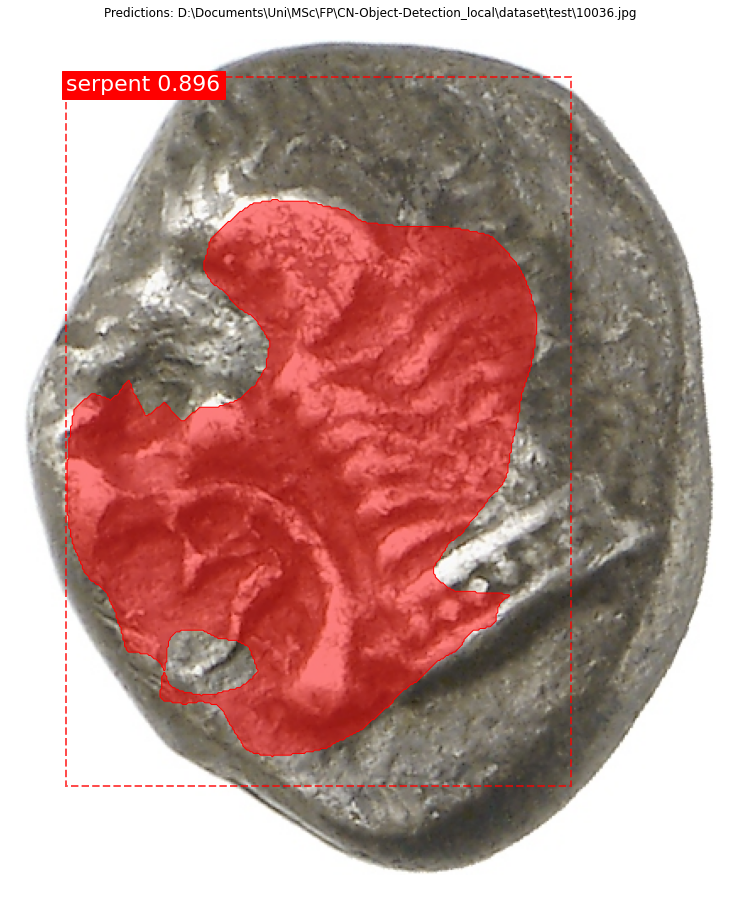

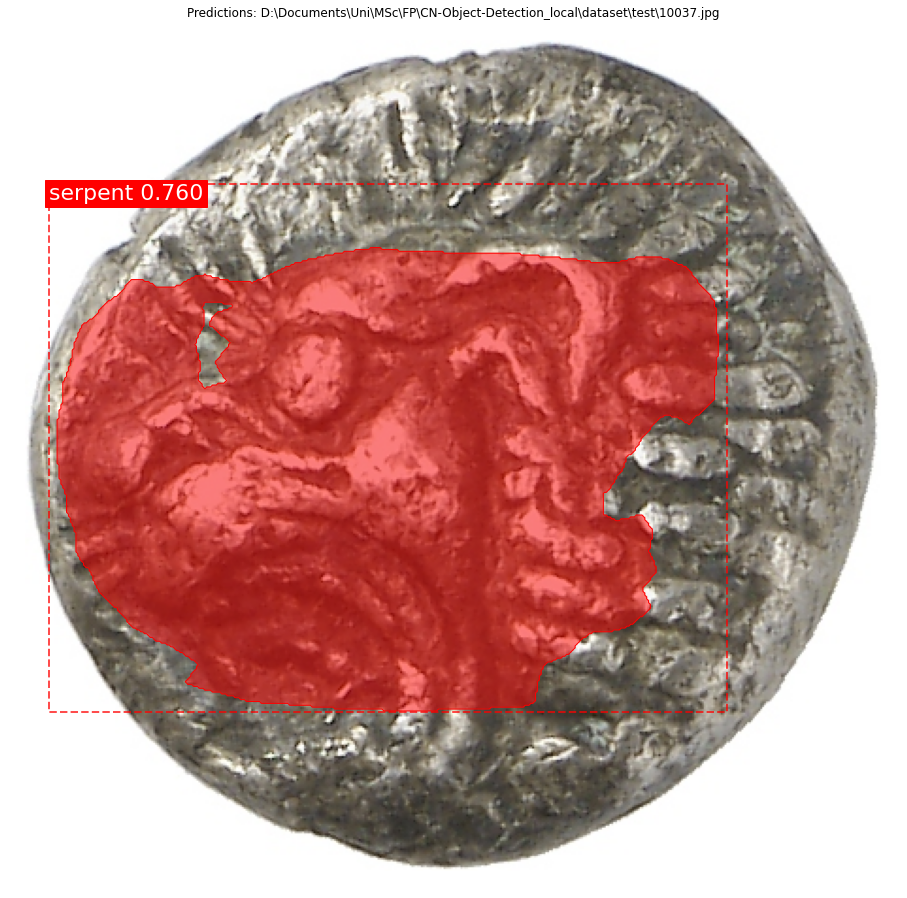

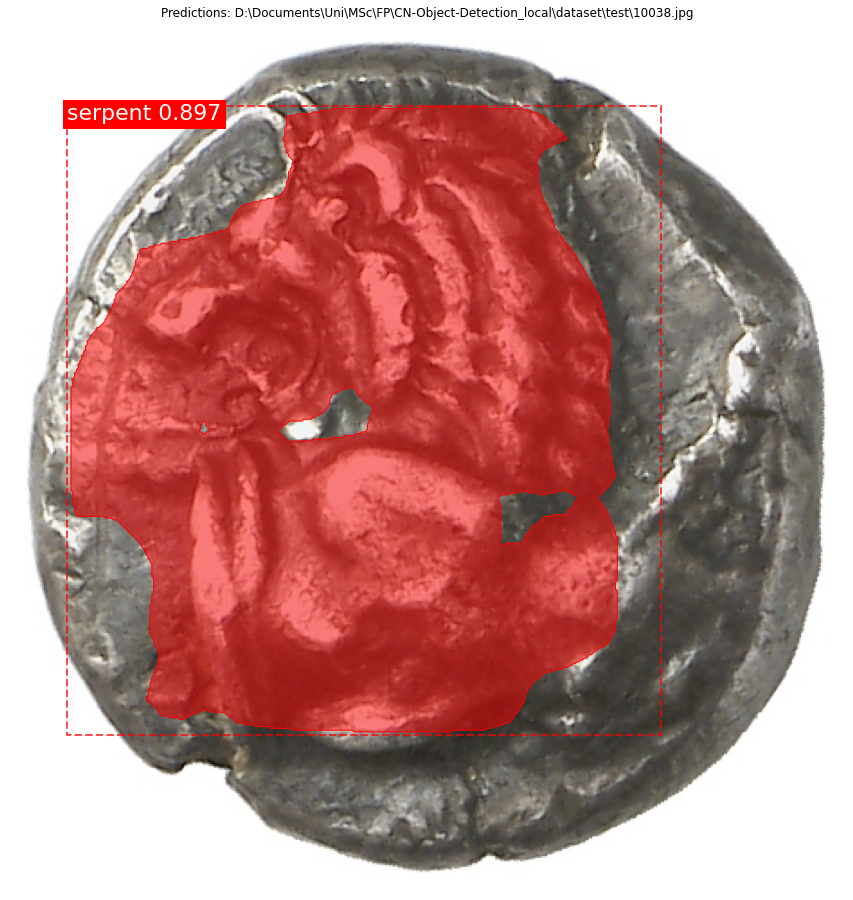

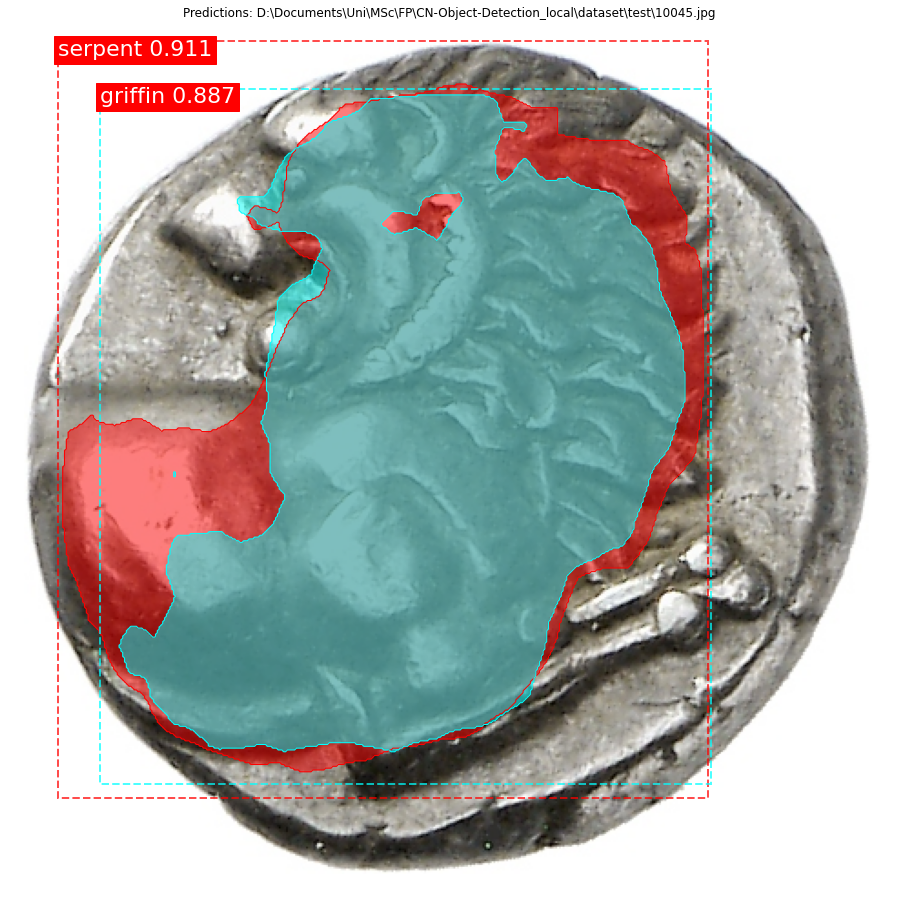

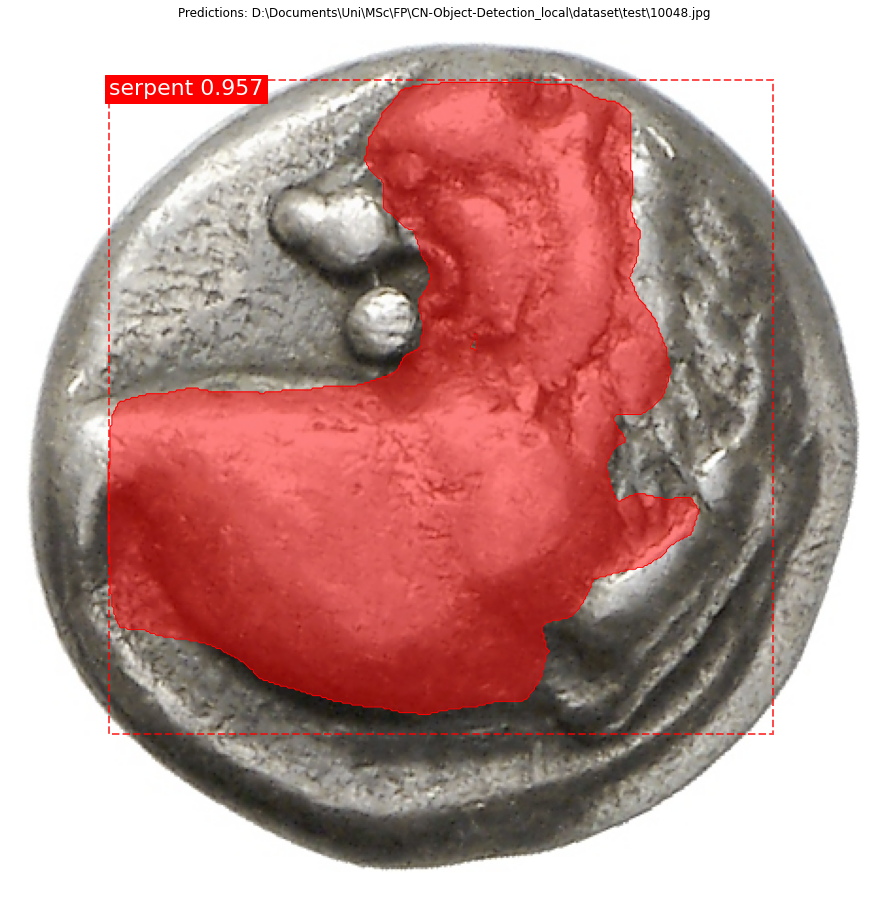

...

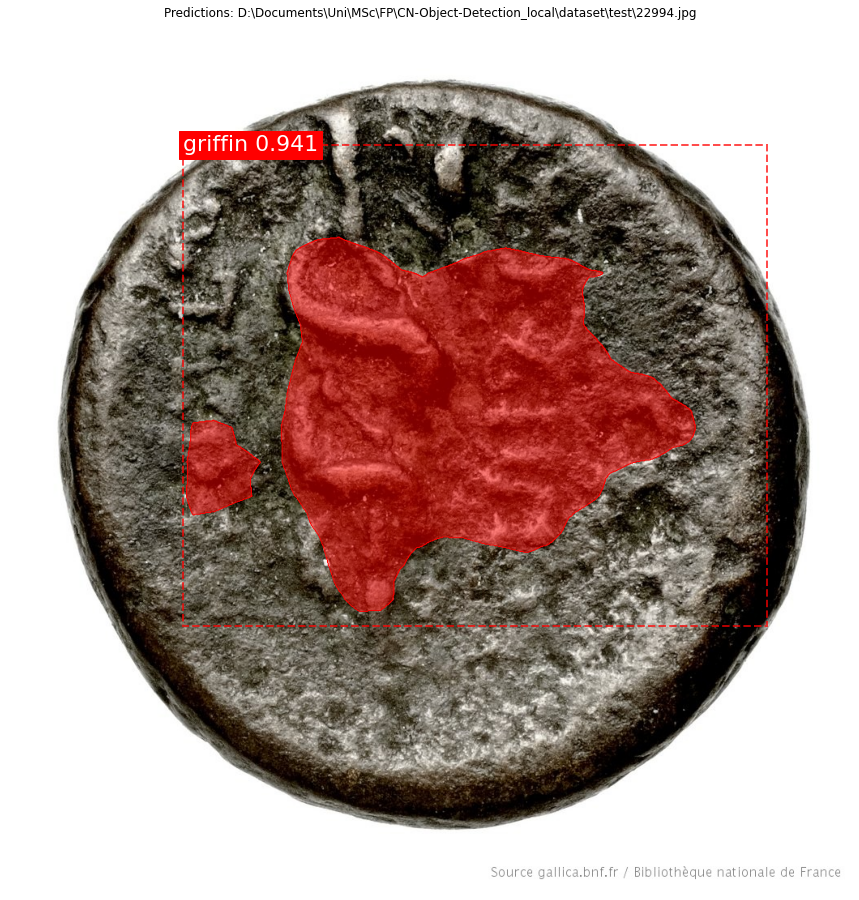

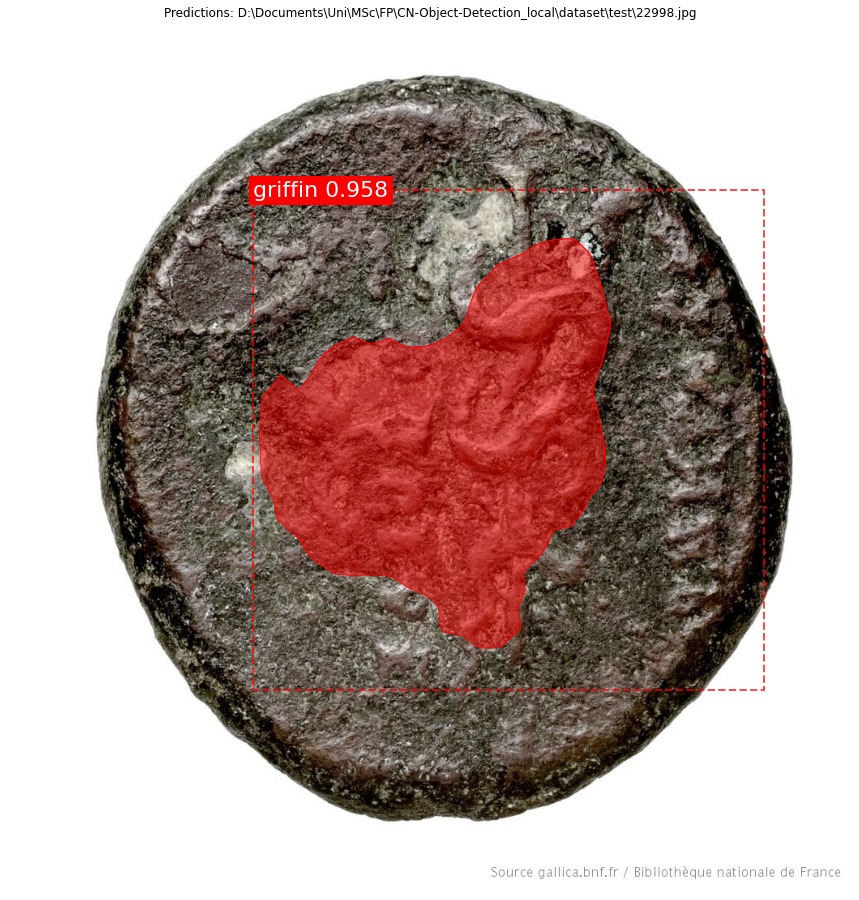

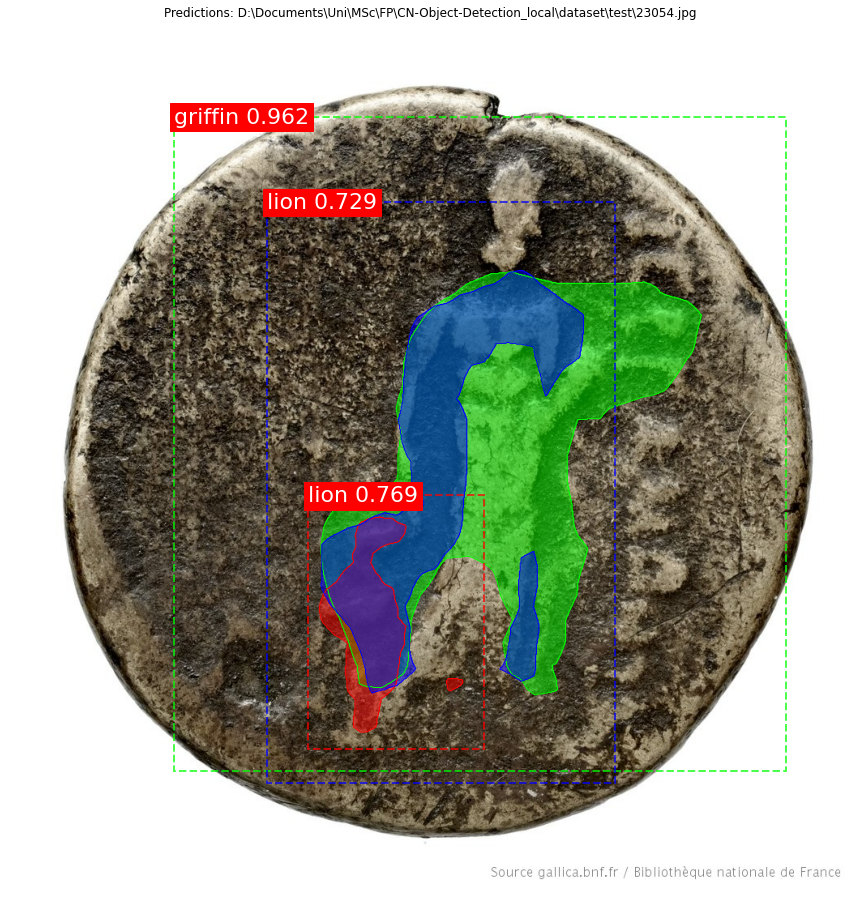

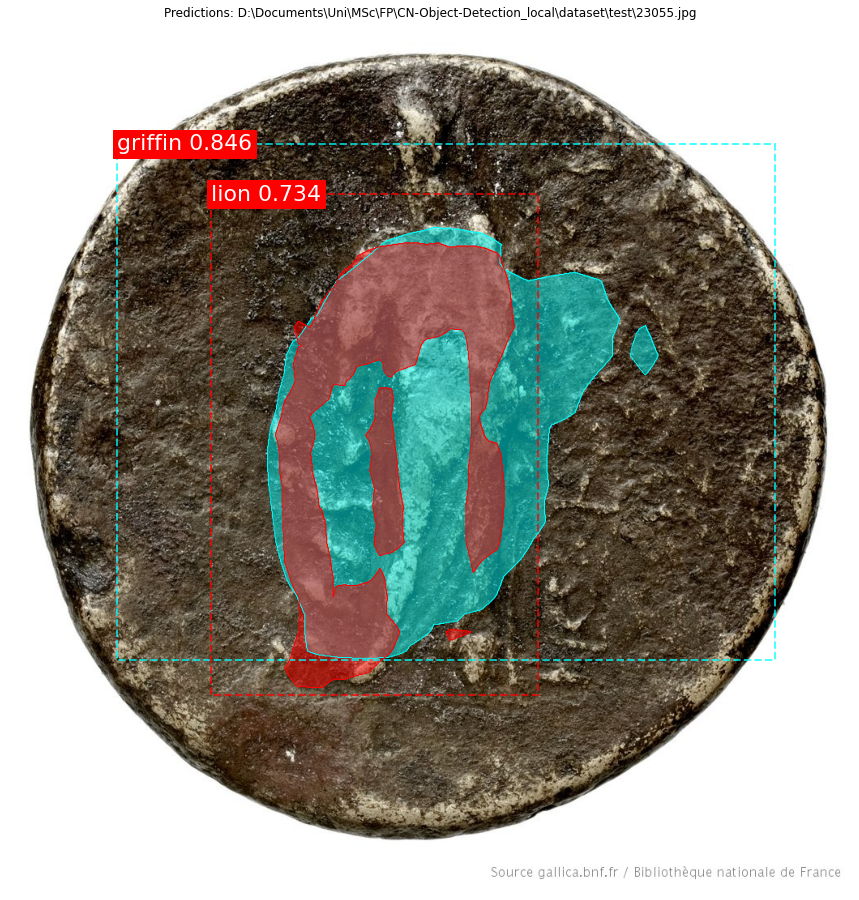

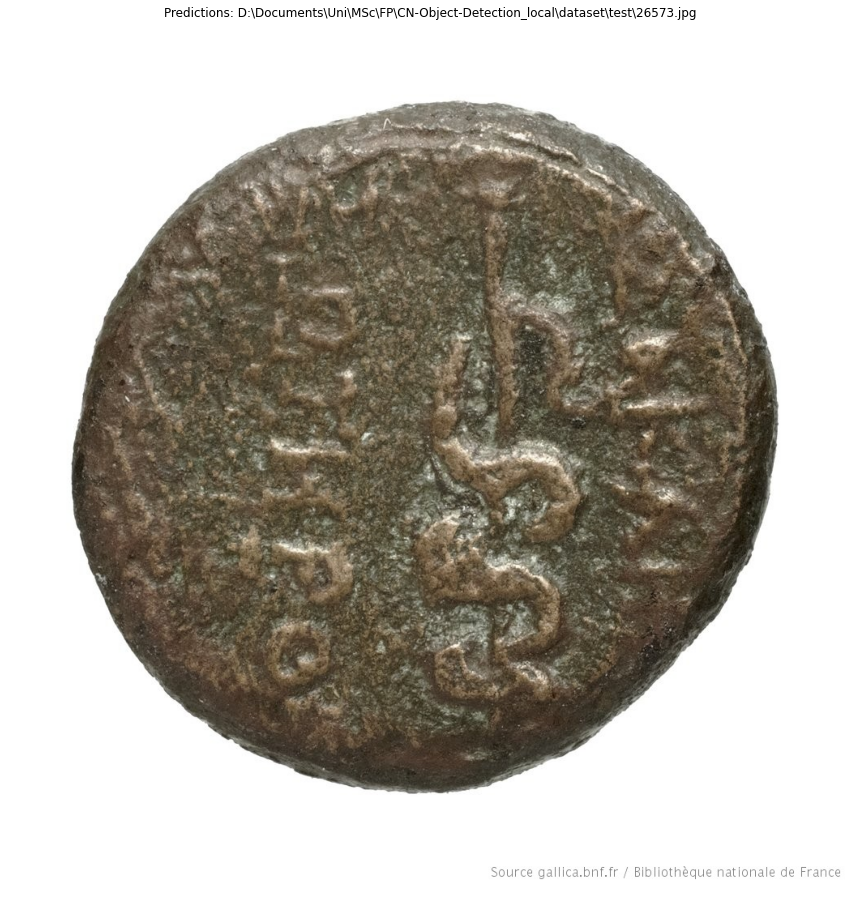

In [34]:
test_directory = DATA_DIR + '\\test\\'

for file in os.listdir(test_directory):
    if file.endswith('.jpg'):
        print(test_directory + file)
        image = mpimg.imread(test_directory + file)
        print(len([image]))
        results = model.detect([image], verbose=1)

        # Display results
        ax = get_ax(1)
        r1 = results[0]
        visualize.display_instances(image, r1['rois'], r1['masks'], r1['class_ids'],
                                    dataset.class_names, r1['scores'], ax=ax,
                                    title="Predictions: " + test_directory + file)

# #RUN DETECTION
# image_name = "5095"
# image_path = DATA_DIR + '\\val\\' + image_name + ".jpg"
# image = mpimg.imread(image_path)

# # Run object detection
# print(len([image]))
# results = model.detect([image], verbose=1)

# # Display results
# ax = get_ax(1)
# r1 = results[0]
# visualize.display_instances(image, r1['rois'], r1['masks'], r1['class_ids'],
#                             dataset.class_names, r1['scores'], ax=ax,
#                             title="Predictions: "+image_path)

38
image ID: object.36 (38) D:\Documents\Uni\MSc\FP\CN-Object-Detection_local\dataset\val\28160.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  152.00000  max:  849.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  uint8


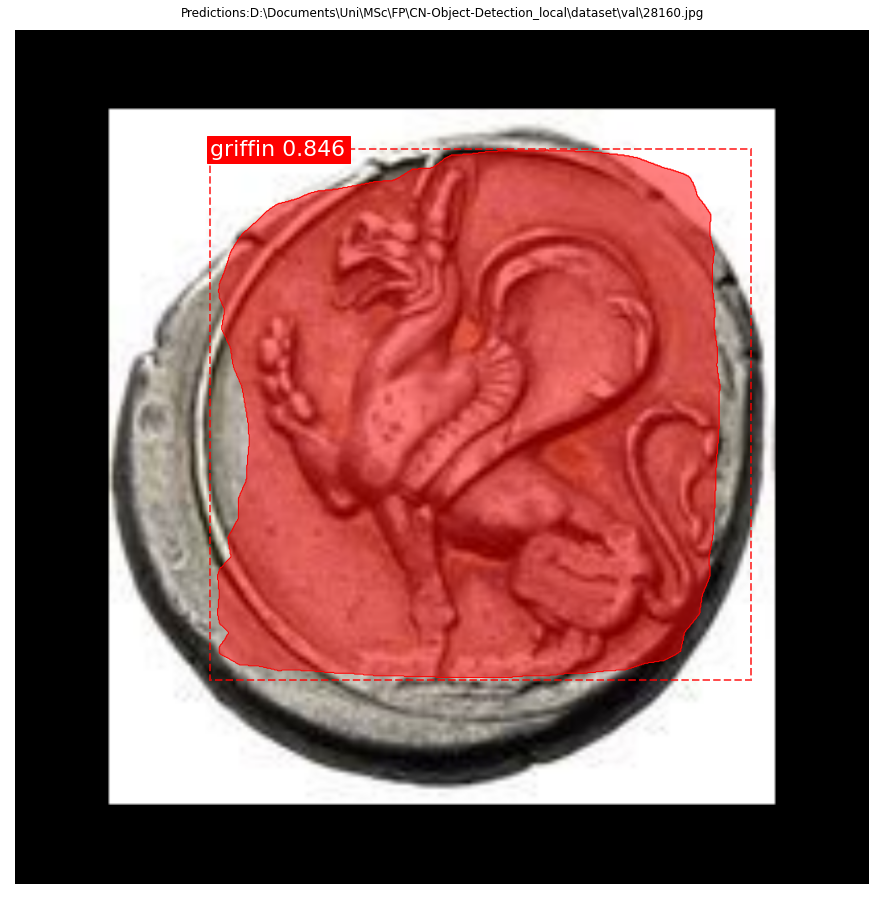

In [37]:
# RUN DETECTION RANDOM

image_id = random.choice(dataset.image_ids)
print(image_id)
image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(dataset, config, image_id, use_mini_mask=False)
info = dataset.image_info[image_id]
print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                       dataset.image_reference(image_id)))

# Run object detection
results = model.detect([image], verbose=1)

# Display results
ax = get_ax(1)
r = results[0]
visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                            dataset.class_names, r['scores'], ax=ax,
                            title="Predictions:"+info["path"])

log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)

# Average Mean Precision

In [38]:
from mrcnn import utils_2


total_gt = np.array([]) 
total_pred = np.array([]) 
mAP_ = [] #mAP list

#compute total_gt, total_pred and mAP for each image in the test dataset
# Compute total ground truth boxes(total_gt) and total predicted boxes(total_pred) and mean average precision for each Image 
#in the test dataset
for image_id in dataset.image_ids:
    image, image_meta, gt_class_id, gt_bbox, gt_mask =modellib.load_image_gt(dataset, config, image_id)#, #use_mini_mask=False)
    info = dataset.image_info[image_id]

    # Run the model
    results = model.detect([image], verbose=1)
    r = results[0]
    
    #compute gt_tot and pred_tot
    gt, pred = utils_2.gt_pred_lists(gt_class_id, gt_bbox, r['class_ids'], r['rois'])
    total_gt = np.append(total_gt, gt)
    total_pred = np.append(total_pred, pred)
    
    #precision_, recall_, AP_ 
    AP_, precision_, recall_, overlap_ = utils_2.compute_ap(gt_bbox, gt_class_id, gt_mask,
                                          r['rois'], r['class_ids'], r['scores'], r['masks'])
    #check if the vectors len are equal
    print("the actual length of the ground truth vect is : ", len(total_gt))
    print("the actual length of the predicted vect is : ", len(total_pred))
    
    mAP_.append(AP_)
    print("Average precision of this image : ",AP_)
    print("The actual mean average precision for the whole images", sum(mAP_)/len(mAP_))

import pandas as pd
total_gt=total_gt.astype(int)
total_pred=total_pred.astype(int)
#save the vectors of gt and pred
save_dir = "output"
gt_pred_tot_json = {"Total Groundtruth" : total_gt, "predicted box" : total_pred}
df = pd.DataFrame(gt_pred_tot_json)
if not os.path.exists(save_dir):
    os.makedirs(save_dir)
df.to_json(os.path.join(save_dir,"gt_pred_test.json"))

Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
the actual length of the ground truth vect is :  2
the actual length of the predicted vect is :  2
Average precision of this image :  0.0
The actual mean average precision for the whole images 0.0
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
the

the actual length of the ground truth vect is :  20
the actual length of the predicted vect is :  20
Average precision of this image :  0.0
The actual mean average precision for the whole images 0.42857142857142855
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
the actual length of the ground truth vect is :  21
the actual length of the predicted vect is :  21
Average precision of this image :  1.0
The actual mean average precision for the whole images 0.4666666666666667
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min

the actual length of the ground truth vect is :  44
the actual length of the predicted vect is :  44
Average precision of this image :  0.0
The actual mean average precision for the whole images 0.42857142857142855
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
the actual length of the ground truth vect is :  46
the actual length of the predicted vect is :  46
Average precision of this image :  1.0
The actual mean average precision for the whole images 0.4482758620689655
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min

the actual length of the ground truth vect is :  68
the actual length of the predicted vect is :  68
Average precision of this image :  0.5
The actual mean average precision for the whole images 0.42857142857142855
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
the actual length of the ground truth vect is :  70
the actual length of the predicted vect is :  70
Average precision of this image :  1.0
The actual mean average precision for the whole images 0.4418604651162791
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min

the actual length of the ground truth vect is :  89
the actual length of the predicted vect is :  89
Average precision of this image :  1.0
The actual mean average precision for the whole images 0.39285714285714285
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 16)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
the actual length of the ground truth vect is :  90
the actual length of the predicted vect is :  90
Average precision of this image :  1.0
The actual mean average precision for the whole images 0.40350877192982454
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    mi